In [36]:
import pickle
import os
from traffic_equilibrium.solver import Result as FWResult
from traffic_equilibrium.graph import DiGraph
from shapely.geometry import LineString, MultiLineString
import geopandas as gpd
import pandas as pd
from shapely.geometry import shape, LineString
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from mpl_toolkits.axes_grid1 import make_axes_locatable
import contextily as ctx
import seaborn as sns
import itertools as it
import osmnx as ox
import geopy.distance as geo_distance
import hashlib
import uuid

sns.set_context("paper")
matplotlib.style.use('./figures.mplstyle')
matplotlib.rcParams["savefig.dpi"] = 300
plt.rcParams["font.family"] = "Latin Modern Sans"
PROJECT_ROOT = '..'

In [2]:
def unpickle(fname: str):
    with open(fname, 'rb') as fp:
        return pickle.load(fp)
    
INT_SIZE = 64
BYTE_ORDER = "little"

def to_path_uuid(link_ids):
    m = hashlib.md5()
    for link_id in sorted(link_ids):
        m.update(link_id.to_bytes(INT_SIZE, BYTE_ORDER))
    return str(uuid.UUID(m.hexdigest()))
    
class FleetData:
    def __init__(self, data, prefix):
        self.data = data
        self.prefix = prefix
        
    def key(self, k):
        return '_'.join([self.prefix, k])
    
    @property
    def path_flow(self):
        return self.data[self.key('flow')]
    
    @property
    def number_of_paths(self):
        return len(self.path_flow)
    
    @property
    def link_flow(self):
        return self.link_path_incidence @ self.path_flow
    
    @property
    def usable_path_mask(self):
        return self.data[self.key('paths')]

    @property
    def usable_paths(self):
        return pd.Series(
            self.usable_path_mask,
            name=f"is_{self.prefix}_usable_path"
        )
    
    @property
    def trip_path_incidence(self):
        return self.data['trip_path']
    
    @property
    def link_path_incidence(self):
        return self.data['link_path']
    
    @property
    def trip_flow(self):
        return self.trip_path_incidence @ self.path_flow
    
    @property
    def link_path_index(self):
        lpm_coo = self.link_path_incidence.tocoo()
        return pd.DataFrame({
            'link_id': lpm_coo.row,
            'path_id': lpm_coo.col,
        }).set_index('path_id').sort_index()
    
    @property
    def trip_path_index(self):
        tpm_coo = self.trip_path_incidence.tocoo()
        return pd.DataFrame({
            'trip_id': tpm_coo.row,
            'path_id': tpm_coo.col,
        }).set_index('path_id').sort_index()
    
    @property
    def path_uuids(self):
        return self.link_path_index.groupby("path_id").link_id.apply(to_path_uuid).rename("path_uuid")
    
    def trip_path_flow(self, trip_id):
        return (
            self.trip_path_incidence[trip_id]
                .multiply(self.path_flow)
        ) 
    
    def trip_link_flow(self, trip_id):
        return (
            self.link_path_incidence
            @ self.trip_path_flow(trip_id).T
        ).toarray().squeeze()
    
    def to_path_dataframe(self):
        return (
            pd.DataFrame({
                self.prefix: self.path_flow,
                'path_id': np.arange(self.number_of_paths),
            }).set_index('path_id')
              .join(self.trip_path_index)
              .join(self.usable_paths)
              .join(self.path_uuids)
              .set_index(['path_uuid', 'trip_id'])
        )
    
    def to_link_dataframe(self):
        return pd.DataFrame({
            self.prefix: self.link_flow,
            "link_id": np.arange(len(self.link_flow))
        }).set_index('link_id')


class CriticalFleetSizeResult:
    def __init__(self, data, node_geom = None):
        self.data = data
        self.node_geom = node_geom
        self.fleet = FleetData(self.data, "fleet")
        self.user = FleetData(self.data, "user")
        self.solver_result = FWResult.load(os.path.join(PROJECT_ROOT, data['result']))
        
    @property
    def fleet_trip_fraction(self):
        return self.fleet.trip_flow / (self.fleet.trip_flow + self.user.trip_flow)
        
    @property
    def fleet_path_fraction(self):
        return self.fleet.path_flow / (self.fleet.path_flow + self.user.path_flow)
    
    @property
    def fleet_link_fraction(self):
        return self.fleet.link_flow / (self.fleet.link_flow + self.user.link_flow)
    
    @property
    def link_path_incidence(self):
        return self.data['link_path']
    
    @property
    def trip_path_incidence(self):
        return self.data['trip_path']
    
    @property
    def fleet_fraction(self):
        return self.fleet.path_flow.sum() / (self.fleet.path_flow + self.user.path_flow).sum()
    
    @property
    def link_path_index(self):
        lpm_coo = self.link_path_incidence.tocoo()
        return pd.DataFrame({
            'link_id': lpm_coo.row,
            'path_id': lpm_coo.col,
        }).set_index("path_id")
    
    @property
    def trip_path_index(self):
        tpm_coo = self.trip_path_incidence.tocoo()
        return pd.DataFrame({
            'trip_id': tpm_coo.row,
            'path_id': tpm_coo.col,
        }).set_index('path_id').sort_index()
    
    def to_link_cost_dataframe(self):
        return pd.DataFrame({
            "link_cost": self.data["link_cost"],
            "link_marginal_cost": self.data["link_marginal_cost"],
            "link_fleet_marginal_cost": self.data["link_cost"] + np.multiply(self.fleet.link_flow, self.data["link_cost_gradient"]),
            "link_cost_gradient": self.data.get("link_cost_gradient", np.NaN),
            "link_id": np.arange(len(self.data["link_cost"])),
        }).set_index("link_id")
    
    def to_path_cost_dataframe(self):
        _lc = self.to_link_cost_dataframe()
        return (
            self.to_trip_path_link_index()
                .reset_index()
                .set_index("link_id")
                .join(_lc)
                .groupby(["trip_id", "path_uuid"])
                .sum()
                .reset_index("trip_id")
        )
    
    @property
    def path_uuids(self):
        return self.link_path_index.groupby("path_id").link_id.apply(to_path_uuid).rename("path_uuid")
    
    def to_trip_info_dataframe(self):
        trips = pd.DataFrame(
            self.solver_result.problem.demand.to_trip_tuples(),
            columns=['trip_id', 'source_id', 'target_id', 'volume']
        ).set_index('trip_id')
        return trips
        
    
    def to_trip_path_link_index(self):
        return (
            self.trip_path_index
                .join(self.link_path_index)
                .join(self.path_uuids)
                .set_index(["trip_id", "path_uuid"])
        )
    
    def to_path_geodataframe(self):
        link_geom = self.to_link_geodataframe()[['geometry']]
        path_geom = (
            self.link_path_index
                .join(self.path_uuids)
                .set_index('link_id')
                .join(link_geom)
                .set_index('path_uuid')
        )
        return gpd.GeoDataFrame(path_geom).dissolve(by='path_uuid')
    
    def to_path_dataframe(self):
        return (self.to_path_geodataframe()
                    .join(self.fleet.to_path_dataframe())
                    .join(self.user.to_path_dataframe())
                    .join(self.to_path_cost_dataframe())
               )
    
    def to_link_dataframe(self):
        return (self.to_link_geodataframe()
                    .join(self.fleet.to_link_dataframe())
                    .join(self.user.to_link_dataframe())
                    .join(self.to_link_cost_dataframe())
               )
    
    def to_link_geodataframe(self):
        net = self.solver_result.problem.network
        ldf = (pd.DataFrame
                 .from_dict(net.link_info,
                            orient='index')
              )
        ldf.index = ldf.index.map(int).rename('link_id')
        if "geometry" in ldf.columns:
            ldf['geometry'] = ldf.geometry.apply(shape)
            ldf = gpd.GeoDataFrame(ldf).set_geometry("geometry").set_crs(epsg=6565)
        else:
            ldf["geometry"] = ldf.reset_index().merge(
                self.node_geom[["Node", "geometry"]].rename(columns={"geometry": "from_pt"}),
                left_on="from_node",
                right_on="Node",
            ).merge(
                self.node_geom[["Node", "geometry"]].rename(columns={"geometry": "to_pt"}),
                left_on="to_node",
                right_on="Node",
            ).set_index("link_id").apply(lambda row: LineString([row.from_pt, row.to_pt]), axis=1)
            ldf = gpd.GeoDataFrame(ldf).set_geometry("geometry").set_crs(self.node_geom.crs)
        link_nodes = pd.DataFrame(net.links(), columns=['from_node_id', 'to_node_id'])
        link_nodes.index.name = 'link_id'
        return ldf.join(link_nodes)
    
    
    @property
    def link_flow(self):
        return self.fleet.link_flow + self.user.link_flow
    

class Result:
    kinds = ('mcr', 'lp', 'mip')
    
    def __init__(self, prefix, node_geom=None):
        for kind in self.kinds:
            try:
                data = CriticalFleetSizeResult(unpickle(f"{prefix}.{kind}.pkl"), node_geom)
            except FileNotFoundError:
                data = None
            setattr(self, kind, data)
            
    def _to_path_dataframe(self):
        value_vars = ['fleet', 'user']
        dfs = []
        new_index = 'solution_concept'
        for kind in self.kinds:
            result = getattr(self, kind)
            if result is not None:
                df = result.to_path_dataframe()
                df['aggregate_flow'] = df[value_vars].sum(axis=1)
                df[new_index] = kind
                df.set_index(new_index, append=True, inplace=True)
                dfs.append(df)
        df = pd.concat(dfs)
        id_vars = list(set(df.columns) - set(value_vars))
        df = (df.melt(ignore_index=False,
                      id_vars=id_vars, value_vars=value_vars,
                      var_name='flow_class', value_name='flow')
                .set_index('flow_class', append=True)
                .sort_index()
             )
        return df
        
    def to_path_dataframe(self):
        return self._to_path_dataframe().join(self.path_impact())
    
    def to_link_dataframe(self):
        value_vars = ['fleet', 'user']
        dfs = []
        new_index = 'solution_concept'
        for kind in self.kinds:
            result = getattr(self, kind)
            if result is not None:
                df = result.to_link_dataframe()
                df['aggregate_flow'] = df[value_vars].sum(axis=1)
                df[new_index] = kind
                df.set_index(new_index, append=True, inplace=True)
                dfs.append(df)
        df = pd.concat(dfs)
        id_vars = list(set(df.columns) - set(value_vars))
        df = (df.melt(ignore_index=False,
                      id_vars=id_vars,
                      value_vars=value_vars,
                      var_name='flow_class', value_name='flow')
                .set_index('flow_class', append=True)
                .sort_index()
             )
        return df
    
    @property
    def link_path_index(self):
        dfs = []
        for kind in self.kinds:
            result = getattr(self, kind)
            if result is not None:
                dfs.append(result.to_trip_path_link_index())
        return pd.concat(dfs).reset_index().drop_duplicates().set_index(["trip_id", "path_uuid"])

    def path_impact(self):
        is_fleet_usable = self._to_path_dataframe().groupby("path_uuid").is_fleet_usable_path.first()
        n_fleet_usable = is_fleet_usable.sum()
        link_path = self.link_path_index.join(is_fleet_usable).reset_index().set_index(["link_id"])
        link_grad = (self.mcr or self.lp).to_link_cost_dataframe().link_cost_gradient
        def _compute_impact(link_ids):
	        return sum(link_grad.loc[lid] * (n_fleet_usable - link_path.loc[lid].is_fleet_usable_path.sum()) for lid in link_ids)
        path_links = link_path.reset_index().groupby("path_uuid").link_id.apply(set)
        return path_links.apply(_compute_impact).rename("path_impact")


def plot_with_basemap(gdf, *args, buffer=0, shift=0, size=20, extent=None, source=ctx.providers.CartoDB.Positron, copy=True, **kwargs):
    #if extent is not None:
    #    gdf = gdf[gdf.intersects(extent)].copy()
    if copy:
        gdf = gdf.copy()
    if extent is not None:
        xmin, ymin, xmax, ymax = extent.bounds
    else:
        xmin, ymin, xmax, ymax = gdf.unary_union.buffer(buffer).bounds
    aspect = (xmax-xmin) / (ymax-ymin)
    fig, ax = plt.subplots(figsize=(size, aspect*size))
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.1)
    if args:
        cax.set_title(args[0])
    shift_geometry(gdf, shift).plot(*args, ax=ax, cax=cax, **kwargs)
    ax.set(xlim=[xmin, xmax], ylim=[ymin, ymax])
    ctx.add_basemap(ax, crs=gdf.crs, source=source)
    ax.axis('off')
    return ax


def with_flow_stats(link_flow_df):
    link_flow_df["V/C"] = link_flow_df.flow / link_flow_df.capacity
    link_flow_df["Aggregate V/C"] = link_flow_df.aggregate_flow / link_flow_df.capacity
    link_flow_df["link_flow_fraction"] = link_flow_df.flow / link_flow_df.aggregate_flow
    return link_flow_df

def with_path_stats(path_flow_df):
    path_flow_df['is_used'] = (path_flow_df.flow > 0)
    path_flow_df['flow_fraction'] = path_flow_df.flow / path_flow_df.aggregate_flow
    path_flow_df['is_exclusive'] = path_flow_df.flow_fraction >= 0.95
    return path_flow_df

def shift_geometry(link_flow_df, shift):
    if shift:
        link_flow_df['geometry'] = link_flow_df.geometry.apply(LineShifter(shift))
    return link_flow_df


class LineShifter:
    def __init__(self, alpha):
        self.alpha = alpha
        
    def __call__(self, line):
        fn = {
            'LineString': self._line_shift,
            'MultiLineString': self._multi_line_shift
        }.get(line.type)
        if fn is None:
            raise Exception(f"Cannot shift geometry of type {line.type}")
        else:
            return fn(line)
        
    def _multi_line_shift(self, multi_line):
        return MultiLineString([
            self._line_shift(line)
            for line in multi_line
        ])
    
    def _line_shift(self, line):
        coords = iter(line.coords)
        x0, y0 = next(coords)
        shifted_coords = [(x0, y0)]
        for x1, y1 in coords:
            shifted_coords.pop()
            shifted_coords.extend(shift_line_segment_coords(
                x0, y0, x1, y1, self.alpha
            ))
            x0, y0 = x1, y1
        return LineString(shifted_coords)

def safe_div(a, b):
    if b == 0:
        return 0.0
    else:
        return a / b

def shift_line_segment_coords(x0, y0, x1, y1, alpha):
    dx = (x1 - x0)
    dy = (y1 - y0)
    z = (dx**2 + dy**2)**0.5
    return [
        (x0 - alpha * safe_div(dy, z), y0 + alpha * safe_div(dx, z)),
        (x1 - alpha * safe_div(dy, z), y1 + alpha * safe_div(dx, z))
    ]

def zoom_to(ax, center_pt=None, level=1):
    xmin, xmax = ax.get_xlim()
    dx = (xmax - xmin) / level
    ymin, ymax = ax.get_ylim()
    dy = (ymax - ymin) / level
    if center_pt is None:
        x, y = (xmax-xmin)/2.0, (ymax-ymin)/2.0
    else:
        x, y = center_pt
        assert xmin <= x <= xmax
        assert ymin <= y <= ymax
    ax.set_xlim([x - dx, x + dx])
    ax.set_ylim([y - dy, y + dy])
    return ax

def add_demand_level_index(df, demand_level):
    df["demand_level"] = demand_level
    return df.set_index("demand_level", append=True)

def place_to_extent(place, crs, buffer_dist=0):
    return ox.geocode_to_gdf(place, buffer_dist=buffer_dist).to_crs(crs).unary_union

def select(df, **kwargs):
    keys, values = zip(*kwargs.items())
    return df.xs(
        values,
        level=keys,
        drop_level=False
    )

def flatten_columns(df):
    df.columns = ['_'.join(filter(None, col)) for col in df.columns.values]
    return df

def map_style():
    return matplotlib.style.context("./maps.mplstyle")

def set_linestyles(g, linestyles):
    axes = list(g.axes_dict.values())or [g.ax]
    for ax in axes:
        legend = ax.legend_ or g.legend
        handles = [None]*len(linestyles) if legend is None else legend.legendHandles
        for lines, linestyle, legend_handle in zip(ax.lines[::-1], linestyles, handles):
            lines.set_linestyle(linestyle)
            if legend_handle is not None:
                legend_handle.set_linestyle(linestyle)

# Braess

In [3]:
braess_nodes = pd.DataFrame(dict(
    Node=[0, 1, 2, 3],
    x=[0, 1, 1, 2],
    y=[0, 1, -1, 0],
))
braess_nodes = sf_nodes = gpd.GeoDataFrame(
    braess_nodes,
    geometry=gpd.points_from_xy(braess_nodes.x, braess_nodes.y),
    crs=4326
)

In [4]:
res = Result("../braess-cfs-ue", braess_nodes)
braess_link_info = {
    "0": {"from_node": 0, "to_node": 1},
    "1": {"from_node": 0, "to_node": 2},
    "2": {"from_node": 1, "to_node": 2},
    "3": {"from_node": 1, "to_node": 3},
    "4": {"from_node": 2, "to_node": 3},
}
res.lp.solver_result.problem.network.link_info.update(braess_link_info)
#res.mcr.solver_result.problem.network.link_info.update(braess_link_info)
res.mip.solver_result.problem.network.link_info.update(braess_link_info)

In [5]:
braess_path_uuids = dict(
    upper="ff6aee98-f766-3966-8ff8-346b409739c3",
    lower="f3f7979d-e45d-6beb-71da-4b2a68382cad",
    middle="c001ae6c-71e6-3a95-4491-3526a91dc8c4",
)
braess_path_names = {v:k for k, v in braess_path_uuids.items()}

In [6]:
braess_paths = res.to_path_dataframe().rename(index=braess_path_names, level="path_uuid").drop(columns="trip_id")

In [7]:
braess_paths.groupby(["path_uuid", "solution_concept", "flow_class"]).flow.sum()

path_uuid  solution_concept  flow_class
lower      lp                fleet         1.022214e-03
                             user          1.998978e+00
           mip               fleet         2.000000e+00
                             user          0.000000e+00
middle     lp                fleet         2.007897e-08
                             user          2.000000e+00
           mip               fleet         0.000000e+00
                             user          2.000000e+00
upper      lp                fleet         1.022160e-03
                             user          1.998978e+00
           mip               fleet         2.000000e+00
                             user          0.000000e+00
Name: flow, dtype: float64

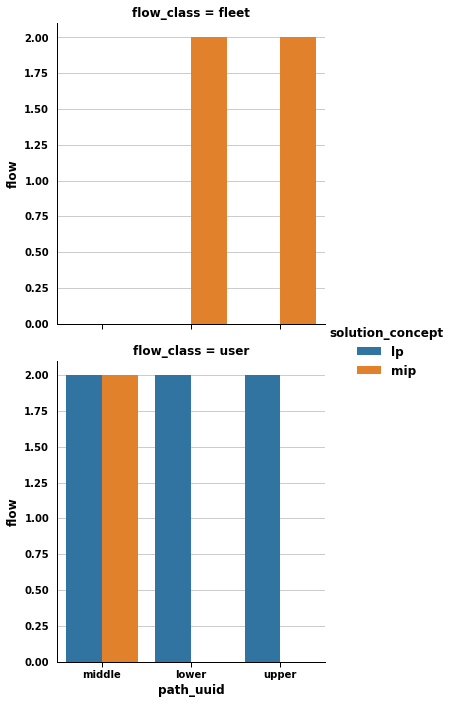

In [8]:
sns.catplot(
    data=braess_paths.reset_index(),
    x="path_uuid",
    y="flow",
    hue="solution_concept",
    row="flow_class",
    kind="bar"
)

In [9]:
sf_res = Result(f"../sioux-falls-scale-1.0", sf_nodes)
sf_res.lp.solver_result.problem.network.link_info

{'0': {'from_node': 1,
  'to_node': 2,
  'capacity': 25900.20064,
  'length': 6.0,
  'free_flow_time': 6.0,
  'b': 0.15,
  'power': 4.0,
  'speed_limit': 0.0,
  'toll': 0.0,
  'link_type': 1},
 '1': {'from_node': 1,
  'to_node': 3,
  'capacity': 23403.47319,
  'length': 4.0,
  'free_flow_time': 4.0,
  'b': 0.15,
  'power': 4.0,
  'speed_limit': 0.0,
  'toll': 0.0,
  'link_type': 1},
 '2': {'from_node': 2,
  'to_node': 1,
  'capacity': 25900.20064,
  'length': 6.0,
  'free_flow_time': 6.0,
  'b': 0.15,
  'power': 4.0,
  'speed_limit': 0.0,
  'toll': 0.0,
  'link_type': 1},
 '3': {'from_node': 2,
  'to_node': 6,
  'capacity': 4958.180928,
  'length': 5.0,
  'free_flow_time': 5.0,
  'b': 0.15,
  'power': 4.0,
  'speed_limit': 0.0,
  'toll': 0.0,
  'link_type': 1},
 '4': {'from_node': 3,
  'to_node': 1,
  'capacity': 23403.47319,
  'length': 4.0,
  'free_flow_time': 4.0,
  'b': 0.15,
  'power': 4.0,
  'speed_limit': 0.0,
  'toll': 0.0,
  'link_type': 1},
 '5': {'from_node': 3,
  'to_node':

# Sioux Falls Sensitivity

In [10]:
sf_nodes = pd.read_csv(
    "../test/fixtures/TransportationNetworks/SiouxFalls/SiouxFalls_node.tntp",
    sep="\t",
    usecols=["Node", "X", "Y"]
)
sf_nodes = gpd.GeoDataFrame(
    sf_nodes,
    geometry=gpd.points_from_xy(sf_nodes.X, sf_nodes.Y),
    crs=4326,
)

In [11]:
link_dfs = []
path_dfs = []
trip_info_dfs = []
trip_path_link_dfs = []
demand_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2.0]
for demand_level in demand_levels:
    print(f"demand level: {100*demand_level}%")
    res = Result(f"../sioux-falls-scale-{demand_level}", sf_nodes)
    #link_dfs.append(add_demand_level_index(res.to_link_dataframe(), demand_level))
    path_dfs.append(add_demand_level_index(res.to_path_dataframe(), demand_level))
    #trip_info_dfs.append(add_demand_level_index(res.mcr.to_trip_info_dataframe(), demand_level))
    #trip_path_link_dfs.append(res.link_path_index)
#sf_link_flow_s = with_flow_stats(pd.concat(link_dfs))
sf_path_flow_s = with_path_stats(pd.concat(path_dfs))
#sf_trip_info_s = pd.concat(trip_info_dfs)
#sf_trip_path_link_idx_s = pd.concat(trip_path_link_dfs)

demand level: 10.0%
demand level: 20.0%
demand level: 30.0%
demand level: 40.0%
demand level: 50.0%
demand level: 60.0%
demand level: 70.0%
demand level: 80.0%
demand level: 90.0%
demand level: 100.0%
demand level: 110.00000000000001%
demand level: 120.0%
demand level: 130.0%
demand level: 140.0%
demand level: 150.0%
demand level: 160.0%
demand level: 170.0%
demand level: 180.0%
demand level: 190.0%
demand level: 200.0%


In [12]:
link_dfs = []
path_dfs = []
trip_info_dfs = []
trip_path_link_dfs = []
demand_levels = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 1.1, 1.2, 1.3, 1.4, 1.5, 1.6, 1.7, 1.8, 1.9, 2.0]
for demand_level in demand_levels:
    print(f"demand level: {100*demand_level}%")
    res = Result(f"../sioux-falls-ue-scale-{demand_level}.cfs-ue", sf_nodes)
    #link_dfs.append(add_demand_level_index(res.to_link_dataframe(), demand_level))
    path_dfs.append(add_demand_level_index(res.to_path_dataframe(), demand_level))
    #trip_info_dfs.append(add_demand_level_index(res.mcr.to_trip_info_dataframe(), demand_level))
    #trip_path_link_dfs.append(res.link_path_index)
#sf_link_flow_s = with_flow_stats(pd.concat(link_dfs))
sf_path_flow_cfs_ue_s = with_path_stats(pd.concat(path_dfs))
#sf_trip_info_s = pd.concat(trip_info_dfs)

demand level: 10.0%
demand level: 20.0%
demand level: 30.0%
demand level: 40.0%
demand level: 50.0%
demand level: 60.0%
demand level: 70.0%
demand level: 80.0%
demand level: 90.0%
demand level: 100.0%
demand level: 110.00000000000001%
demand level: 120.0%
demand level: 130.0%
demand level: 140.0%
demand level: 150.0%
demand level: 160.0%
demand level: 170.0%
demand level: 180.0%
demand level: 190.0%
demand level: 200.0%


In [13]:
sf_path_flow_cfs_ue_s.index.get_level_values("solution_concept").unique()

Index(['lp', 'mip'], dtype='object', name='solution_concept')

In [14]:
sf_path_flow_s_all = sf_path_flow_s.append(sf_path_flow_cfs_ue_s.rename(index={"lp": "CFS-UE (LP)", "mip": "CFS-UE (MIP)"}, level="solution_concept"))
sf_path_flow_s_all.groupby("solution_concept").size()

solution_concept
CFS-UE (LP)     124680
CFS-UE (MIP)    124680
lp              124126
mcr             124126
mip             124088
dtype: int64

In [15]:
mip_solutions = pd.read_csv("../sioux-falls-cfs-demand-sensitivity-mip.csv",
                            index_col="demand_level",
                            true_values=['t'],
                            false_values=['f'],
                           )
mip_solutions["approx_lb_ratio"] = mip_solutions.best_bound / mip_solutions.best_objective
mip_solutions["mip_additional_time"] = (mip_solutions.duration - mip_solutions.lp_time)/60.0
mip_solutions["gap"] = (mip_solutions.best_objective- mip_solutions.best_bound) / mip_solutions.best_objective
mip_solutions.head()

,best_objective,best_bound,duration,time_limit_reached,lp_time,approx_lb_ratio,mip_additional_time,gap
demand_level,,,,,,,,
0.1,1.768686e-07,1.768686e-07,5.618260,False,6.193269,1.000000,-0.009583,0.000000
0.2,1.888604e+04,1.852624e+04,7.454466,False,3.814949,0.980949,0.060659,0.019051
0.3,4.924137e+04,4.816125e+04,61.507306,False,4.643476,0.978065,0.947731,0.021935
0.4,5.742023e+04,5.413435e+04,7204.180526,True,6.833547,0.942775,119.955783,0.057225
0.5,7.104110e+04,6.573703e+04,7204.763991,True,8.780594,0.925338,119.933057,0.074662


In [16]:
total_volume = sf_path_flow_s_all.groupby(["solution_concept", "demand_level"]).flow.sum().rename("total_volume")
fleet_volume = sf_path_flow_s_all.groupby(["flow_class", "solution_concept", "demand_level"]).flow.sum().loc["fleet"].rename("fleet_volume")

In [17]:
sf_cfs = fleet_volume.to_frame().join(total_volume)
sf_cfs["critical_fleet_size"] = sf_cfs.fleet_volume / sf_cfs.total_volume
delta = mip_solutions.best_objective - sf_cfs.loc["mip"].fleet_volume
eps = mip_solutions.best_objective / sf_cfs.loc["mip"].fleet_volume

mip_lb = pd.concat([
    # cfs / cfs_lb = best_obj / best bound
    (
        mip_solutions.approx_lb_ratio * sf_cfs.loc["mip"].critical_fleet_size
    ).rename("critical_fleet_size").to_frame(),
    # link error at best = link error at lower bound
    (
        (mip_solutions.best_bound - delta) / sf_cfs.loc["mip"].total_volume
    ).rename("critical_fleet_size").to_frame(),
    # link error % at best = link error % at lower bound
    (
        mip_solutions.best_bound / (eps * sf_cfs.loc["mip"].total_volume)
    ).rename("critical_fleet_size").to_frame(),
], keys=["equal_ratio", "equal_error", "mip (lower bound)"], names=["solution_concept"])
#mip_lb = mip_lb.set_index(["solution_concept", "demand_level"])
sf_cfs = pd.concat([sf_cfs, mip_lb])

In [18]:
sf_cfs

fleet_volume  total_volume  \
solution_concept  demand_level                               
CFS-UE (LP)       0.1           33765.975207       36060.0   
                  0.2           52236.787284       72120.0   
                  0.3           63599.072671      108180.0   
                  0.4           53250.223075      144240.0   
                  0.5           74711.433183      180300.0   
...                                      ...           ...   
mip (lower bound) 1.6                    NaN           NaN   
                  1.7                    NaN           NaN   
                  1.8                    NaN           NaN   
                  1.9                    NaN           NaN   
                  2.0                    NaN           NaN   

                                critical_fleet_size  
solution_concept  demand_level                       
CFS-UE (LP)       0.1                      0.936383  
                  0.2                      0.724304  
                  0.3                      0.587900  
                  0.4                      0.369178  
                  0.5                      0.414373  
...                                             ...  
mip (lower bound) 1.6                      0.158053  
                  1.7                      0.127063  
                  1.8                      0.121090  
                  1.9                      0.113061  
                  2.0                      0.112410  

[160 rows x 3 columns]

In [19]:
SOLUTION_CONCEPT_ORDER = ["CFS-UE (MIP)", "CFS-UE (LP)", "lp", "mip", "mip (lower bound)", "mcr"]
SOLUTION_CONCEPT_LABELS = ["CFS-UE (MIP)", "CFS-UE (LP)", "CFS-SO (LP)", "CFS-SO (MIP)", "CFS-SO (MIP, best bound)", "MCR"] 
SOLUTION_CONCEPT_LABELS_MAP = dict(zip(SOLUTION_CONCEPT_ORDER, SOLUTION_CONCEPT_LABELS))

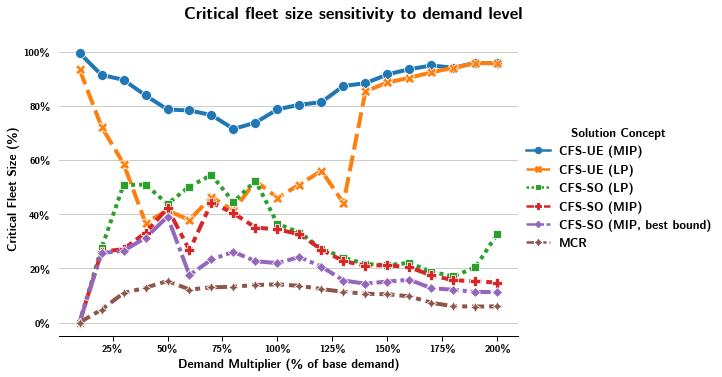

In [37]:
import matplotlib.ticker as ticker
matplotlib.style.use('./figures.mplstyle')
order = ["mcr", "mip", "mip (lower bound)", "lp"]
g = sns.relplot(
    data=sf_cfs.rename(index=SOLUTION_CONCEPT_LABELS_MAP).reset_index(),
    x="demand_level",
    y="critical_fleet_size",
    hue="solution_concept",
    hue_order=SOLUTION_CONCEPT_LABELS,
    style="solution_concept",
    style_order=SOLUTION_CONCEPT_LABELS,
    kind="line",
    markers=True,
    markersize=10,
    #markerfacecolor='none',
    height=5,
    aspect=1.5,
)
g.despine(left=True)
#g.set(ylim=(0, None))
g.set_ylabels("Critical Fleet Size (%)")
g.set_xlabels("Demand Multiplier (% of base demand)")
g.legend.set_title("Solution Concept")
for ax in g.axes.flatten():
    ax.xaxis.set_major_formatter(ticker.PercentFormatter(xmax=1.0))
    ax.yaxis.set_major_formatter(ticker.PercentFormatter(xmax=1.0))
for lh in g.legend.legendHandles: 
    lh.set_linewidth(2.5)
g.fig.suptitle("Critical fleet size sensitivity to demand level", y=1.05, fontweight="bold")
plt.savefig("saved_figures/sioux-falls-cfs-demand-sensitivity.png", bbox_inches="tight")

In [38]:
mip_solutions["mip_improvement"] =  sf_cfs.loc["lp"].critical_fleet_size - sf_cfs.loc["mip"].critical_fleet_size
mip_solutions.time_limit_reached.fillna(True, inplace=True)

In [39]:
mip_solutions.head()

,best_objective,best_bound,duration,time_limit_reached,lp_time,approx_lb_ratio,mip_additional_time,gap,mip_improvement
demand_level,,,,,,,,,
0.1,1.768686e-07,1.768686e-07,5.618260,False,6.193269,1.000000,-0.009583,0.000000,6.267077e-10
0.2,1.888604e+04,1.852624e+04,7.454466,False,3.814949,0.980949,0.060659,0.019051,1.289486e-02
0.3,4.924137e+04,4.816125e+04,61.507306,False,4.643476,0.978065,0.947731,0.021935,2.372787e-01
0.4,5.742023e+04,5.413435e+04,7204.180526,True,6.833547,0.942775,119.955783,0.057225,1.777968e-01
0.5,7.104110e+04,6.573703e+04,7204.763991,True,8.780594,0.925338,119.933057,0.074662,1.553369e-02


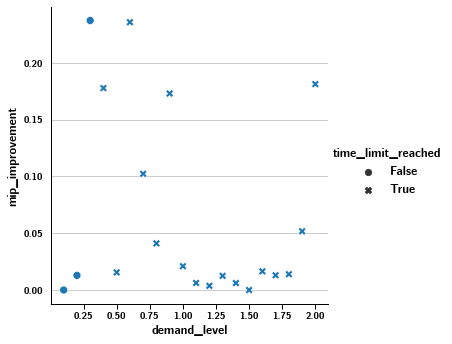

In [40]:
g = sns.relplot(
    data=mip_solutions.reset_index(),
    x="demand_level",
    y="mip_improvement",
    style="time_limit_reached"
)

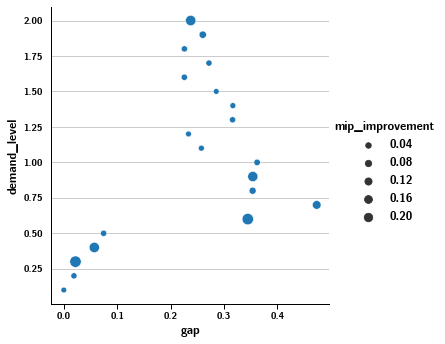

In [41]:
g = sns.relplot(
    data=mip_solutions.reset_index(),
    size="mip_improvement",
    x="gap",
    y="demand_level",
)

In [42]:
mip_solutions.gap.mean()*100

23.470850277813895

In [43]:
mip_solutions.groupby(mip_solutions.mip_improvement <= 0.01).size()

mip_improvement
False    15
True      5
dtype: int64

# Sioux Falls

In [44]:
sf_result = Result("../sioux-falls-scale-1.0-final", sf_nodes)

In [45]:
sf_link_flow = with_flow_stats(sf_result.to_link_dataframe())
sf_path_flow = with_path_stats(sf_result.to_path_dataframe())
sf_trip_path_link_idx = sf_result.link_path_index
sf_trip_info = sf_result.mcr.to_trip_info_dataframe()

In [46]:
sf_trip_info

,source_id,target_id,volume
trip_id,,,
0,0,1,100.0
1,0,2,100.0
2,0,3,500.0
3,0,4,200.0
4,0,5,300.0
...,...,...,...
523,23,18,100.0
524,23,19,400.0
525,23,20,500.0


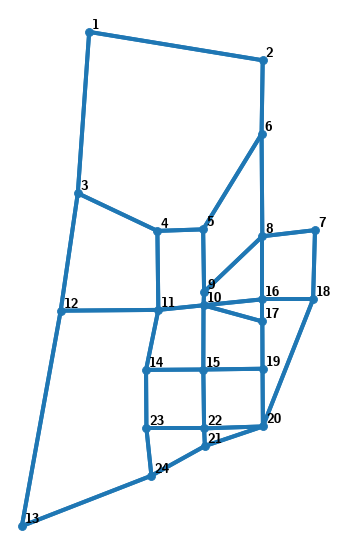

In [47]:
mip_fleet_links = sf_link_flow.xs(("mip", "fleet"), level=("solution_concept", "flow_class"))
with map_style():
	fig, ax = plt.subplots(figsize=(10, 10))
	sf_nodes.plot(ax=ax)
	for x, y, label in zip(sf_nodes.geometry.x, sf_nodes.geometry.y, sf_nodes.Node):
	    ax.annotate(label, xy=(x, y), xytext=(3, 3), textcoords="offset points")
	mip_fleet_links.plot(ax=ax)
	for lid, row in mip_fleet_links.iterrows():
		(x,), (y,) = row.geometry.centroid.xy
		label = f"{lid}: {row.from_node}->{row.to_node}"
		offset = -10 if row.from_node < row.to_node else 10
		#ax.annotate(label, xy=(x, y), xytext=(offset, offset), textcoords="offset points")


In [48]:

def concentration_category(flow_fraction):
	if flow_fraction <= 0.05:
		return "empty"
	if flow_fraction >= 0.95:
		return "full"
	elif 0.5 < flow_fraction < 0.95:
		return "mixed"
	else:
		return "unused"


def with_usability_and_concentration(path_df):
	path_df["is_user_and_fleet_usable"] = path_df.is_user_usable_path & path_df.is_fleet_usable_path
	path_df["concentration"] = path_df.flow_fraction.apply(concentration_category)

In [49]:
with_usability_and_concentration(sf_path_flow)
sf_path_flow["is_exclusive"] = sf_path_flow.concentration == "full"

In [50]:
def to_usability_cat(row):
	return {
		(True, True): "both", 
		(True, False): "fleet_only", 
		(False, True): "user_only",
		(False, False): "none",
	}.get((row.is_fleet_usable_path, row.is_user_usable_path))

In [51]:
mip_fleet_paths = sf_path_flow.xs(("mip", "fleet"), level=("solution_concept", "flow_class")).drop(columns="trip_id")
mip_fleet_paths = mip_fleet_paths.join(
    mip_fleet_paths.groupby("trip_id").link_fleet_marginal_cost.min().rename("min_trip_fleet_marginal_cost")
).join(
    sf_trip_path_link_idx.groupby("path_uuid").size().rename("n_links")
).join(
    mip_fleet_paths.groupby("trip_id").path_impact.min().rename("min_trip_path_impact")
)

In [52]:
mip_fleet_paths["avg_path_impact"] = mip_fleet_paths.path_impact / mip_fleet_paths.n_links
mip_fleet_paths["avg_fleet_marginal_cost"] = mip_fleet_paths.link_fleet_marginal_cost / mip_fleet_paths.n_links
mip_fleet_paths["avg_marginal_cost"] = mip_fleet_paths.link_marginal_cost / mip_fleet_paths.n_links

In [53]:
mip_fleet_paths["usability"] = mip_fleet_paths.apply(to_usability_cat, axis=1)

In [54]:
mip_fleet_paths["trip_relative_fleet_marginal_cost"] = mip_fleet_paths.link_fleet_marginal_cost / mip_fleet_paths.min_trip_fleet_marginal_cost
mip_fleet_paths["trip_relative_path_impact"] = mip_fleet_paths.path_impact / mip_fleet_paths.min_trip_path_impact

In [55]:
from scipy.stats import spearmanr
mip_fleet_paths.groupby("usability").apply(lambda df: spearmanr(df[["trip_relative_path_impact", "trip_relative_fleet_marginal_cost"]].values)[0])

usability
both          0.329985
fleet_only    0.071489
none          0.350356
user_only     0.089591
dtype: float64

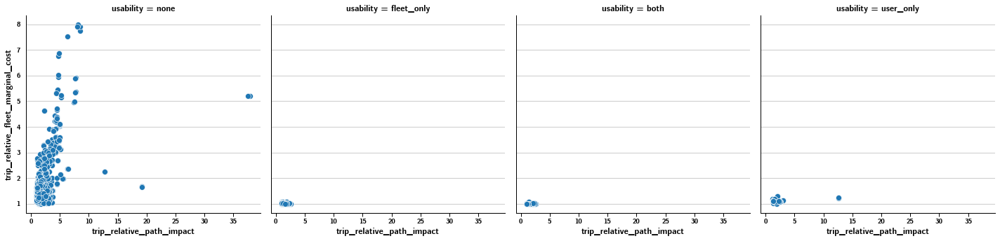

In [56]:
g = sns.relplot(
    data=mip_fleet_paths.reset_index(),
    x="trip_relative_path_impact", 
    y="trip_relative_fleet_marginal_cost",
    col="usability"
)

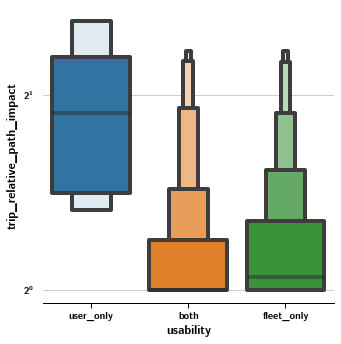

In [57]:
g = sns.catplot( 
	data=mip_fleet_paths.reset_index(), 
	x="usability", 
	y="trip_relative_path_impact",
	kind="boxen", 
    showfliers=False, 
	order=["user_only", "both", "fleet_only"], #"empty", "full", "unused"]
)
plt.yscale('log', base=2)
g.despine(left=True)

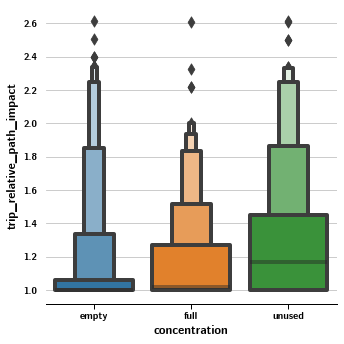

In [58]:
g = sns.catplot( 
	data=mip_fleet_paths[mip_fleet_paths.is_fleet_usable_path].reset_index(), 
	x="concentration", 
	y="trip_relative_path_impact",
	kind="boxen", 
	order=["empty", "full", "unused"]
)
g.despine(left=True)

In [59]:
mip_fleet_paths = mip_fleet_paths.join(mip_fleet_paths.groupby("trip_id").path_impact.mean().rename("trip_avg_path_impact"))
mip_fleet_paths["trip_relative_path_impact"] = (mip_fleet_paths.path_impact - mip_fleet_paths.trip_avg_path_impact) / mip_fleet_paths.trip_avg_path_impact

In [60]:
mip_fleet_trips = mip_fleet_paths.groupby("trip_id")[["flow", "aggregate_flow"]].sum().sort_values(by="flow", ascending=False)
mip_fleet_trips["user_flow"] = mip_fleet_trips.aggregate_flow - mip_fleet_trips.flow

In [61]:
n=5
top_n_fleet_trips = mip_fleet_trips.sort_values(by="flow", ascending=False).head(n).index.values
top_n_user_trips = mip_fleet_trips.sort_values(by="user_flow", ascending=False).head(n).index.values
bot_n_fleet_trips =  mip_fleet_trips.sort_values(by="flow").head(n).index.values
bot_n_user_trips = mip_fleet_trips.sort_values(by="user_flow").head(n).index.values

In [62]:
mip_fleet_paths_ = mip_fleet_paths.reorder_levels(["trip_id", "path_uuid"]).sort_index()
mip_fleet_paths_["top trip"] = "none"
mip_fleet_paths_.loc[top_n_fleet_trips, "top trip"] = "fleet"
mip_fleet_paths_.loc[top_n_user_trips, "top trip"] = "user"

mip_fleet_paths_["bottom trip"] = "none"
mip_fleet_paths_.loc[bot_n_fleet_trips, "bottom trip"] = "fleet"
mip_fleet_paths_.loc[bot_n_user_trips, "bottom trip"] = "user"

In [63]:
mip_fleet_trips.sort_values(by="flow", ascending=False)

,flow,aggregate_flow,user_flow
trip_id,,,
210,2717.706540,4400.0,1682.293460
214,2499.980289,2500.0,0.019711
429,2466.305036,2500.0,33.694964
343,2211.599065,4400.0,2188.400935
206,1994.853301,2000.0,5.146699
...,...,...,...
68,0.000000,1200.0,1200.000000
473,0.000000,2600.0,2600.000000
61,0.000000,200.0,200.000000


In [64]:
mip_fleet_trips.sort_values(by="user_flow", ascending=False)

,flow,aggregate_flow,user_flow
trip_id,,,
205,0.000000e+00,4000.0,4.000000e+03
320,1.975413e-07,4000.0,4.000000e+03
209,1.594935e-06,4000.0,4.000000e+03
366,0.000000e+00,3900.0,3.900000e+03
228,0.000000e+00,3900.0,3.900000e+03
...,...,...,...
26,1.000000e+02,100.0,3.178710e-08
358,2.000000e+02,200.0,3.133314e-08
312,1.000000e+02,100.0,2.832107e-08


In [69]:
mip_top_trips = mip_fleet_paths_.dissolve(by="top trip")
mip_bot_trips = mip_fleet_paths_.dissolve(by="bottom trip")
tab10_colors = plt.cm.tab10.colors

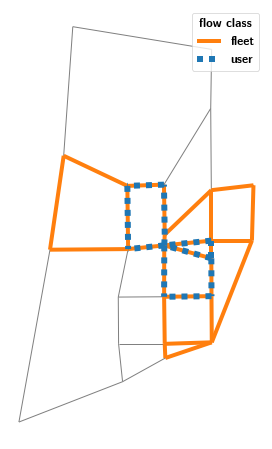

In [70]:
with map_style():
    ax = mip_top_trips.loc[["none"]].plot(color="gray", linewidth=1)
    mip_top_trips.loc[["fleet"]].plot(ax=ax, color=tab10_colors[1], label="fleet")
    mip_top_trips.loc[["user"]].plot(ax=ax, color=tab10_colors[0], linestyle=(0, (1, 1)), linewidth=6, label="user")
    ax.legend(title="flow class")

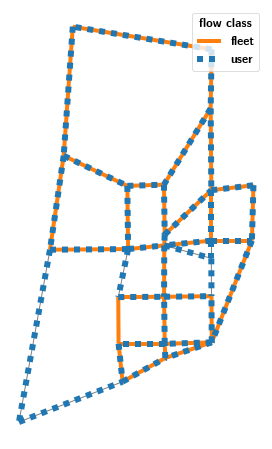

In [71]:
with map_style():
    ax = mip_bot_trips.loc[["none"]].plot(color="gray", linewidth=1)
    mip_bot_trips.loc[["fleet"]].plot(ax=ax, color=tab10_colors[1], label="fleet")
    mip_bot_trips.loc[["user"]].plot(ax=ax, color=tab10_colors[0], linestyle=(0, (1, 1)), linewidth=6, label="user")
    ax.legend(title="flow class")

In [72]:
from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show
from scipy.stats import spearmanr
from sklearn.ensemble import GradientBoostingClassifier, RandomForestClassifier
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer

features = [
    "trip_relative_path_impact", "usability", #"is_user_usable_path",
   	#"link_cost", "link_marginal_cost", 
    #"volume",
]
interactions=[
		#[features.index("path_impact"), features.index("link_cost")], 
		#[features.index("path_impact"), features.index("is_user_usable_path")],
		#[features.index("path_impact"), features.index("link_marginal_cost")],
		#[features.index("path_impact"), features.index("link_cost_gradient")],
]
ebm = ExplainableBoostingClassifier(
	max_bins=12,
	max_interaction_bins=4,
	min_samples_leaf=6, 
    max_leaves=3, 
    outer_bags=12,
    learning_rate=1e-2,
    interactions=1)
gbc = Pipeline(steps=[ 
    ("preprocess", ColumnTransformer(
        remainder="passthrough",
        transformers=[ 
            ("onehotencoder", OneHotEncoder(), ["usability"]),
        ]
    )),
    ("classifier", RandomForestClassifier(
        min_samples_leaf=6,
        n_estimators=500,
        max_depth=3,
    ))
    ])
#data = mip_fleet_paths.join(sf_trip_info.volume)
data_no_users = mip_fleet_paths[mip_fleet_paths.is_fleet_usable_path & ~mip_fleet_paths.is_user_usable_path]
data_users = mip_fleet_paths[mip_fleet_paths.is_fleet_usable_path & mip_fleet_paths.is_user_usable_path]
data_fleet = mip_fleet_paths[mip_fleet_paths.is_fleet_usable_path]
data = data_fleet
y = (data.flow_fraction >= 0.95).astype(int)
X = data[features]

def transform_target(y):
	return np.log((y + 1e-6) / (1-y + 1e-6)).values

def inverse_transform(y_transform):
	return 1.0 / (1.0 + np.exp(-y_transform))

def rank_correlation(estimator, X, y):
	y_hat = estimator.predict(X)
	return spearmanr(y_hat, y)[0]

ebm.fit(X, y)
gbc.fit(X, y)

Pipeline(steps=[('preprocess',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('onehotencoder',
                                                  OneHotEncoder(),
                                                  ['usability'])])),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=6,
                                        n_estimators=500))])

In [73]:
yhat = ebm.predict_proba(X)[:, 1]

yhat_gbc = gbc.predict_proba(X)[:, 1]

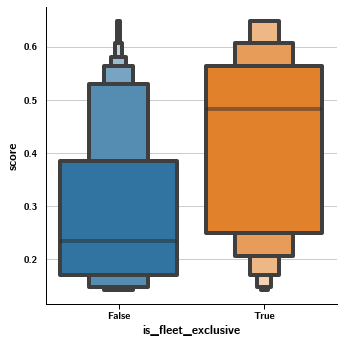

In [74]:
predictions = pd.DataFrame({"is_fleet_exclusive": y.astype(bool), "score": yhat}).sort_values("score", ascending=False)
sns.catplot(data=predictions, x="is_fleet_exclusive", y="score", kind="boxen")

In [75]:
def precision_recall_curve(preds):
    preds = preds.sort_values("score", ascending=False)
    data = {
        "threshold": [], 
        "proportion": [], 
        "precision": [], 
        "recall": [], 
        "false_positive_rate": [],
    }
    n = len(preds)
    n_positives = preds.is_fleet_exclusive.sum()
    n_negatives = n - n_positives
    for i in range(n):
        top_n = i+1
        selected = preds.iloc[:top_n]
        data["threshold"].append(preds.iloc[i].score)
        data["proportion"].append(top_n / n)
        data["precision"].append(selected.is_fleet_exclusive.mean())
        data["recall"].append(selected.is_fleet_exclusive.sum() / n_positives)
        data["false_positive_rate"].append((~selected.is_fleet_exclusive).sum() / n_negatives)
    return pd.DataFrame(data)
prk = precision_recall_curve(predictions)

In [76]:
i = abs(prk.recall - 0.5).argmin()
prk.loc[i]

threshold              0.482465
proportion             0.287330
precision              0.590551
recall                 0.500000
false_positive_rate    0.178082
Name: 253, dtype: float64

precision @ recall=0.5: 0.5906


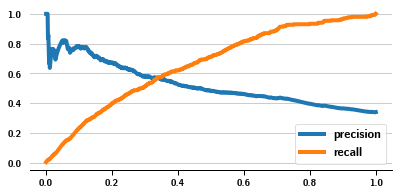

In [77]:
plt.plot(prk.proportion, prk.precision, label="precision")
plt.plot(prk.proportion, prk.recall, label="recall")
plt.legend()
print(f"precision @ recall=0.5: {prk.loc[i].precision:0.4f}")

AUC = 0.7416438356164383


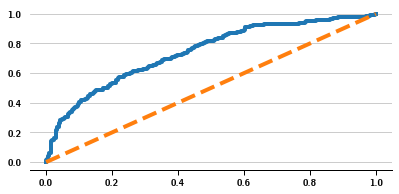

In [78]:
plt.plot(prk.false_positive_rate, prk.recall, label="ROC")
plt.plot([0, 1], [0, 1], '--',  label="random")
from sklearn.metrics import auc
print(f"AUC = {auc(prk.false_positive_rate, prk.recall)}")

In [79]:
from interpret import set_visualize_provider
from interpret.provider import InlineProvider
set_visualize_provider(InlineProvider())

explanations = ebm.explain_global()

In [80]:
explanations.visualize()

In [81]:
features = explanations.data()["names"]
explanations.visualize(features.index("trip_relative_path_impact"))

In [82]:
explanations.visualize(features.index("usability"))

In [83]:
explanations.visualize(features.index("trip_relative_path_impact x usability"))

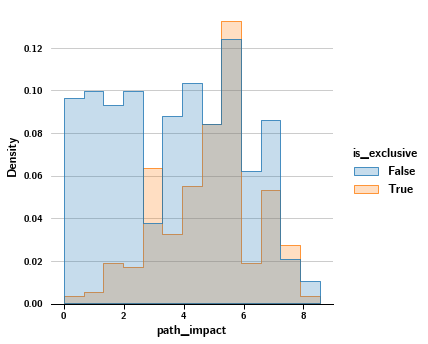

In [84]:
g = sns.displot( 
	data=data, 
	x="path_impact", 
	#y="link_cost_gradient",
	hue="is_exclusive", 
	kind="hist",
	element="step", 
	stat="density", 
	#cut=0
)
g.despine(left=True)

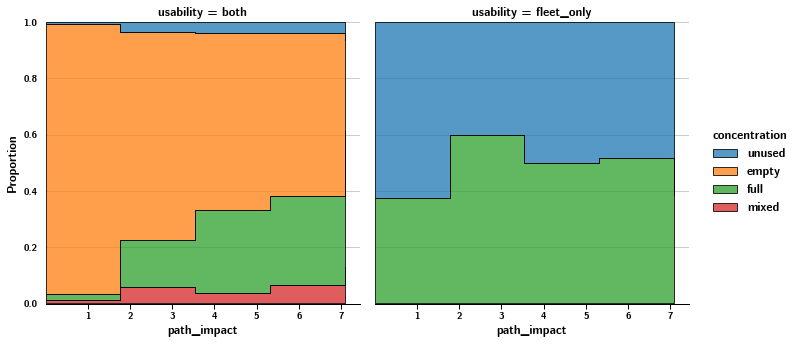

In [85]:
g = sns.displot( 
	data=mip_fleet_paths.reset_index(), 
	x="path_impact", 
	#y="link_fleet_marginal_cost",
	hue="concentration", 
	kind="hist",
	#cut=0, 
	#bw_adjust=1.0, 
	stat="proportion", 
	multiple="fill", 
	element="step", 
	#fill=False,
	bins=8, 
	hue_order=["unused", "empty", "full", "mixed"],
	col="usability",
	col_order=["both", "fleet_only"],
)
g.despine(left=True)

#set_linestyles(g, ["-", ":", "-."])

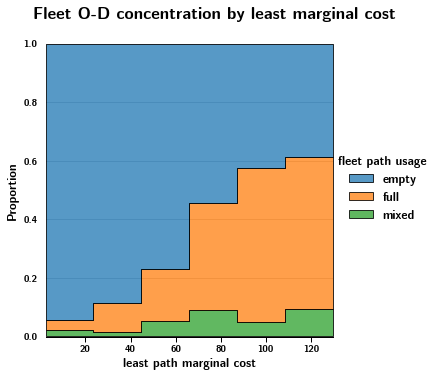

In [89]:
mip_trip_mc = mip_fleet_paths.groupby("trip_id").agg(
    flow = ("flow", "sum"),
    aggregate_flow = ("aggregate_flow", "sum"),
    least_marginal_cost = ("link_marginal_cost", "min")
)
mip_trip_mc["fleet_fraction"] = mip_trip_mc.flow / mip_trip_mc.aggregate_flow
mip_trip_mc["concentration"] = mip_trip_mc.fleet_fraction.apply(concentration_category)
g = sns.displot(
    data=mip_trip_mc.reset_index(),
    x="least_marginal_cost",
    hue="concentration", 
	kind="hist",
	#cut=0, 
	#bw_adjust=1.0, 
	stat="proportion", 
	multiple="fill", 
	element="step", 
	#fill=False,
	bins=6, 
	hue_order=["empty", "full", "mixed"], 
)
g.despine(left=True)
g.set_xlabels("least path marginal cost")
g.legend.set_title("fleet path usage")
g.fig.suptitle("Fleet O-D concentration by least marginal cost", y=1.05, fontweight="bold")
g.fig.savefig("saved_figures/trip-marginal-cost-fleet-flow.png", bbox_inches="tight")

Text(0.5, 1.0, 'Fleet path usage by marginal cost')

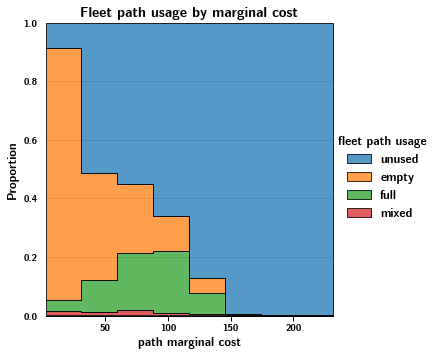

In [90]:
g = sns.displot( 
	data=mip_fleet_paths.reset_index(), 
	x="link_marginal_cost",
	hue="concentration", 
	kind="hist",
	#cut=0, 
	#bw_adjust=1.0, 
	stat="proportion", 
	multiple="fill", 
	element="step", 
	#fill=False,
	bins=8, 
	hue_order=["unused", "empty", "full", "mixed"], 
)
g.despine(left=True)
g.set_xlabels("path marginal cost")
g.legend.set_title("fleet path usage")
g.ax.set_title("Fleet path usage by marginal cost")

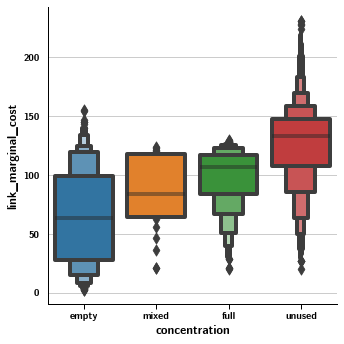

In [91]:
g = sns.catplot(
	data=mip_fleet_paths.reset_index(), 
	x="concentration", 
	order=["empty", "mixed", "full", "unused"], 
	y="link_marginal_cost", 
	kind="boxen", 
)

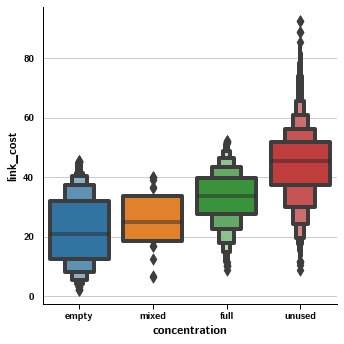

In [92]:
g = sns.catplot(
	data=mip_fleet_paths.reset_index(), 
	x="concentration", 
	order=["empty", "mixed", "full", "unused"], 
	y="link_cost", 
	kind="boxen", 
)

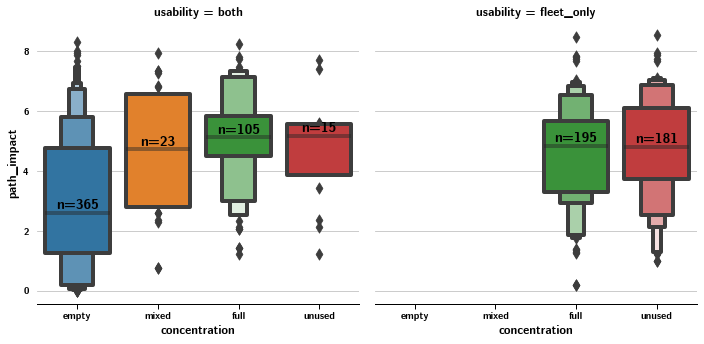

In [93]:
_order = ["empty", "mixed", "full", "unused"]
g = sns.catplot(
	data=mip_fleet_paths.reset_index(), 
	x="concentration", 
	order=_order, 
	y="path_impact", 
	kind="boxen",
	col="usability",
	col_order=["both", "fleet_only"],
)
g.despine(left=True)
counts = mip_fleet_paths.groupby(["usability", "concentration"]).path_impact.agg(n="count", y="median")
for usability, ax in g.axes_dict.items():
	for i, concentration in enumerate(_order):
		try:
			datum = counts.loc[(usability, concentration)]
		except KeyError:
			pass
		else:
			ax.annotate(f"n={int(datum.n):d}", xy=(i, datum.y), horizontalalignment="center", xytext=(0, 4), textcoords="offset points")

<AxesSubplot:xlabel='flow_fraction', ylabel='Proportion'>

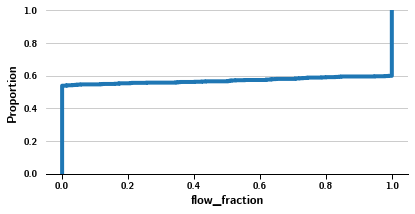

In [94]:
sns.ecdfplot(data=mip_fleet_paths, x="flow_fraction")

In [95]:
mip_fleet_paths.groupby(["is_exclusive", "concentration"]).size()

is_exclusive  concentration
False         empty             405
              mixed              23
              unused           2374
True          full              300
dtype: int64

In [96]:
# using different "scores" as classifiers
def precision_at_interquartile_range(fleet_paths, col):
    bounds = fleet_paths.groupby("is_exclusive")[col].agg(lower=lambda x: np.quantile(x, 0.25), upper=lambda x: np.quantile(x, 0.75)).loc[True]
    return fleet_paths[(bounds.lower <= fleet_paths[col]) & (fleet_paths[col] <= bounds.upper)].is_exclusive.mean()

pd.Series({
	method: precision_at_interquartile_range(mip_fleet_paths[mip_fleet_paths.is_fleet_usable_path & mip_fleet_paths.is_user_usable_path], method)
	for method in ["link_cost","link_marginal_cost", "path_impact", "trip_relative_path_impact"]
}, name="precision @ inter-quartile range").sort_values(ascending=False)

path_impact                  0.456897
link_marginal_cost           0.378571
link_cost                    0.360544
trip_relative_path_impact    0.309942
Name: precision @ inter-quartile range, dtype: float64

In [97]:
mip_fleet_paths.columns

Index(['link_cost_gradient', 'geometry', 'aggregate_flow',
       'link_marginal_cost', 'link_cost', 'is_fleet_usable_path',
       'is_user_usable_path', 'link_fleet_marginal_cost', 'flow',
       'path_impact', 'is_used', 'flow_fraction', 'is_exclusive',
       'is_user_and_fleet_usable', 'concentration',
       'min_trip_fleet_marginal_cost', 'n_links', 'min_trip_path_impact',
       'avg_path_impact', 'avg_fleet_marginal_cost', 'avg_marginal_cost',
       'usability', 'trip_relative_fleet_marginal_cost',
       'trip_relative_path_impact', 'trip_avg_path_impact'],
      dtype='object')

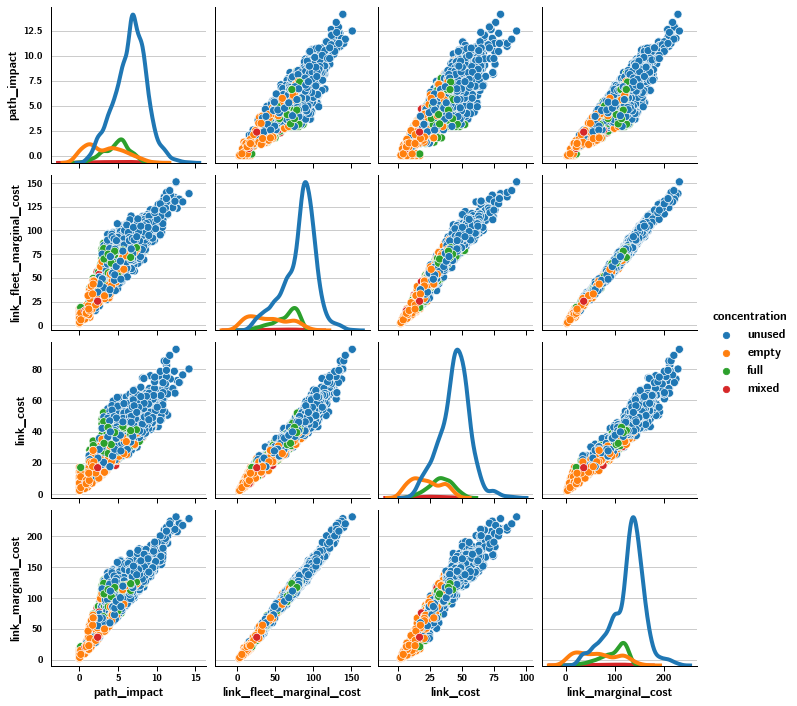

In [98]:
g = sns.pairplot(
	data=mip_fleet_paths.reset_index(), 
    vars=["path_impact", "link_fleet_marginal_cost", "link_cost", "link_marginal_cost"], 
    hue="concentration", 
    diag_kws=dict(fill=False),
)

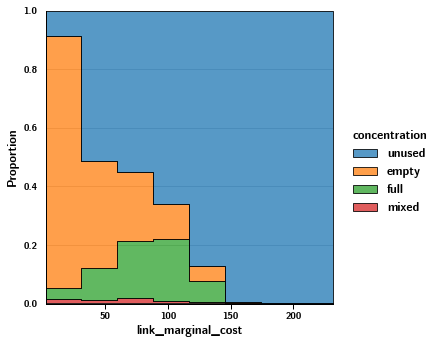

In [99]:
sns.displot(
	data=mip_fleet_paths.reset_index(), 
	x="link_marginal_cost", 
	#y="link_fleet_marginal_cost",
	hue="concentration", 
	kind="hist", 
	stat="proportion",
	multiple="fill",
	element="step",
	#fill=False,
	bins=8,
	hue_order=["unused", "empty", "full", "mixed"],
)

In [100]:
link_cost = sf_link_flow.free_flow_time * (1 + sf_link_flow.b * (sf_link_flow.aggregate_flow / sf_link_flow.capacity) ** sf_link_flow.power)
flow_class_marginal_link_cost = link_cost + sf_link_flow.flow * sf_link_flow.link_cost_gradient
sf_link_flow["flow_class_marginal_link_cost"] = flow_class_marginal_link_cost

In [101]:
extent = sf_link_flow.xs(("mip", "fleet"), level=(
    "solution_concept", "flow_class")).loc[set(sf_trip_path_link_idx.loc[214].link_id)].unary_union.buffer(0.01)

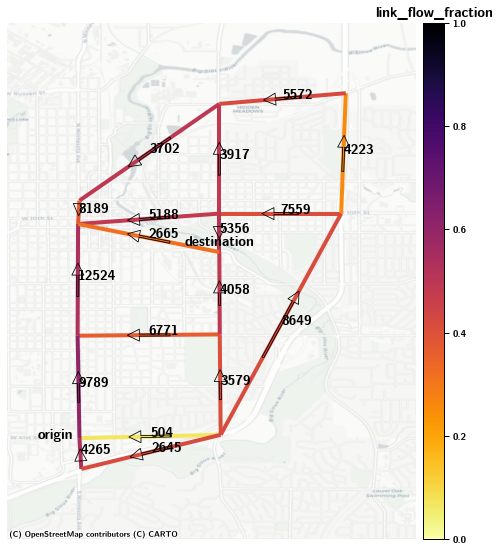

In [102]:
sioux_falls_extent = sf_link_flow.unary_union
trip_id = 214
nodes = sf_nodes.set_index("Node")
# fleet exclusive trip
with map_style():
	links = sf_link_flow.xs(("mip", "fleet"), level=(
		"solution_concept", "flow_class")).loc[set(sf_trip_path_link_idx.loc[trip_id].link_id)]
	ax = plot_with_basemap(links,
		"link_flow_fraction", legend=True, size=12, shift=0, cmap="inferno_r", vmin=0, vmax=1, extent=extent)
	for lid, link in links.iterrows():
		((x0, y0), (x1, y1)) = link.geometry.coords
		ax.annotate("", xy=(x0, y0), xytext=(x1, y1), arrowprops=dict(width=2, shrink=0.35, facecolor='none'))
		(x,), (y,) = link.geometry.centroid.xy
		ax.annotate(f"{link.flow:0.0f}", xy=(x, y))
	orgn = nodes.loc[22]
	ax.annotate("origin", xy=(orgn.geometry.x, orgn.geometry.y), xytext=(-6, 0), textcoords="offset points", horizontalalignment="right")
	dest = nodes.loc[17]
	ax.annotate("destination", xy=(dest.geometry.x, dest.geometry.y), xytext=(0, 6), textcoords="offset points", horizontalalignment="center")

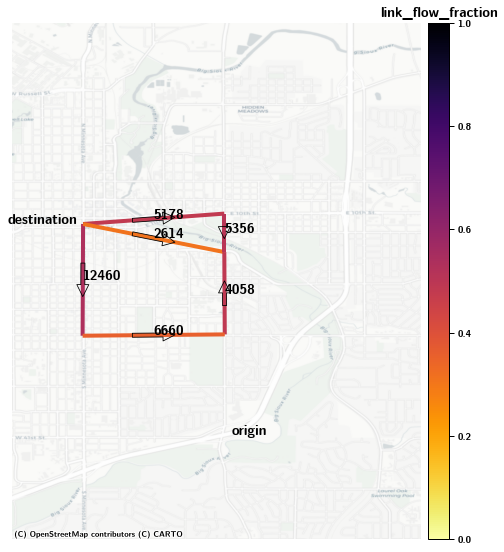

In [103]:
trip_id = 366
# fleet empty trip
with map_style():
	links = sf_link_flow.xs(("mip", "fleet"), level=(
		"solution_concept", "flow_class")).loc[set(sf_trip_path_link_idx.loc[trip_id].link_id)]
	ax = plot_with_basemap(links,
		"link_flow_fraction", legend=True, size=12, shift=0, buffer=0.01, cmap="inferno_r", vmin=0, vmax=1, extent=extent)
	for lid, link in links.iterrows():
		((x0, y0), (x1, y1)) = link.geometry.coords
		ax.annotate("", xy=(x0, y0), xytext=(x1, y1), arrowprops=dict(shrink=0.35, facecolor='none'))
		(x,), (y,) = link.geometry.centroid.xy
		ax.annotate(f"{link.flow:0.0f}", xy=(x, y))
	orgn = nodes.loc[20]
	ax.annotate("origin", xy=(orgn.geometry.x, orgn.geometry.y), xytext=(6, 0), textcoords="offset points")
	dest = nodes.loc[10]
	ax.annotate("destination", xy=(dest.geometry.x, dest.geometry.y), xytext=(-6, 0), textcoords="offset points", horizontalalignment="right")

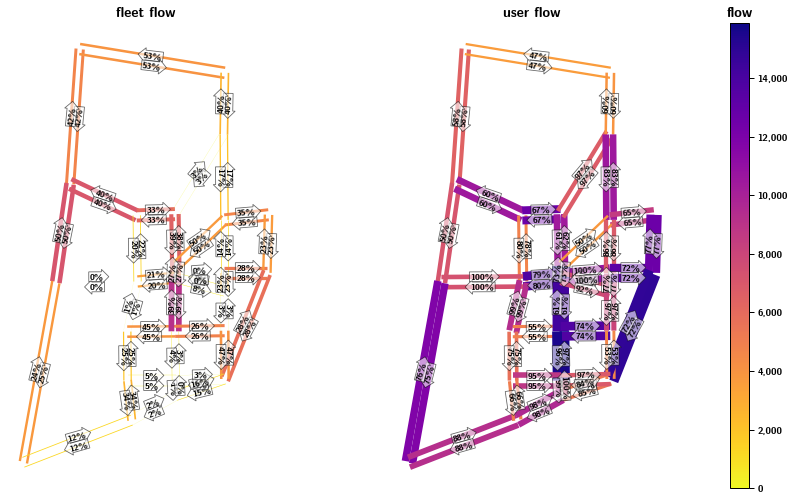

In [104]:
shift = 1.5e-3
source = ctx.providers.CartoDB.Positron
concept = "mcr"
vmin = 0
vmax = sf_link_flow.xs(concept, level="solution_concept").flow.max()
max_width = 10.0
cmap = "plasma_r"
legend_on = "user"

with map_style():
    fig, axs = plt.subplots(1, 2, figsize=(12, 16))
    for (flow_class, ax) in zip(["fleet", "user"], axs.squeeze()):
        plot_kws = dict(
            ax=ax, vmin=vmin, vmax=vmax, cmap=cmap
        )
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.1)
        if flow_class == legend_on:
            cax.set_title("flow")
            plot_kws.update(legend=True, cax=cax)
        links = sf_link_flow.xs(
            (concept, flow_class),
            level=("solution_concept", "flow_class")
        ).copy()
        links = shift_geometry(links, shift)
        links.plot(
            "flow",
            linewidth=max_width*(links.flow / vmax),
            **plot_kws,
        )
        ax.set(title=f"{flow_class} flow")
        #ctx.add_basemap(ax, crs=links.crs, source=source)
        ax.axis('off')
        for lid, link in links.iterrows():
            ((x0, y0), (x1, y1)) = link.geometry.coords
            #ax.annotate("", xy=(x0, y0), xytext=(x1, y1), arrowprops=dict(shrink=0.35, facecolor='none'))
            (x,), (y,) = link.geometry.centroid.xy
            if (x1-x0):
                rotation = np.rad2deg(np.arctan((y1-y0)/(x1-x0)))
            else:
                rotation = 90
            if np.arctan2(y1-y0, x1-x0) >= 0:
                arrowtype = "rarrow"
            else:
                arrowtype = "larrow"
            ax.annotate(f"{100*link.link_flow_fraction:0.0f}%", xy=(x, y),
                        rotation=rotation, ha="center", va="center", size=9,
                        bbox=dict(boxstyle=f"{arrowtype},pad=0.1", alpha=0.6, facecolor="w"))
cax.yaxis.set_major_formatter("{x:,g}")
plt.tight_layout()
plt.savefig("saved_figures/sf-cfs-map.png", bbox_inches="tight")

In [105]:
_df = sf_path_flow.xs(("mip", "fleet"), level=("solution_concept", "flow_class")).join((sf_trip_path_link_idx.link_id == 52).reorder_levels(["path_uuid", "trip_id"]).rename("contains_link_52"))
contains_link_52 = set(_df[_df.contains_link_52].trip_id.unique())

In [106]:
n_paths = sf_path_flow.drop(columns="trip_id").groupby(["solution_concept", "flow_class", "trip_id"]).size()

In [107]:
sf_trip_flow = sf_path_flow.drop(columns="trip_id").groupby(["solution_concept", "flow_class", "trip_id"])[["aggregate_flow", "flow"]].sum()
sf_trip_flow["flow_fraction"] = sf_trip_flow.flow / sf_trip_flow.aggregate_flow
sf_mip_fleet = sf_trip_flow.join(n_paths.rename("n_paths")).loc[("mip", "fleet")]
#sf_mip_fleet = sf_trip_flow.loc[("mip", "fleet")]
sf_mip_fleet[(sf_mip_fleet.flow_fraction <= 0.05) & (sf_mip_fleet.n_paths > 1)].sort_values(by="aggregate_flow", ascending=False).head(10)
#sf_mip_fleet.loc[[347, 214]]

,aggregate_flow,flow,flow_fraction,n_paths
trip_id,,,,
205,4000.0,0.000000e+00,0.000000e+00,2
366,3900.0,0.000000e+00,0.000000e+00,3
211,3900.0,6.139255e+01,1.574168e-02,3
228,3900.0,0.000000e+00,0.000000e+00,2
349,2800.0,1.971208e-06,7.040030e-10,5
372,2800.0,1.300949e-06,4.646246e-10,5
473,2600.0,0.000000e+00,0.000000e+00,3
216,2600.0,0.000000e+00,0.000000e+00,5
483,2400.0,8.071875e-07,3.363281e-10,3


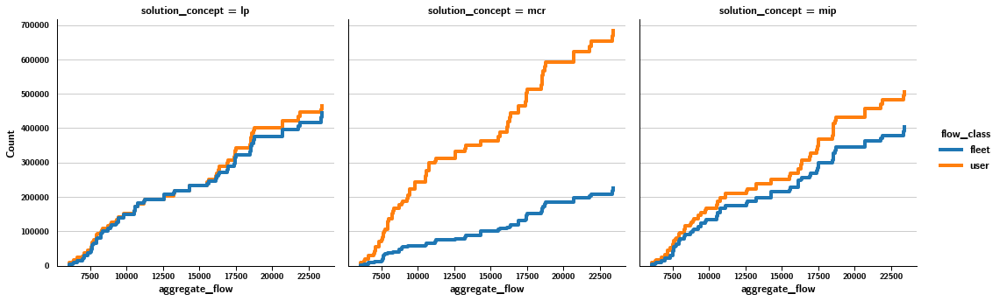

In [108]:
sns.displot(
	sf_link_flow.reset_index(), 
	x="aggregate_flow", 
	weights="flow", 
	hue="flow_class", 
	col="solution_concept", 
	kind="ecdf",
	stat="count", 
	#bins=8,
	#bw_adjust=0.6, 
	#clip=(0, None),
)

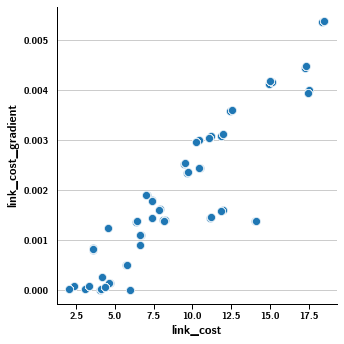

In [109]:
g = sns.relplot(
    data=sf_link_flow,
    x="link_cost",
    y="link_cost_gradient"
)
#x = np.array(g.ax.get_xlim())
#g.ax.plot(x, GRADIENT_COST_THRESHOLD* x, 'k:')

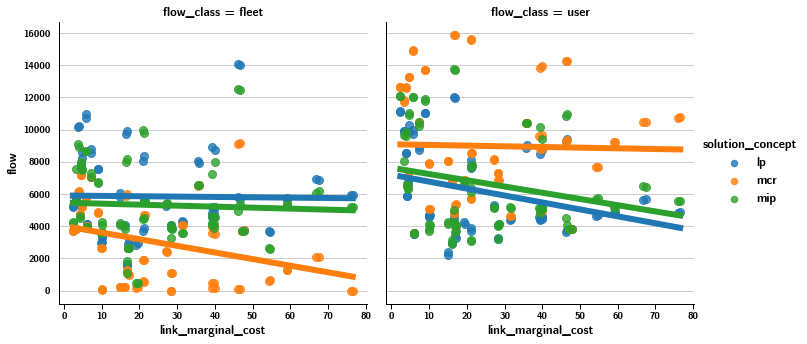

In [110]:
g = sns.lmplot(
    data=sf_link_flow.reset_index(),
    x="link_marginal_cost",
    y="flow",
    col="flow_class",
    hue="solution_concept",
    ci=None,
)

# Pittsburgh

In [111]:
link_dfs = []
path_dfs = []
trip_info_dfs = []
trip_path_link_dfs = []
min_demand = 50.0
for demand_level in [1.0]:
    res = Result(f"../spc-greater-pgh-{demand_level}-cfs-eps-1e-8-beta-1.0-final")
    link_dfs.append(add_demand_level_index(res.to_link_dataframe(), demand_level))
    path_dfs.append(add_demand_level_index(res.to_path_dataframe(), demand_level))
    trip_info_dfs.append(add_demand_level_index(res.mcr.to_trip_info_dataframe(), demand_level))
    trip_path_link_dfs.append(res.link_path_index)
spc_link_flow = with_flow_stats(pd.concat(link_dfs))
spc_path_flow = with_path_stats(pd.concat(path_dfs))
spc_trip_info = pd.concat(trip_info_dfs)
spc_trip_path_link_idx = pd.concat(trip_path_link_dfs)
with_usability_and_concentration(spc_path_flow)

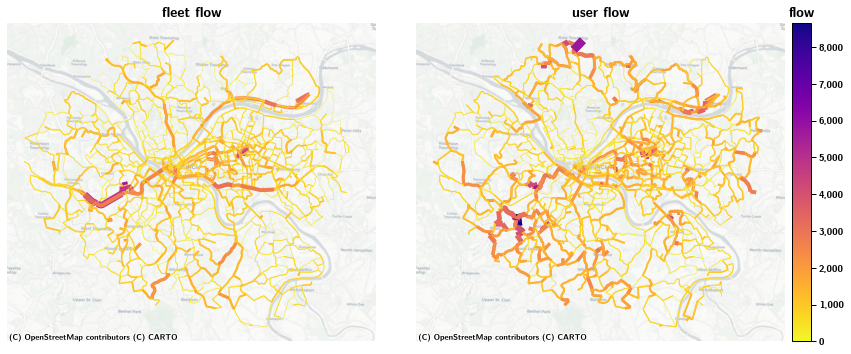

In [113]:
shift = 20.0
source = ctx.providers.CartoDB.Positron
concept = "mcr"
vmin = 0
vmax = spc_link_flow.xs(concept, level="solution_concept").flow.max()
max_width = 12.0
cmap = "plasma_r"
legend_on = "user"
annotate_links = False

with map_style():
    fig, axs = plt.subplots(1, 2, figsize=(12, 16))
    for (flow_class, ax) in zip(["fleet", "user"], axs.squeeze()):
        plot_kws = dict(
            ax=ax, vmin=vmin, vmax=vmax, cmap=cmap
        )
        divider = make_axes_locatable(ax)
        cax = divider.append_axes("right", size="5%", pad=0.1)
        if flow_class == legend_on:
            cax.set_title("flow")
            plot_kws.update(legend=True, cax=cax)
        links = spc_link_flow.xs(
            (concept, flow_class),
            level=("solution_concept", "flow_class")
        ).copy()
        links = shift_geometry(links, shift)
        links.plot(
            "flow",
            linewidth=max_width*(links.flow / vmax),
            **plot_kws,
        )
        ax.set(title=f"{flow_class} flow")
        ctx.add_basemap(ax, crs=links.crs, source=source)
        ax.axis('off')
        if annotate_links:
            for lid, link in links.iterrows():
                ((x0, y0), (x1, y1)) = link.geometry.coords
                #ax.annotate("", xy=(x0, y0), xytext=(x1, y1), arrowprops=dict(shrink=0.35, facecolor='none'))
                (x,), (y,) = link.geometry.centroid.xy
                if (x1-x0):
                    rotation = np.rad2deg(np.arctan((y1-y0)/(x1-x0)))
                else:
                    rotation = 90
                if np.arctan2(y1-y0, x1-x0) >= 0:
                    arrowtype = "rarrow"
                else:
                    arrowtype = "larrow"
                ax.annotate(f"{100*link.link_flow_fraction:0.0f}%", xy=(x, y),
                            rotation=rotation, ha="center", va="center", size=8,
                            bbox=dict(boxstyle=f"{arrowtype},pad=0.1", alpha=0.6, facecolor="w"))
plt.tight_layout()
cax.yaxis.set_major_formatter("{x:,g}")
plt.savefig("saved_figures/pgh-cfs-map.png", bbox_inches="tight")

In [114]:
pgh_ue = FWResult.load("results/pittsburgh-network-mpo-greater-pgh-1.0-min-50.0-NoThruTrips_fw-ue/results-2021-10-20T21:09:25")
sf_ue = FWResult.load("results/sioux-falls-ue/results-2021-10-20T20:36:47")
ue_trip_cost = pd.concat([
	pd.Series(pgh_ue.trip_cost.to_array(), name="trip_cost").rename_axis("trip_id"), 
	pd.Series(sf_ue.trip_cost.to_array(), name="trip_cost").rename_axis("trip_id"),
], keys=["Pittsburgh", "Sioux Falls"], names=["network"]
)

In [115]:
sf_ue_total_cost = sf_ue.problem.demand.volumes.to_array().dot(sf_ue.trip_cost.to_array())
pgh_ue_total_cost =  pgh_ue.problem.demand.volumes.to_array().dot(pgh_ue.trip_cost.to_array())

In [116]:
print(f"The Pittsburgh network has {len(pgh_ue.flow.to_array())} links and {len(pgh_ue.trip_cost.to_array())} OD pairs")

The Pittsburgh network has 5449 links and 4881 OD pairs


In [117]:
print(f"The Sioux Falls network has {len(sf_ue.flow.to_array())} links and {len(sf_ue.trip_cost.to_array())} OD pairs")

The Sioux Falls network has 76 links and 528 OD pairs


In [118]:
#res = Result(f"../spc-net-gpa-1.0-demand-min-50.0-alt-02")
#spc_link_flow_alt = with_flow_stats(add_demand_level_index(res.to_link_dataframe(), 1.0))
#spc_path_flow_alt = with_path_stats(add_demand_level_index(res.to_path_dataframe(), 1.0))
#spc_trip_info_alt = add_demand_level_index(res.mcr.to_trip_info_dataframe(), 1.0)
#spcl_trip_path_link_idx_alt = res.link_path_index

In [119]:
allegheny_county_extent = ox.geocode_to_gdf('Allegheny County, PA').to_crs(spc_link_flow.crs).unary_union
pittsburgh_extent = ox.geocode_to_gdf('Pittsburgh, PA').to_crs(spc_link_flow.crs).unary_union
golden_triangle_extent = place_to_extent('Downtown Pittsburgh, PA', spc_link_flow.crs, 1000)
cmu_pgh_extent = place_to_extent("Carnegie Mellon University, Pittsburgh, PA", spc_link_flow.crs, 5000)

In [120]:
#spc_path_flow_alt["concentration"] = (2 * spc_path_flow_alt.flow_fraction - 1)**2

In [121]:
sf_spc_all_paths = pd.concat(
        [spc_path_flow.xs(1.0, level="demand_level"), sf_path_flow],
        keys=["Pittsburgh", "Sioux Falls"],
        names=["network"]
).drop(columns=["trip_id"])

sf_spc_paths = sf_spc_all_paths.xs("fleet", level="flow_class").copy()
sf_spc_paths["path_length"] = sf_spc_paths.geometry.apply(lambda l: l.length)

In [122]:
sf_spc_trip_flow = sf_spc_all_paths.groupby(["network", "solution_concept", "flow_class", "trip_id"]).flow.sum().sort_index()
sf_spc_ue_trip_flow_cost = sf_spc_trip_flow.to_frame().join(ue_trip_cost)
sf_spc_ue_trip_flow_cost["total_trip_cost"] = sf_spc_ue_trip_flow_cost.flow * sf_spc_ue_trip_flow_cost.trip_cost
alt_costs = sf_spc_ue_trip_flow_cost.groupby(["network", "solution_concept", "flow_class"])[["flow", "total_trip_cost"]].sum()
ue_average_cost = (alt_costs.total_trip_cost / alt_costs.flow).rename("average_cost").to_frame()
ue_average_cost.reset_index("flow_class", inplace=True)
ue_average_cost["flow_class"] = ue_average_cost.flow_class.apply(lambda s: f"{s} at UE")
ue_average_cost.set_index("flow_class", append=True, inplace=True)
ue_average_cost

average_cost
network     solution_concept flow_class                
Pittsburgh  lp               fleet at UE  111513.148255
                             user at UE    48206.684761
            mcr              fleet at UE  136013.835407
                             user at UE    85176.965851
Sioux Falls lp               fleet at UE      28.891164
                             user at UE       16.054333
            mcr              fleet at UE      31.554084
                             user at UE       18.965068
            mip              fleet at UE      28.807259
                             user at UE       16.765823

In [123]:
sf_spc_trip_flow = sf_spc_all_paths.groupby(["network", "solution_concept", "flow_class", "trip_id"])[["flow", "aggregate_flow"]].sum()
sf_spc_trip_flow["flow_fraction"] = sf_spc_trip_flow.flow / sf_spc_trip_flow.aggregate_flow
sf_spc_trip_flow["exclusive"] = (sf_spc_trip_flow.flow_fraction <=0.05) | (sf_spc_trip_flow.flow_fraction >= 0.95)
sf_spc_trip_flow.groupby(["network", "solution_concept", "flow_class"]).exclusive.mean()

network      solution_concept  flow_class
Pittsburgh   lp                fleet         0.894079
                               user          0.894079
             mcr               fleet         0.930957
                               user          0.930957
Sioux Falls  lp                fleet         0.920455
                               user          0.920455
             mcr               fleet         0.799242
                               user          0.799242
             mip               fleet         0.924242
                               user          0.924242
Name: exclusive, dtype: float64

In [124]:
binwidths = {"fare": 20, "age": 5}

col = "network"
row = "solution_concept"

g = sns.FacetGrid(
    sf_spc_trips_mc.xs("fleet", level="flow_class").reset_index(),
    col="network",
    row="solution_concept",
    sharex="col",
    legend_out=True)
legend_data = {}
for (row_val, col_val), ax in g.axes_dict.items():
    sns.histplot(
        data=g.data[(g.data[row] == row_val) & (g.data[col] == col_val)],
        x="least_marginal_path_cost",
        hue="concentration",
        stat="proportion", 
        multiple="fill", 
        element="step", 
        #fill=False,
        bins=6, 
        hue_order=["empty", "full", "mixed"],
        ax=ax,
        legend=ax is g.axes.flat[-1]
    )
g.set_titles(template="{col_name} {col_var}")
#plt.setp(g.axes[1], title="")
sns.move_legend(ax, loc="lower left", bbox_to_anchor=(1, 1))

NameError: name 'sf_spc_trips_mc' is not defined

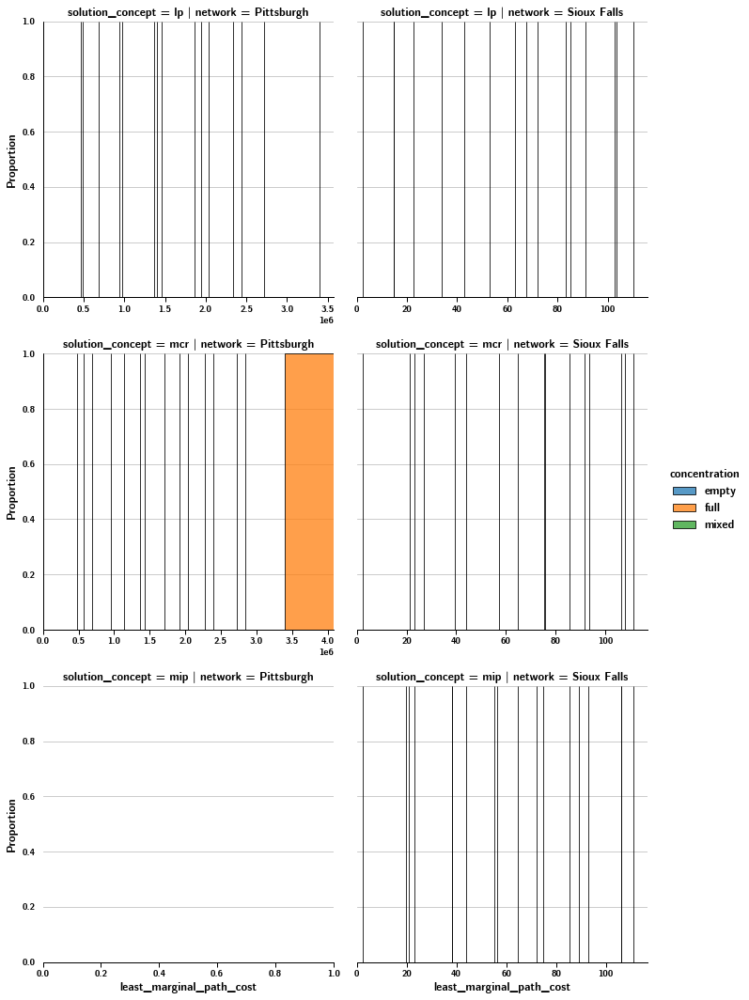

In [125]:
sf_spc_trips_mc = sf_spc_all_paths.groupby(["network", "trip_id", "solution_concept", "flow_class"]).agg(
    aggregate_flow=("aggregate_flow", "sum"),
    flow=("flow", "sum"),
    least_marginal_path_cost=("link_marginal_cost", "min")
)
sf_spc_trips_mc["fleet_fraction"] = sf_spc_trips_mc.flow / sf_spc_trips_mc.aggregate_flow
sf_spc_trips_mc["concentration"] = sf_spc_trips_mc.fleet_fraction.apply(concentration_category)
g = sns.displot(
    data=sf_spc_trips_mc.xs("fleet", level="flow_class").reset_index(),
    x="least_marginal_path_cost",
    hue="concentration", 
    col="network",
    row="solution_concept",
	kind="hist",
	#cut=0, 
	#bw_adjust=1.0, 
	stat="proportion", 
	multiple="fill", 
	element="step", 
	#fill=False,
	bins=6, 
	hue_order=["empty", "full", "mixed"],
    facet_kws=dict(
        sharex=False
    ),
    common_bins=False,
)
g.despine(left=True)
#g.set_xlabels("least path marginal cost")
#g.legend.set_title("fleet path usage")
#g.ax.set_title("Fleet O-D concentration by least marginal cost")

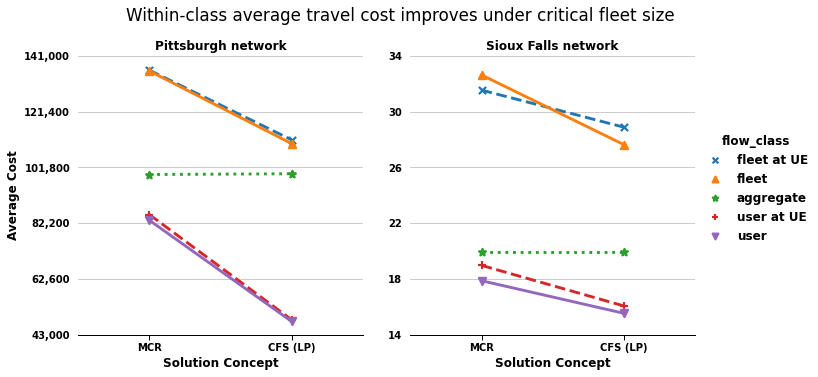

In [230]:
sf_spc_all_paths["total_path_cost"] = sf_spc_all_paths.link_cost * sf_spc_all_paths.flow
total_costs = sf_spc_all_paths.groupby(["network", "solution_concept", "flow_class"])[["flow", "total_path_cost"]].sum()
aggregate_costs = sf_spc_all_paths.groupby(["network", "solution_concept"])[["flow", "total_path_cost"]].sum()
aggregate_costs["flow_class"] = "aggregate" 
aggregate_costs.set_index("flow_class", append=True, inplace=True)
total_costs = pd.concat([
	total_costs,
	aggregate_costs,
])
total_costs["average_cost"] = total_costs.total_path_cost / total_costs.flow
total_costs = pd.concat([ 
	total_costs,
	ue_average_cost,
])
g = sns.catplot(
	data=total_costs.reset_index(),
	hue="flow_class", 
	hue_order=["fleet at UE", "fleet", "aggregate", "user at UE", "user"],
	y="average_cost", 
	x="solution_concept", 
	order=["mcr", "lp"],
	col="network",
	sharey=False, 
	kind="point",
	scale=0.4,
	linestyles=["--", "-", ":", "--", "-"],
	markers=["x", "^", "*", "+", "v"],
)
g.despine(left=True)
g.set_xlabels("Solution Concept")
g.set_ylabels("Average Cost")
g.set_titles("{col_name} {col_var}")
g.set_xticklabels(["MCR", "CFS (LP)"])
g.fig.suptitle("Within-class average travel cost improves under critical fleet size", y=1.05)
n_ticks = 6
for ax in g.axes.flatten():
    ax.yaxis.set_major_formatter("{x:,g}")
    ymin, ymax = ax.get_ylim()
    _factor = 10 ** (np.ceil(np.log10(ymin)) - 2)
    yticks = np.linspace(_factor*np.floor(ymin/_factor), _factor*np.ceil(ymax/_factor), n_ticks)
    ax.set_yticks(yticks)
plt.savefig("saved_figures/average-cost-mcr-cfs.png", bbox_inches="tight")

In [127]:
sf_poa = total_costs.xs(("Sioux Falls", "aggregate"), level=("network", "flow_class")).total_path_cost / sf_ue_total_cost
pgh_poa =  total_costs.xs(("Pittsburgh", "aggregate"), level=("network", "flow_class")).total_path_cost / pgh_ue_total_cost 
sys_opt_discount = pd.concat([sf_poa, pgh_poa], keys=["Sioux Falls", "Pittsburgh"], names=["network"]).rename("system optimality discount").groupby("network").max()
sys_opt_discount

NameError: name 'total_costs' is not defined

In [128]:
avg_cost_by_sol = total_costs.groupby(["flow_class", "network", "solution_concept"]).average_cost.mean()
avg_cost_by_sol

NameError: name 'total_costs' is not defined

In [129]:
optimality_discount = (avg_cost_by_sol.loc["fleet"] / avg_cost_by_sol.loc["fleet at UE"]).rename("fleet optimality discount")
(optimality_discount.to_frame(
    ).join(sys_opt_discount, how="left"
    ).join((avg_cost_by_sol.loc["user"] / avg_cost_by_sol.loc["user at UE"]).rename("fleet optimality discount (user)")) - 1)*100

NameError: name 'avg_cost_by_sol' is not defined

In [130]:
(avg_cost_by_sol.loc["user"] / avg_cost_by_sol.loc["user at UE"]).rename("fleet optimality discount (user)")

NameError: name 'avg_cost_by_sol' is not defined

In [131]:
trip_costs = sf_spc_all_paths.groupby(["network", "solution_concept", "flow_class", "trip_id"])[["flow", "total_path_cost"]].sum()
trip_costs["average_cost"] = trip_costs.total_path_cost / trip_costs.flow
trip_costs = trip_costs.drop(columns="total_path_cost").reset_index().pivot(index=["network", "solution_concept", "trip_id"], columns="flow_class", values=["flow", "average_cost"])

KeyError: "Columns not found: 'total_path_cost'"

In [132]:
trip_costs["average_cost_difference"] = trip_costs["average_cost", "user"] - trip_costs["average_cost", "fleet"]
trip_costs["fleet_is_better_off"] = trip_costs.average_cost_difference >= 0
fleet_better_off = trip_costs.groupby(["network", "solution_concept", "fleet_is_better_off"])[[("flow", "fleet"), ("flow", "user")]].agg(["sum", "count"])
fleet_better_off

NameError: name 'trip_costs' is not defined

In [133]:
fleet_better_off / trip_costs.groupby(["network", "solution_concept"])[[("flow", "fleet"), ("flow", "user")]].agg(["sum", "count"])

NameError: name 'fleet_better_off' is not defined

In [134]:
def average_cost(group):
	total_flow = group.flow.sum()
	if total_flow:
		return (group.flow * group.link_cost).sum() / total_flow
	else: 
		return np.NaN
		
trip_costs = (sf_spc_all_paths.groupby(["network", "solution_concept", "flow_class", "trip_id", "is_used"])
                 .apply(average_cost)
				 .rename("avg_cost")
				 .xs(True, level="is_used")
				 .to_frame()
				 .reset_index()
				 .pivot(index=["network", "solution_concept", "trip_id"], columns="flow_class", values="avg_cost")
				 #.fillna(0.0)
)


In [135]:
trip_costs["avg_cost_difference"] = (trip_costs.fleet - trip_costs.user) / trip_costs.user
trip_costs.head()

flow_class                                  fleet          user  \
network    solution_concept trip_id                               
Pittsburgh lp               0        22660.784704           NaN   
                            1         7534.222448           NaN   
                            2        15635.313844           NaN   
                            3                 NaN  18223.036149   
                            4        11491.046524           NaN   

flow_class                           avg_cost_difference  
network    solution_concept trip_id                       
Pittsburgh lp               0                        NaN  
                            1                        NaN  
                            2                        NaN  
                            3                        NaN  
                            4                        NaN

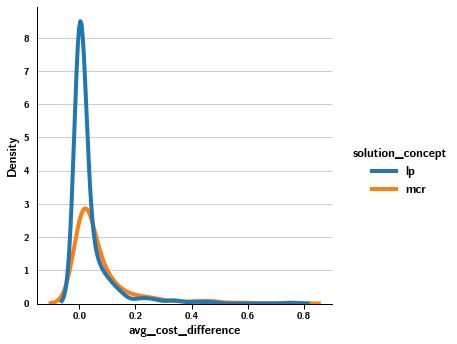

In [136]:
sns.displot(
	data=trip_costs.xs("Pittsburgh", level="network").reset_index(),
	x="avg_cost_difference",
	hue="solution_concept",
	kind="kde"
)

In [137]:
sf_spc_paths.head()

link_cost_gradient  \
network    path_uuid                            trip_id solution_concept                       
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                          5.870060   
                                                        mcr                         5.870060   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                         81.479388   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                         30.735246   
                                                        mcr                        30.735246   

                                                                                                                   geometry  \
network    path_uuid                            trip_id solution_concept                                                      
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                MULTILINESTRING ((1343159.770 411800.656, 1343...   
                                                        mcr               MULTILINESTRING ((1343159.770 411800.656, 1343...   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                MULTILINESTRING ((1319795.500 395627.882, 1321...   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                MULTILINESTRING ((1380729.775 413210.622, 1379...   
                                                        mcr               MULTILINESTRING ((1380729.775 413210.622, 1379...   

                                                                          aggregate_flow  \
network    path_uuid                            trip_id solution_concept                   
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                         114.0   
                                                        mcr                        114.0   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                           0.0   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                         174.0   
                                                        mcr                        174.0   

                                                                          link_marginal_cost  \
network    path_uuid                            trip_id solution_concept                       
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                      11928.968302   
                                                        mcr                     11928.968302   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                     288445.162749   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                      72358.461366   
                                                        mcr                     72358.461366   

                                                                             link_cost  \
network    path_uuid                            trip_id solution_concept                 
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                 5985.793660   
                                                        mcr                5985.793660   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                63515.699216   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                18771.692273   
                                                        mcr               18771.692273   

                                                                          is_fleet_usable_path  \
network    path_uuid                            trip_id solution_concept                         
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                                True   
                                                        mcr                               True   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                               False   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp              

In [138]:
from matplotlib.ticker import ScalarFormatter
from matplotlib import cbook

In [139]:
short_sci_formatter = ScalarFormatter(useLocale=False)
#short_sci_formatter.format = "%0.1f"
#short_sci_formatter.format = "%0.1f"
short_sci_formatter.format_data_short(1e4)


AttributeError: 'NoneType' object has no attribute 'get_view_interval'

In [ ]:
_df

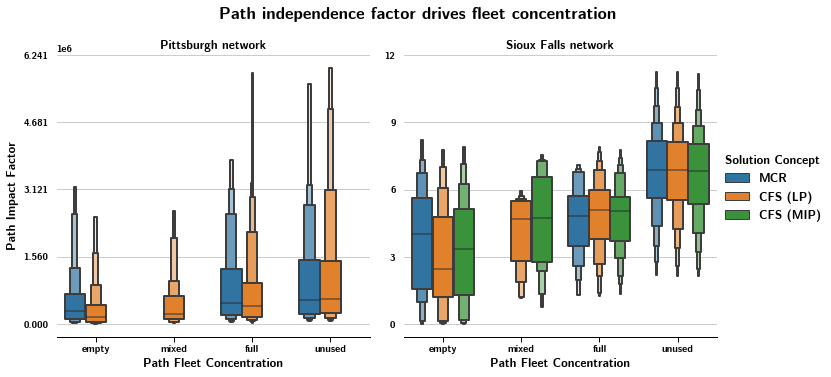

In [140]:
SOLUTION_CONCEPT_ORDER = ["mcr", "lp", "mip"]
SOLUTION_CONCEPT_LABELS = ["MCR", "CFS (LP)", "CFS (MIP)"]
SOLUTION_CONCEPT_LABELS_MAP = dict(zip(SOLUTION_CONCEPT_ORDER, SOLUTION_CONCEPT_LABELS))
_df = sf_spc_paths.rename(index=SOLUTION_CONCEPT_LABELS_MAP, level="solution_concept").rename_axis(index={'solution_concept': "Solution Concept"})
g = sns.catplot(
    data=_df.reset_index(),
    x="concentration",
    order=["empty", "mixed", "full", "unused"],
    y="path_impact",
    hue="Solution Concept",
    col="network",
    kind="boxen",
    hue_order=SOLUTION_CONCEPT_LABELS,
    col_order=["Pittsburgh", "Sioux Falls"],
    sharey=False,
    showfliers=False,
    linewidth=2.0,
    k_depth="proportion",
    outlier_prop=0.1,
    legend=True,
)
g.fig.suptitle("Path independence factor drives fleet concentration", y=1.05, fontweight="bold")
g.despine(left=True)
g.set_titles("{col_name} {col_var}")
g.set_ylabels("Path Impact Factor")
g.set_xlabels("Path Fleet Concentration")
n_ticks = 5
for ax in g.axes.flatten():
    
    ymin, ymax = ax.get_ylim()
    _factor = 1.0# 10 ** (np.ceil(np.log10(ymin)) - 2)
    yticks = np.linspace(0, _factor*np.ceil(ymax/_factor), n_ticks)
    ax.set_yticks(yticks)
#plt.tight_layout()

g.savefig("saved_figures/path-imapct-factor-fleet-concentration.png", bbox_inches="tight")


In [141]:
_df.groupby(["network", "Solution Concept", "concentration"]).flow_fraction.describe()

count      mean       std  \
network     Solution Concept concentration                               
Pittsburgh  CFS (LP)         empty           784.0  0.000243  0.003097   
                             full           4153.0  0.999834  0.002335   
                             mixed           162.0  0.732060  0.125728   
                             unused          110.0  0.274666  0.126876   
            MCR              empty          3292.0  0.000000  0.000000   
                             full           1989.0  1.000000  0.000000   
                             unused            0.0       NaN       NaN   
Sioux Falls CFS (LP)         empty           333.0  0.000119  0.001739   
                             full            546.0  0.999761  0.002944   
                             mixed            15.0  0.755610  0.107790   
                             unused           30.0  0.222117  0.113849   
            CFS (MIP)        empty           405.0  0.000354  0.003480   
                             full            300.0  0.999895  0.001331   
                             mixed            23.0  0.681171  0.127374   
                             unused           15.0  0.252398  0.123327   
            MCR              empty           548.0  0.000000  0.000000   
                             full            376.0  1.000000  0.000000   
                             unused            0.0       NaN       NaN   

                                                 min           25%  \
network     Solution Concept concentration                           
Pittsburgh  CFS (LP)         empty          0.000000  0.000000e+00   
                             full           0.951410  1.000000e+00   
                             mixed          0.508329  6.341807e-01   
                             unused         0.053606  1.681683e-01   
            MCR              empty          0.000000  0.000000e+00   
                             full           1.000000  1.000000e+00   
                             unused              NaN           NaN   
Sioux Falls CFS (LP)         empty          0.000000  9.381587e-11   
                             full           0.958275  1.000000e+00   
                             mixed          0.576233  6.593918e-01   
                             unused         0.052741  1.201471e-01   
            CFS (MIP)        empty          0.000000  0.000000e+00   
                             full           0.979856  1.000000e+00   
                             mixed          0.502636  5.864251e-01   
                             unused         0.056435  1.649373e-01   
            MCR              empty         -0.000000 -0.000000e+00   
                             full           1.000000  1.000000e+00   
                             unused              NaN           NaN   

                                                     50%           75%  \
network     Solution Concept concentration                               
Pittsburgh  CFS (LP)         empty          0.000000e+00  0.000000e+00   
                             full           1.000000e+00  1.000000e+00   
                             mixed          7.389098e-01  8.375105e-01   
                             unused         2.791678e-01  3.865306e-01   
            MCR              empty          0.000000e+00  0.000000e+00   
                             full           1.000000e+00  1.000000e+00   
                             unused                  NaN           NaN   
Sioux Falls CFS (LP)         empty          3.364869e-10  1.109188e-09   
                             full           1.000000e+00  1.000000e+00   
                             mixed          7.756080e-01  8.549035e-01   
                             unused         2.320879e-01  3.232314e-01   
            CFS (MIP)        empty          0.000000e+00  4.148490e-10   
                             full           1.000000e+00  1.000000e+00   
                             mixed          7.062405e

In [142]:
#sf_spc_paths["path_length"] = sf_spc_paths.geometry.apply(lambda gs: gs.length)

In [143]:
sf_spc_paths.head()

link_cost_gradient  \
network    path_uuid                            trip_id solution_concept                       
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                          5.870060   
                                                        mcr                         5.870060   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                         81.479388   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                         30.735246   
                                                        mcr                        30.735246   

                                                                                                                   geometry  \
network    path_uuid                            trip_id solution_concept                                                      
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                MULTILINESTRING ((1343159.770 411800.656, 1343...   
                                                        mcr               MULTILINESTRING ((1343159.770 411800.656, 1343...   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                MULTILINESTRING ((1319795.500 395627.882, 1321...   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                MULTILINESTRING ((1380729.775 413210.622, 1379...   
                                                        mcr               MULTILINESTRING ((1380729.775 413210.622, 1379...   

                                                                          aggregate_flow  \
network    path_uuid                            trip_id solution_concept                   
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                         114.0   
                                                        mcr                        114.0   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                           0.0   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                         174.0   
                                                        mcr                        174.0   

                                                                          link_marginal_cost  \
network    path_uuid                            trip_id solution_concept                       
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                      11928.968302   
                                                        mcr                     11928.968302   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                     288445.162749   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                      72358.461366   
                                                        mcr                     72358.461366   

                                                                             link_cost  \
network    path_uuid                            trip_id solution_concept                 
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                 5985.793660   
                                                        mcr                5985.793660   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                63515.699216   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                18771.692273   
                                                        mcr               18771.692273   

                                                                          is_fleet_usable_path  \
network    path_uuid                            trip_id solution_concept                         
Pittsburgh 0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                                True   
                                                        mcr                               True   
           000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                               False   
           00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp              

In [144]:
sf_spc_trip_agg = pd.get_dummies(sf_spc_paths, columns=["concentration"]).reset_index("path_uuid").groupby(["network", "solution_concept", "trip_id"]).agg({
	"path_length": ["mean"],
	"aggregate_flow": ["sum", "mean"],
	"flow": "sum",
	"path_impact": ["mean"],
	"is_fleet_usable_path": ["mean"],
	"is_user_usable_path": ["mean"],
	"is_user_and_fleet_usable": ["mean"],
	"concentration_empty": ["mean"],
	"concentration_mixed": ["mean"],
	"concentration_full": ["mean"],
	"concentration_unused": ["mean"],
	"path_uuid": "count",
})
sf_spc_trip_agg.columns = ['_'.join(col).strip() for col in sf_spc_trip_agg.columns.values]
sf_spc_trip_agg["flow_fraction"] = sf_spc_trip_agg.flow_sum / sf_spc_trip_agg.aggregate_flow_sum

In [145]:
from sklearn.ensemble import GradientBoostingRegressor, RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import log_loss, make_scorer
from scipy.stats import spearmanr

eps = 1e-6

def neg_log_loss(estimator, X, y):
	y_hat = estimator.predict(X)
	return (y * np.log(y_hat + eps) + (1-y) * np.log(1-y_hat + eps)).sum()

def rank_correlation(estimator, X, y):
	y_hat = estimator.predict(X)
	return spearmanr(y_hat, y)[0]

clf = GradientBoostingRegressor()

cv = GridSearchCV(GradientBoostingRegressor(), dict(
	n_estimators=[500, 1000],
	max_depth=[2, 5],
	subsample=[1.0, 0.5],
	learning_rate=[0.2, 0.1, 0.01],
), n_jobs=-1, scoring=rank_correlation)

cv_rf = GridSearchCV(RandomForestRegressor(), dict(
	n_estimators=[100, 1000], 
	criterion=["mse", "poisson"],
	max_depth=[2, 5, None], 
	min_samples_leaf=[1, 5, 10], 
	max_features=["auto", "sqrt"],
), n_jobs=-1, scoring=rank_correlation)

data = sf_spc_trip_agg.xs(("Sioux Falls", "lp"), level=("network", "solution_concept"))
data = sf_spc_paths.xs(("Sioux Falls", "mip"), level=("network", "solution_concept"))
y = data["flow_fraction"].fillna(0.0)
def transform_target(y):
	return np.log((y + 1e-6) / (1-y + 1e-6)).values

def inverse_transform(y_transform):
	return 1.0 / (1.0 + np.exp(-y_transform))

y_transform = transform_target(y)
#X = data.drop(columns=["flow_fraction"])[["aggregate_flow_sum", "aggregate_flow_mean", "path_uuid_count", "path_impact_mean", "path_length_mean", "is_fleet_usable_path_mean", "is_user_usable_path_mean", "is_user_and_fleet_usable_mean"]]

X = data.drop(columns=["flow_fraction"])[["aggregate_flow", "path_impact", "path_length", "is_fleet_usable_path", "is_user_usable_path", "is_user_and_fleet_usable"]]

In [294]:
cv.fit(X, y_transform)

GridSearchCV(estimator=GradientBoostingRegressor(), n_jobs=-1,
             param_grid={'learning_rate': [0.2, 0.1, 0.01], 'max_depth': [2, 5],
                         'n_estimators': [500, 1000], 'subsample': [1.0, 0.5]},
             scoring=<function rank_correlation at 0x7f7d64392ca0>)

In [295]:
cv_rf.fit(X, y_transform)

GridSearchCV(estimator=RandomForestRegressor(), n_jobs=-1,
             param_grid={'criterion': ['mse', 'poisson'],
                         'max_depth': [2, 5, None],
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [1, 5, 10],
                         'n_estimators': [100, 1000]},
             scoring=<function rank_correlation at 0x7f7d64392ca0>)

In [299]:
scores = pd.DataFrame(cv_rf.cv_results_)
scores.sort_values(by="rank_test_score").head()

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_criterion,param_max_depth,param_max_features,param_min_samples_leaf,param_n_estimators,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score
25,6.095496,1.031179,0.286692,0.056347,mse,None,auto,1,1000,"{'criterion': 'mse', 'max_depth': None, 'max_f...",0.609404,0.673437,0.751909,0.819305,0.739705,0.718752,0.071638,1
24,0.502425,0.045131,0.024970,0.004848,mse,None,auto,1,100,"{'criterion': 'mse', 'max_depth': None, 'max_f...",0.609993,0.673256,0.753007,0.767316,0.740656,0.708846,0.059025,2
26,0.475572,0.045064,0.027670,0.005457,mse,None,auto,5,100,"{'criterion': 'mse', 'max_depth': None, 'max_f...",0.608020,0.650936,0.734922,0.807377,0.720716,0.704394,0.069209,3
27,5.181383,0.556469,0.225479,0.042498,mse,None,auto,5,1000,"{'criterion': 'mse', 'max_depth': None, 'max_f...",0.608026,0.649752,0.734244,0.802655,0.722092,0.703354,0.068010,4
12,0.360401,0.035207,0.025443,0.006912,mse,5,auto,1,100,"{'criterion': 'mse', 'max_depth': 5, 'max_feat...",0.606650,0.621912,0.732062,0.802167,0.707537,0.694066,0.072331,5


In [300]:
y_hat = cv_rf.best_estimator_.predict(X)

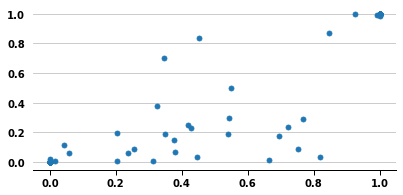

In [301]:
import matplotlib.pyplot as plt
plt.scatter(y, inverse_transform(y_hat))
#plt.scatter(y, y_hat)

In [302]:
best_model = cv_rf.best_estimator_

feature_importance = pd.DataFrame(dict(feature=X.columns, importance=best_model.feature_importances_))
feature_importance.sort_values(by="importance", ascending=False)

,feature,importance
4,is_user_usable_path,0.335484
0,aggregate_flow,0.317139
1,path_impact,0.204531
2,path_length,0.136649
5,is_user_and_fleet_usable,0.005639
3,is_fleet_usable_path,0.000558


<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.
<__array_function__ internals>:5: RuntimeWarning: Converting input from bool to <class 'numpy.uint8'> for compatibility.


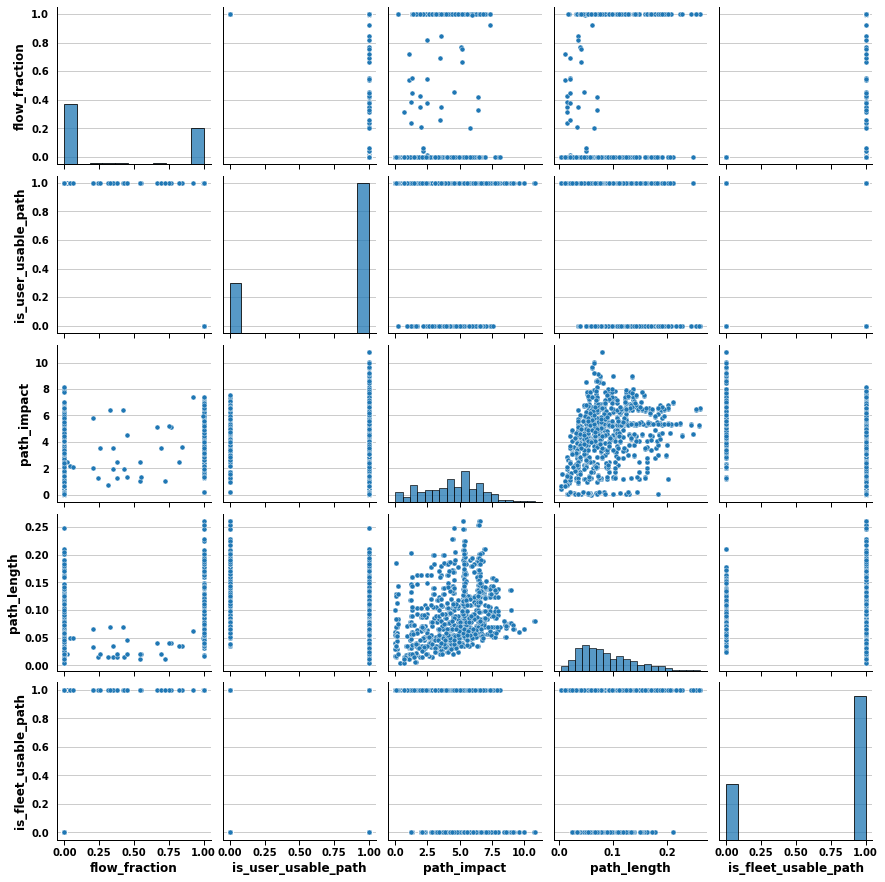

In [305]:
sns.pairplot(data[["flow_fraction", "is_user_usable_path", "path_impact", "path_length", "is_fleet_usable_path"]])


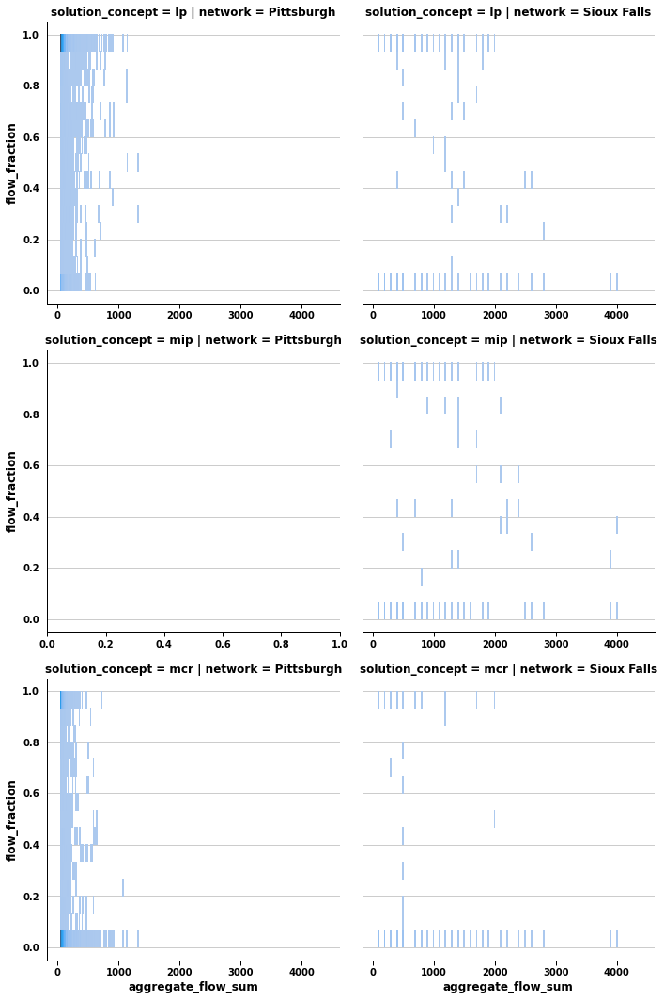

In [269]:
g = sns.displot(
	data=sf_spc_trip_agg.reset_index(),
	col="network", 
	row="solution_concept", 
    row_order=["lp", "mip", "mcr"],
	y="flow_fraction",
	x="aggregate_flow_sum",
	facet_kws=dict(sharex=False),
	kind="hist"
)

In [377]:
sf_spc_paths

link_cost  \
network     path_uuid                            trip_id solution_concept                 
Pittsburgh  0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                 5985.793660   
                                                         mcr                5985.793660   
            000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                63515.699216   
            00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                18771.692273   
                                                         mcr               18771.692273   
...                                                                                 ...   
Sioux Falls ffd0a661-2d95-1242-e58f-be49c7bb7d18 399     mcr                  62.414624   
                                                         mip                  62.414624   
            ffd8cebc-9fc6-57ba-cd2e-647493ad4cc1 179     lp                   39.843987   
                                                         mcr                  39.843987   
                                                         mip                  39.843987   

                                                                           aggregate_flow  \
network     path_uuid                            trip_id solution_concept                   
Pittsburgh  0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                         114.0   
                                                         mcr                        114.0   
            000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                           0.0   
            00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                         174.0   
                                                         mcr                        174.0   
...                                                                                   ...   
Sioux Falls ffd0a661-2d95-1242-e58f-be49c7bb7d18 399     mcr                          0.0   
                                                         mip                          0.0   
            ffd8cebc-9fc6-57ba-cd2e-647493ad4cc1 179     lp                           0.0   
                                                         mcr                          0.0   
                                                         mip                          0.0   

                                                                                                                    geometry  \
network     path_uuid                            trip_id solution_concept                                                      
Pittsburgh  0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp                MULTILINESTRING ((1343159.770 411800.656, 1343...   
                                                         mcr               MULTILINESTRING ((1343159.770 411800.656, 1343...   
            000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp                MULTILINESTRING ((1319795.500 395627.882, 1321...   
            00118c0c-a6fd-2791-d14e-66423c78efb1 2448    lp                MULTILINESTRING ((1380729.775 413210.622, 1379...   
                                                         mcr               MULTILINESTRING ((1380729.775 413210.622, 1379...   
...                                                                                                                      ...   
Sioux Falls ffd0a661-2d95-1242-e58f-be49c7bb7d18 399     mcr               MULTILINESTRING ((-96.774 43.573, -96.770 43.6...   
                                                         mip               MULTILINESTRING ((-96.774 43.573, -96.770 43.6...   
            ffd8cebc-9fc6-57ba-cd2e-647493ad4cc1 179     lp                MULTILINESTRING ((-96.731 43.549, -96.731 43.5...   
                                                         mcr               MULTILINESTRING ((-96.731 43.549, -96.731 43.5...   
                                                         mip               MULTILINESTRING ((-96.731 43.549, -96.731 43.5...   

                   

In [183]:
sf_spc_fleet_trip_flow.groupby(["network", "solution_concept"]).flow.describe()

count        mean         std           min  \
network     solution_concept                                                 
Pittsburgh  lp                4881.0  114.387124  108.673446  0.000000e+00   
            mcr               4881.0   46.291599   69.425998  0.000000e+00   
Sioux Falls lp                 528.0  249.477041  446.596056  1.806938e-08   
            mcr                528.0   96.480557  227.755964  0.000000e+00   
            mip                528.0  225.602619  431.438238  0.000000e+00   

                                       25%           50%         75%  \
network     solution_concept                                           
Pittsburgh  lp                6.000000e+01  8.100000e+01  127.310536   
            mcr               0.000000e+00  0.000000e+00   71.000000   
Sioux Falls lp                1.264440e-07  3.330559e-06  399.995630   
            mcr               0.000000e+00  0.000000e+00   81.623871   
            mip               0.000000e+00  3.635603e-07  300.000000   

                                      max  
network     solution_concept               
Pittsburgh  lp                1136.000000  
            mcr                800.674920  
Sioux Falls lp                2864.145614  
            mcr               1699.990987  
            mip               2717.706540

In [184]:
spc_path_flow.head()

link_cost  \
path_uuid                            trip_id solution_concept flow_class demand_level                 
0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp               fleet      1.0            5985.793660   
                                                              user       1.0            5985.793660   
                                             mcr              fleet      1.0            5985.793660   
                                                              user       1.0            5985.793660   
000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp               fleet      1.0           63515.699216   

                                                                                       trip_id  \
path_uuid                            trip_id solution_concept flow_class demand_level            
0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp               fleet      1.0               248   
                                                              user       1.0               248   
                                             mcr              fleet      1.0               248   
                                                              user       1.0               248   
000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp               fleet      1.0              3859   

                                                                                       aggregate_flow  \
path_uuid                            trip_id solution_concept flow_class demand_level                   
0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp               fleet      1.0                    114.0   
                                                              user       1.0                    114.0   
                                             mcr              fleet      1.0                    114.0   
                                                              user       1.0                    114.0   
000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp               fleet      1.0                      0.0   

                                                                                                                                geometry  \
path_uuid                            trip_id solution_concept flow_class demand_level                                                      
0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp               fleet      1.0           MULTILINESTRING ((1343159.770 411800.656, 1343...   
                                                              user       1.0           MULTILINESTRING ((1343159.770 411800.656, 1343...   
                                             mcr              fleet      1.0           MULTILINESTRING ((1343159.770 411800.656, 1343...   
                                                              user       1.0           MULTILINESTRING ((1343159.770 411800.656, 1343...   
000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp               fleet      1.0           MULTILINESTRING ((1319795.500 395627.882, 1321...   

                                                                                       is_fleet_usable_path  \
path_uuid                            trip_id solution_concept flow_class demand_level                         
0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp               fleet      1.0                           True   
                                                              user       1.0                           True   
                                             mcr              fleet      1.0                           True   
                                                              user       1.0                           True   
000f62c6-42c0-c538-a9c1-126acfeff22b 3859    lp               fleet      1.0                          False   

                                                                                       link_cost_gradient  \
path_uuid                            trip_id solution_concept flow_class dema

In [146]:
sf_spc_fleet_trip_flow = sf_spc_paths.groupby(["network", "solution_concept", "trip_id"])[["flow", "aggregate_flow"]].sum()
sf_spc_fleet_trip_flow["flow_fraction"] = sf_spc_fleet_trip_flow.flow / sf_spc_fleet_trip_flow.aggregate_flow
res = (
sf_spc_fleet_trip_flow.groupby(["network", "solution_concept"])
                      .apply(lambda df: df.flow / df.aggregate_flow.sum())
                      .rename("demand_fraction")
)
res.index = res.index.droplevel([0, 1])
sf_spc_fleet_trip_flow = sf_spc_fleet_trip_flow.join(res)
sf_spc_fleet_trip_flow["fleet_fraction"] = (
    sf_spc_fleet_trip_flow.groupby(["network", "solution_concept"])
                          .flow
                          .transform(lambda f: f / f.sum())
)

In [147]:
sf_spc_fleet_trip_flow["exclusivity"] = 4*sf_spc_fleet_trip_flow.flow_fraction * (sf_spc_fleet_trip_flow.flow_fraction - 1)
sf_spc_fleet_trip_flow.sort_values(by="exclusivity", ascending=True)

flow  aggregate_flow  \
network    solution_concept trip_id                               
Pittsburgh lp               3037      82.563284           165.0   
           mcr              44        32.468269            65.0   
                            140       60.612840           121.0   
           lp               1060      72.754560           146.0   
                            1124      59.225564           118.0   
...                                         ...             ...   
                            4054     122.000000           122.0   
                            4055     121.000000           121.0   
                            4056     342.000000           342.0   
                            4058      58.000000            58.0   
           mcr              791        0.000000            57.0   

                                     flow_fraction  demand_fraction  \
network    solution_concept trip_id                                   
Pittsburgh lp               3037          0.500384         0.000131   
           mcr              44            0.499512         0.000052   
                            140           0.500933         0.000096   
           lp               1060          0.498319         0.000115   
                            1124          0.501912         0.000094   
...                                            ...              ...   
                            4054          1.000000         0.000194   
                            4055          1.000000         0.000192   
                            4056          1.000000         0.000543   
                            4058          1.000000         0.000092   
           mcr              791           0.000000         0.000000   

                                     fleet_fraction  exclusivity  
network    solution_concept trip_id                               
Pittsburgh lp               3037           0.000158    -0.999999  
           mcr              44             0.000168    -0.999999  
                            140            0.000313    -0.999997  
           lp               1060           0.000139    -0.999989  
                            1124           0.000113    -0.999985  
...                                             ...          ...  
                            4054           0.000233     0.000000  
                            4055           0.000231     0.000000  
                            4056           0.000653     0.000000  
                            4058           0.000111     0.000000  
           mcr              791            0.000000    -0.000000  

[11346 rows x 6 columns]

In [148]:
sf_spc_paths = sf_spc_paths.join(sf_spc_fleet_trip_flow.flow_fraction.rename("fleet_trip_fraction"))

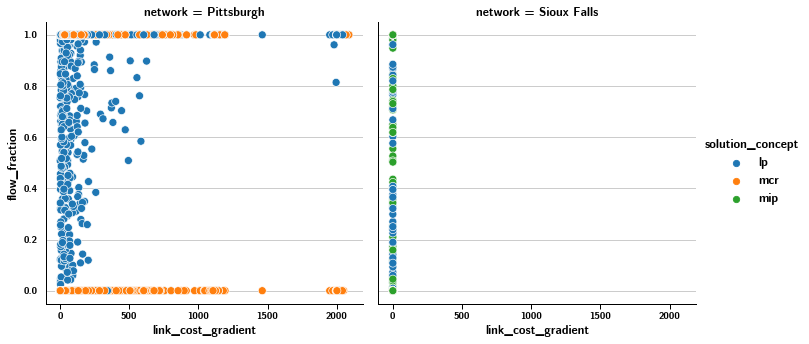

In [149]:
sns.relplot(
	data=sf_spc_paths,
	col="network",
	x="link_cost_gradient",
	y="flow_fraction",
	hue="solution_concept",
)

In [150]:
sf_spc_fleet_trip_flow["trip_rank"] = sf_spc_fleet_trip_flow.groupby(["network", "solution_concept"]).fleet_fraction.rank("first", ascending=False)
sf_spc_fleet_trip_flow["trip_fraction"] = sf_spc_fleet_trip_flow.groupby(["network", "solution_concept"]).trip_rank.transform(lambda r: r /r.max())
sf_spc_fleet_trip_flow.sort_values(by="trip_rank", inplace=True)
sf_spc_fleet_trip_flow["cumulative_fleet"] = sf_spc_fleet_trip_flow.groupby(["network", "solution_concept"]).flow.transform(lambda f: f.cumsum())
sf_spc_fleet_trip_flow["cumulative_fleet_fraction"] = sf_spc_fleet_trip_flow.groupby(["network", "solution_concept"]).cumulative_fleet.transform(lambda f: f / f.max())

In [151]:
SOLUTION_CONCEPT_LABELS = {
    "lp": "CFS (LP)",
    "mip": "CFS (MIP)",
    "mcr": "MCR",
}
_df = sf_spc_fleet_trip_flow.rename(index=SOLUTION_CONCEPT_LABELS, level="solution_concept").rename_axis(index={'solution_concept': "Solution Concept"})
_df.xs(["Pittsburgh", 'CFS (LP)']).sort_values(by="trip_rank")

/home/matt/.virtualenvs/traffic-equilibrium/lib/python3.8/site-packages/IPython/core/interactiveshell.py:2922: PerformanceWarning:

indexing past lexsort depth may impact performance.



,flow,aggregate_flow,flow_fraction,demand_fraction,fleet_fraction,exclusivity,trip_rank,trip_fraction,cumulative_fleet,cumulative_fleet_fraction
trip_id,,,,,,,,,,
844,1257.822300,1316.0,0.955792,0.001995,0.002403,-0.169015,1.0,0.000205,1257.822300,0.002403
3605,1147.647528,1464.0,0.783912,0.001821,0.002193,-0.677575,2.0,0.000410,2405.469829,0.004596
1538,1136.000000,1136.0,1.000000,0.001802,0.002170,0.000000,3.0,0.000615,3541.469829,0.006766
2623,1136.000000,1136.0,1.000000,0.001802,0.002170,0.000000,4.0,0.000820,4677.469829,0.008936
2997,1126.000000,1126.0,1.000000,0.001786,0.002151,0.000000,5.0,0.001024,5803.469829,0.011087
...,...,...,...,...,...,...,...,...,...,...
4859,0.000000,53.0,0.000000,0.000000,0.000000,-0.000000,4877.0,0.999180,523431.626894,1.000000
4860,0.000000,87.0,0.000000,0.000000,0.000000,-0.000000,4878.0,0.999385,523431.626894,1.000000
4861,0.000000,53.0,0.000000,0.000000,0.000000,-0.000000,4879.0,0.999590,523431.626894,1.000000


In [152]:
_df.head()

,,,flow,aggregate_flow,flow_fraction,demand_fraction,fleet_fraction,exclusivity,trip_rank,trip_fraction,cumulative_fleet,cumulative_fleet_fraction
network,Solution Concept,trip_id,,,,,,,,,,
Sioux Falls,MCR,375,1699.990987,1700.0,0.999995,0.004714,0.033371,-0.000021,1.0,0.001894,1699.990987,0.033371
Pittsburgh,CFS (LP),844,1257.822300,1316.0,0.955792,0.001995,0.002403,-0.169015,1.0,0.000205,1257.822300,0.002403
Sioux Falls,CFS (LP),343,2864.145614,4400.0,0.650942,0.007943,0.021744,-0.908866,1.0,0.001894,2864.145614,0.021744
Pittsburgh,MCR,4439,704.000000,704.0,1.000000,0.001117,0.003640,0.000000,1.0,0.000205,704.000000,0.003640
Sioux Falls,CFS (MIP),210,2717.706540,4400.0,0.617661,0.007537,0.022815,-0.944624,1.0,0.001894,2717.706540,0.022815


In [153]:
import matplotlib

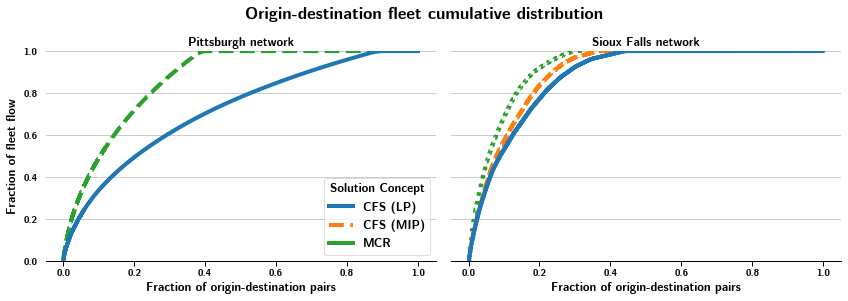

In [155]:
matplotlib.style.use('./figures.mplstyle')
FIG_HEIGHT = 4.0
FIG_WIDTH = 6.0
FIG_ASPECT = FIG_WIDTH / FIG_HEIGHT
g = sns.displot(
    data=_df,
    x="trip_fraction",
    weights="flow",
    hue="Solution Concept",
    col="network",
    kind="ecdf",
    col_order=["Pittsburgh", "Sioux Falls"],
    #stat="count",
    hue_order=SOLUTION_CONCEPT_LABELS.values(),
    complementary=False,
    #legend=False,
    facet_kws=dict(legend_out=False),
    height=FIG_HEIGHT,
    aspect=FIG_ASPECT,
)
g.fig.suptitle("Origin-destination fleet cumulative distribution", y=1.05, fontweight="bold")
g.despine(left=True)

g.set_titles("{col_name} {col_var}")
g.set_xlabels("Fraction of origin-destination pairs")
g.set_ylabels("Fraction of fleet flow")

for ax in g.axes_dict.values():
    handles = [None]*3 if ax.legend_ is None else ax.legend_.legendHandles
    for lines, linestyle, legend_handle in zip(ax.lines[::-1], ['-', '--', ':'], handles):
        lines.set_linestyle(linestyle)
        if legend_handle is not None:
            legend_handle.set_linestyle(linestyle)
#plt.legend(title='Solution Concept', loc='upper right', labels=SOLUTION_CONCEPT_LABELS)
plt.savefig("saved_figures/cumulative-fleet-ods.png", bbox_inches="tight")

In [474]:
g.axes

array([[<AxesSubplot:title={'center':'Sioux Falls network'}, xlabel='Fraction of origin-destination pairs', ylabel='Fraction of fleet flow'>,
        <AxesSubplot:title={'center':'Pittsburgh network'}, xlabel='Fraction of origin-destination pairs'>]],
      dtype=object)

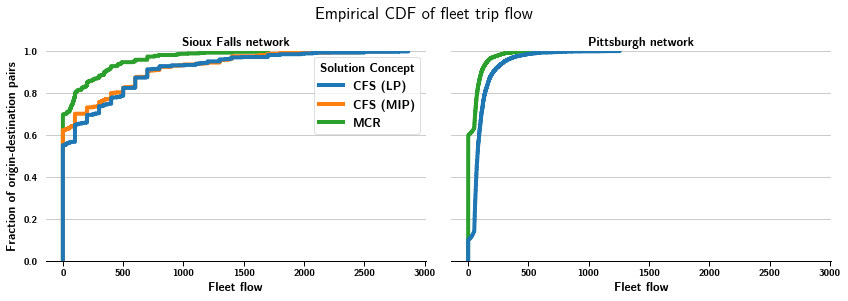

In [156]:
g = sns.displot(
    data=_df,
    x="flow",
    hue="Solution Concept",
    col="network",
    kind="ecdf",
    hue_order=SOLUTION_CONCEPT_LABELS.values(),
    complementary=False,
    facet_kws=dict(legend_out=False),
    height=FIG_HEIGHT,
    aspect=FIG_ASPECT,
)
g.fig.suptitle("Empirical CDF of fleet trip flow", y=1.05)
g.despine(left=True)
g.set_titles("{col_name} {col_var}")
g.set_ylabels("Fraction of origin-destination pairs")
g.set_xlabels("Fleet flow")
#plt.legend(title='Solution Concept', loc='lower right')#, labels=SOLUTION_CONCEPT_LABELS)

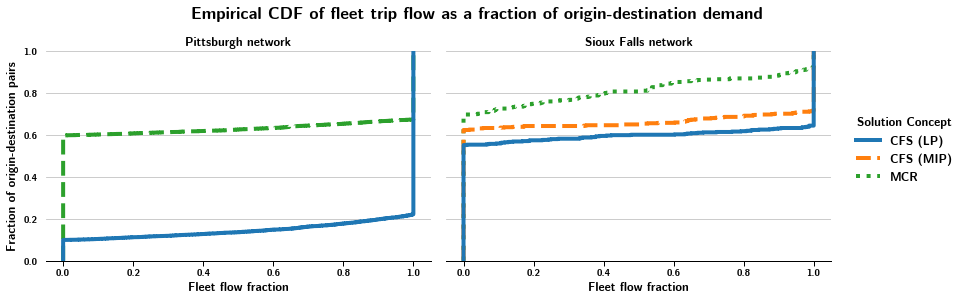

In [158]:
g = sns.displot(
    data=_df,
    x="flow_fraction",
    hue="Solution Concept",
    col="network",
    kind="ecdf",
    col_order=["Pittsburgh", "Sioux Falls"],
    hue_order=SOLUTION_CONCEPT_LABELS.values(),
    complementary=False,
    #facet_kws=dict(legend_out=False),
    height=FIG_HEIGHT,
    aspect=FIG_ASPECT,
)
g.fig.suptitle("Empirical CDF of fleet trip flow as a fraction of origin-destination demand", y=1.05, fontweight="bold")
g.despine(left=True)
#plt.legend(title='Solution Concept', loc='lower right', labels=SOLUTION_CONCEPT_LABELS)
g.set_titles("{col_name} {col_var}")
g.set_ylabels("Fraction of origin-destination pairs")
g.set_xlabels("Fleet flow fraction")

linestyles =  ['-', '--', ':']
for ax in g.axes_dict.values():
    handles = [None]*3 if ax.legend_ is None else ax.legend_.legendHandles
    for lines, linestyle, legend_handle in zip(ax.lines[::-1],linestyles, handles):
        lines.set_linestyle(linestyle)
        if legend_handle is not None:
            legend_handle.set_linestyle(linestyle)
for handle, linestyle in zip(g.legend.legendHandles, linestyles):
    handle.set_linestyle(linestyle)
plt.savefig("saved_figures/path-flow-concentration-ecdf.png", bbox_inches="tight")

In [514]:
g.legend.legendHandles

In [383]:
_df["exclusive trip"] = (0.9 < _df.flow_fraction) | (_df.flow_fraction < 0.1)

In [384]:
_df.groupby(["network", "Solution Concept"])['exclusive trip'].mean()

network      Solution Concept
Pittsburgh   CFS (LP)            0.906167
             MCR                 0.937718
Sioux Falls  CFS (LP)            0.928030
             CFS (MIP)           0.931818
             MCR                 0.842803
Name: exclusive trip, dtype: float64

In [90]:
spc_path_flow["network"] = "Pittsburgh"
_paths = (
    spc_path_flow.xs("fleet", level="flow_class")
                 .xs(1.0, level="demand_level")
                 .set_index("network", append=True)
                 .rename(index=SOLUTION_CONCEPT_LABELS, level="solution_concept")
                 .rename_axis(index={'solution_concept': "Solution Concept"})
                 .reorder_levels(["network", "Solution Concept", "trip_id", "path_uuid"])
                 .join(_df[["exclusive trip"]])
)

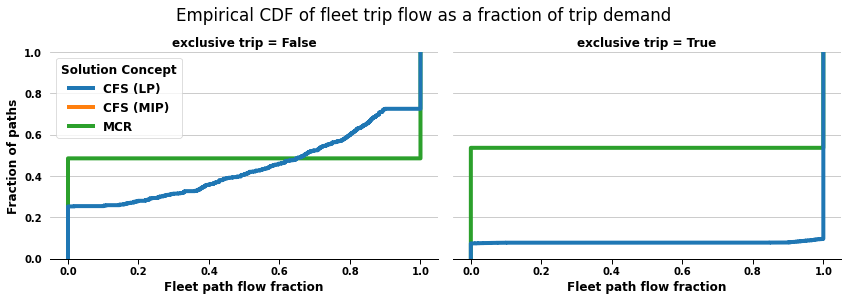

In [91]:
g = sns.displot(
    data=_paths,
    x="flow_fraction",
    hue="Solution Concept",
    col="exclusive trip",
    kind="ecdf",
    hue_order=SOLUTION_CONCEPT_LABELS.values(),
    complementary=False,
    facet_kws=dict(legend_out=False),
    height=FIG_HEIGHT,
    aspect=FIG_ASPECT,
)
g.despine(left=True)
g.fig.suptitle("Empirical CDF of fleet trip flow as a fraction of trip demand", y=1.05)
#g.set_titles("{col_name} {col_var}")
g.set_ylabels("Fraction of paths")
g.set_xlabels("Fleet path flow fraction")

In [92]:
spc_link_flow["gradient_cost_ratio"] = (
    spc_link_flow.link_cost_gradient
    / spc_link_flow.link_cost
)
GRADIENT_COST_THRESHOLD = 0.004
GRADIENT_COST_EPS = 1e-6
def to_ratio_class(ratio):
    if np.isnan(ratio):
        return "NO_COST"
    elif ratio <= 0.0:
        return "NO_GRADIENT"
    elif ratio < GRADIENT_COST_THRESHOLD:
        return "SMALL_RATIO"
    else:
        return "LARGE_RATIO"
spc_link_flow["ratio_class"] = spc_link_flow.gradient_cost_ratio.apply(to_ratio_class)
spc_link_flow["gradient_cost_magnitude"] = (
    spc_link_flow.link_cost_gradient**2 + spc_link_flow.link_cost**2
).apply(np.sqrt)

In [93]:
spc_link_flow.groupby("ratio_class").ratio_class.count()

ratio_class
LARGE_RATIO       72
NO_COST         2408
NO_GRADIENT      696
SMALL_RATIO    18620
Name: ratio_class, dtype: int64

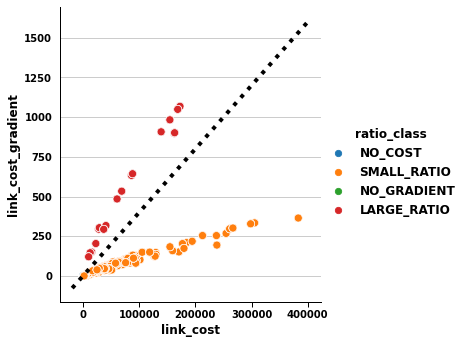

In [94]:
g = sns.relplot(
    data=spc_link_flow,
    x="link_cost",
    y="link_cost_gradient",
    hue="ratio_class",
)
x = np.array(g.ax.get_xlim())
g.ax.plot(x, GRADIENT_COST_THRESHOLD* x, 'k:')

In [95]:
g = sns.relplot(
    data=spc_link_flow_alt,
    y="gradient_cost_ratio",
    x="gradient_cost_magnitude",
    hue="ratio_class",
    hue_order=["NO_COST", "NO_GRADIENT", "SMALL_RATIO", "LARGE_RATIO"],
    height=10
)
x = np.array(g.ax.get_xlim())
g.ax.plot(x, [GRADIENT_COST_THRESHOLD, GRADIENT_COST_THRESHOLD], 'k:')

NameError: name 'spc_link_flow_alt' is not defined

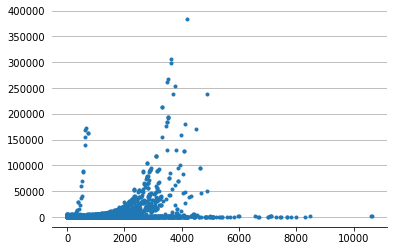

In [18]:
plt.plot(
    res.lp.data["flow"],
    res.lp.data["link_cost"], '.', label="flow")

In [398]:
_flow = spc_link_flow_alt.xs(("lp", "fleet", 1.0), level=("solution_concept", "flow_class", "demand_level")).sort_index().aggregate_flow.values

In [400]:
spc_link_flow_alt.xs(("lp", "fleet", 1.0), level=("solution_concept", "flow_class", "demand_level")).sort_index().aggregate_flow

link_id
0          0.000000
1       2691.000000
2       1373.840229
3          0.000000
4          0.000000
           ...     
5444     324.146667
5445     262.219502
5446     262.219502
5447       0.000000
5448     243.563320
Name: aggregate_flow, Length: 5449, dtype: float64

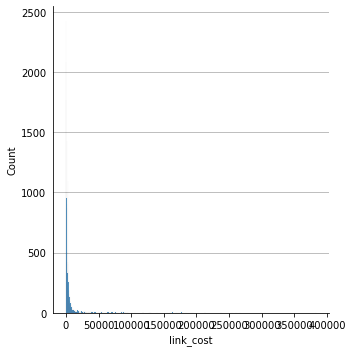

In [426]:
sns.displot(data=spc_link_flow_alt, x="link_cost")

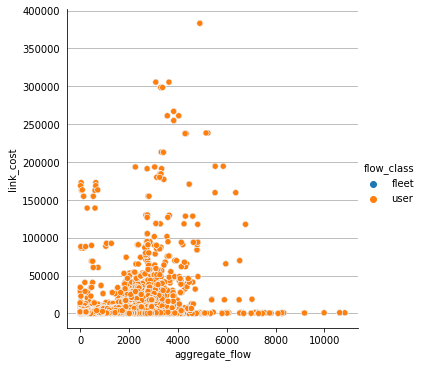

In [417]:
sns.relplot(
    data=spc_link_flow_alt.reset_index(),
    x="aggregate_flow",
    y="link_cost",
    hue="flow_class",
)

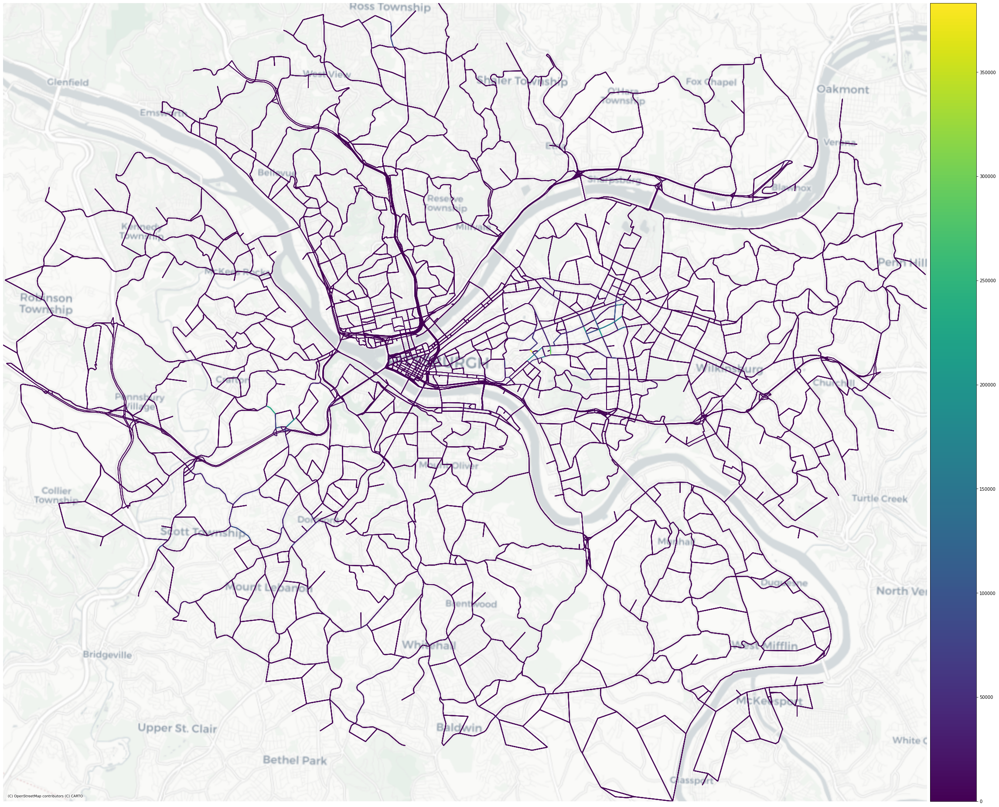

In [420]:

with map_style():
    plot_with_basemap(
        spc_link_flow_alt,
        "link_cost",
        #extent=golden_triangle_extent,
        legend=True,
        #cmap="tab10",
        shift=10,
        size=40,
    )

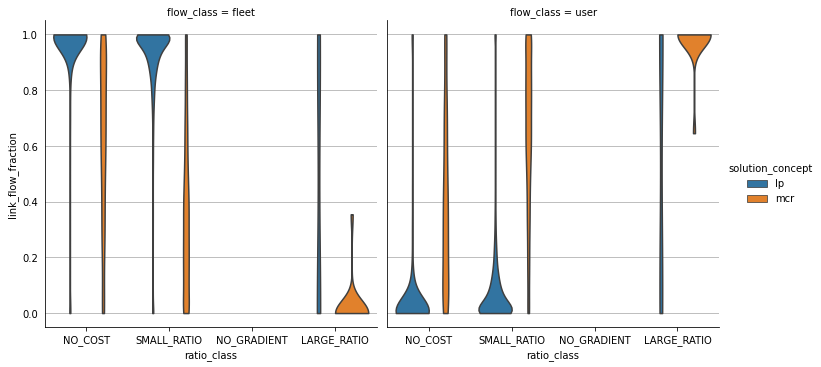

In [423]:
sns.catplot(
    data=spc_link_flow_alt.reset_index(),
    x="ratio_class",
    y="link_flow_fraction",
    col="flow_class",
    hue="solution_concept",
    kind="violin",
    inner=None,
    cut=0
)

In [192]:
res.lp.solver_result.cost
for k, v in res.lp.data.items():
    print(f"{k}: {type(v)}")

result: <class 'str'>
fleet_flow: <class 'numpy.ndarray'>
user_flow: <class 'numpy.ndarray'>
fleet_paths: <class 'numpy.ndarray'>
user_paths: <class 'numpy.ndarray'>
link_path: <class 'scipy.sparse.csc.csc_matrix'>
trip_path: <class 'scipy.sparse.csc.csc_matrix'>
flow: <class 'numpy.ndarray'>
demand: <class 'numpy.ndarray'>
link_cost: <class 'numpy.ndarray'>
link_marginal_cost: <class 'numpy.ndarray'>
link_cost_gradient: <class 'numpy.ndarray'>
trip_cost: <class 'numpy.ndarray'>
trip_marginal_cost: <class 'numpy.ndarray'>


In [5]:
spc_link_flow

lanes  \
link_id solution_concept flow_class demand_level          
0       lp               fleet      0.1               7   
                         user       0.1               7   
        mcr              fleet      0.1               7   
                         user       0.1               7   
1       lp               fleet      0.1               7   
...                                                 ...   
5447    mcr              user       1.0               1   
5448    lp               fleet      1.0               1   
                         user       1.0               1   
        mcr              fleet      1.0               1   
                         user       1.0               1   

                                                                                           to_point  \
link_id solution_concept flow_class demand_level                                                      
0       lp               fleet      0.1           {'latitude': 40.4399189, 'longitude': -80.0058...   
                         user       0.1           {'latitude': 40.4399189, 'longitude': -80.0058...   
        mcr              fleet      0.1           {'latitude': 40.4399189, 'longitude': -80.0058...   
                         user       0.1           {'latitude': 40.4399189, 'longitude': -80.0058...   
1       lp               fleet      0.1           {'latitude': 40.4402919, 'longitude': -80.0045...   
...                                                                                             ...   
5447    mcr              user       1.0           {'longitude': -80.014533, 'latitude': 40.4482434}   
5448    lp               fleet      1.0           {'longitude': -80.0135777, 'latitude': 40.4453...   
                         user       1.0           {'longitude': -80.0135777, 'latitude': 40.4453...   
        mcr              fleet      1.0           {'longitude': -80.0135777, 'latitude': 40.4453...   
                         user       1.0           {'longitude': -80.0135777, 'latitude': 40.4453...   

                                                                                           geometry  \
link_id solution_concept flow_class demand_level                                                      
0       lp               fleet      0.1           LINESTRING (1340786.260 411359.844, 1340668.03...   
                         user       0.1           LINESTRING (1340786.260 411359.844, 1340668.03...   
        mcr              fleet      0.1           LINESTRING (1340786.260 411359.844, 1340668.03...   
                         user       0.1           LINESTRING (1340786.260 411359.844, 1340668.03...   
1       lp               fleet      0.1           LINESTRING (1340786.260 411359.844, 1341030.32...   
...                                                                                             ...   
5447    mcr              user       1.0           LINESTRING (1338472.528 413620.795, 1338324.05...   
5448    lp               fleet      1.0           LINESTRING (1338472.528 413620.795, 1338562.38...   
                         user       1.0           LINESTRING (1338472.528 413620.795, 1338562.38...   
        mcr              fleet      1.0           LINESTRING (1338472.528 413620.795, 1338562.38...   
                         user       1.0           LINESTRING (1338472.528 413620.795, 1338562.38...   

                                                  zone  from_node_id  \
link_id solution_concept flow_class demand_level                       
0       lp               fleet      0.1              1             0   
                         user       0.1              1             0   
        mcr              fleet      0.1              1             0   
                         user       0.1              1             0   
1       lp               fleet      0.1              1             0   
...                                                ...           ...   
5447    mcr              u

In [ ]:
plot_with_basemap(
    spc_link_flow.xs(
        ('mcr', 'fleet', 0.1),
        level=('solution_concept', 'flow_class', 'demand_level'),
        drop_level=False
    ).reset_index(),
    'flow',
    extent=cmu_pgh_extent,
    linewidth=4.0,
    legend=True,
    shift=80,
    size=40,
    legend_kwds=dict(
        shrink=0.5
    ),
    #missing_kwds=dict(color="gray", alpha=0.4, zorder=1),
    cmap="RdYlGn_r",
)

In [ ]:
plot_with_basemap(
    spc_link_flow.xs(
        ('lp', 'fleet', 0.1),
        level=('solution_concept', 'flow_class', 'demand_level'),
        drop_level=False
    ).reset_index(),
    'flow',
    extent=cmu_pgh_extent,
    linewidth=4.0,
    legend=True,
    shift=80,
    size=40,
    legend_kwds=dict(
        shrink=0.5
    ),
    #missing_kwds=dict(color="gray", alpha=0.4, zorder=1),
    cmap="RdYlGn_r",
)

In [ ]:
plot_with_basemap(
    spc_link_flow.xs(
        ('mcr', 'fleet', 0.1),
        level=('solution_concept', 'flow_class', 'demand_level'),
        drop_level=False
    ).reset_index(),
    'link_flow_fraction',
    extent=cmu_pgh_extent,
    linewidth=4.0,
    legend=True,
    shift=80,
    size=40,
    legend_kwds=dict(
        shrink=0.5
    ),
    missing_kwds=dict(color="gray", alpha=0.4, zorder=1),
    cmap="RdYlGn_r",
)

In [ ]:
plot_with_basemap(
    spc_link_flow.xs(
        ('lp', 'fleet', 0.1),
        level=('solution_concept', 'flow_class', 'demand_level'),
        drop_level=False
    ).reset_index(),
    'link_flow_fraction',
    extent=cmu_pgh_extent,
    linewidth=4.0,
    legend=True,
    shift=80,
    size=40,
    legend_kwds=dict(
        shrink=0.5
    ),
    missing_kwds=dict(color="gray", alpha=0.4, zorder=1),
    cmap="RdYlGn_r",
)

In [6]:
nodes = pd.concat([
    spc_link_flow.groupby("from_node_id")
                 [["from_point"]]
                 .first()
                 .rename_axis(index="node_id")
                 .rename(columns={"from_point": "point"}),
    spc_link_flow.groupby("to_node_id")
                 [["to_point"]]
                 .first()
                 .rename_axis(index="node_id")
                 .rename(columns={"to_point": "point"}),
])


In [7]:
nodes = pd.concat([
    spc_link_flow.groupby("from_node_id")
                 [["from_point"]]
                 .first()
                 .rename_axis(index="node_id")
                 .rename(columns={"from_point": "point"}),
    spc_link_flow.groupby("to_node_id")
                 [["to_point"]]
                 .first()
                 .rename_axis(index="node_id")
                 .rename(columns={"to_point": "point"}),
])
nodes["lon"] = nodes.point.apply(lambda d: d['longitude'])
nodes["lat"] = nodes.point.apply(lambda d: d['latitude'])
nodes.drop(columns=['point'], inplace=True)
nodes = gpd.GeoDataFrame(nodes, geometry=gpd.points_from_xy(nodes.lon, nodes.lat)).set_crs(epsg=4326)
nodes.head()

,lon,lat,geometry
node_id,,,
0,-80.005426,40.440546,POINT (-80.00543 40.44055)
1,-80.005830,40.439919,POINT (-80.00583 40.43992)
2,-80.004540,40.440292,POINT (-80.00454 40.44029)
3,-80.003018,40.439200,POINT (-80.00302 40.43920)
4,-80.002979,40.438827,POINT (-80.00298 40.43883)


In [ ]:
fig, ax = plt.subplots(figsize=(20,20))
nodes.plot(ax=ax)
spc_link_flow.to_crs(nodes.crs).plot(ax=ax)
ctx.add_basemap(ax=ax, crs=nodes.crs)

In [8]:
trips = spc_trip_info

In [9]:
trips_geom = (
    trips.reset_index()
         .merge(nodes.geometry, left_on='source_id', right_on="node_id")
         .rename(columns={"geometry": "source_point"})
         .merge(nodes.geometry, left_on='target_id', right_on="node_id")
         .rename(columns={"geometry": "target_point"})
         .set_index("trip_id")
         .sort_index()
)
trips_geom = gpd.GeoDataFrame(
    trips_geom,
    geometry=trips_geom.apply(lambda row: LineString([row.source_point, row.target_point]),
                             axis=1)
).set_crs(epsg=4326)

In [ ]:
trips_geom.head()

In [10]:
trips_geom_full_demand = trips_geom[trips_geom.demand_level == 1.0].copy()
trips_geom_full_demand.head()

,demand_level,source_id,target_id,volume,source_point,target_point,geometry
trip_id,,,,,,,
0,1.0,0,7,55.0,POINT (-80.00543 40.44055),POINT (-80.00158 40.44090),"LINESTRING (-80.00543 40.44055, -80.00158 40.4..."
0,1.0,0,7,55.0,POINT (-80.00543 40.44055),POINT (-80.00158 40.44090),"LINESTRING (-80.00543 40.44055, -80.00158 40.4..."
0,1.0,0,7,55.0,POINT (-80.00543 40.44055),POINT (-80.00158 40.44090),"LINESTRING (-80.00543 40.44055, -80.00158 40.4..."
0,1.0,0,7,55.0,POINT (-80.00543 40.44055),POINT (-80.00158 40.44090),"LINESTRING (-80.00543 40.44055, -80.00158 40.4..."
1,1.0,0,11,97.0,POINT (-80.00543 40.44055),POINT (-80.00588 40.44265),"LINESTRING (-80.00543 40.44055, -80.00588 40.4..."


In [ ]:
ax = trips_geom.plot('volume')
ctx.add_basemap(ax=ax, crs=trips_geom.crs)

# Critical Fleet Size

In [11]:
cfs = spc_path_flow.groupby(["solution_concept", "flow_class", "demand_level"])[["flow", "aggregate_flow"]].sum()
cfs["flow_fraction"] = cfs.flow / cfs.aggregate_flow
cfs

flow  aggregate_flow  \
solution_concept flow_class demand_level                                  
lp               fleet      0.1             9227.637531         63033.9   
                            0.5           251236.872392        315169.5   
                            1.0           547944.961178        630339.0   
                 user       0.1            53806.262469         63033.9   
                            0.5            63932.627608        315169.5   
                            1.0            82394.038822        630339.0   
mcr              fleet      0.1             2495.427535         63033.9   
                            0.5            57828.779531        315169.5   
                            1.0           142449.490253        630339.0   
                 user       0.1            60538.472465         63033.9   
                            0.5           257340.720469        315169.5   
                            1.0           487889.509747        630339.0   

                                          flow_fraction  
solution_concept flow_class demand_level                 
lp               fleet      0.1                0.146392  
                            0.5                0.797148  
                            1.0                0.869286  
                 user       0.1                0.853608  
                            0.5                0.202852  
                            1.0                0.130714  
mcr              fleet      0.1                0.039589  
                            0.5                0.183485  
                            1.0                0.225989  
                 user       0.1                0.960411  
                            0.5                0.816515  
                            1.0                0.774011

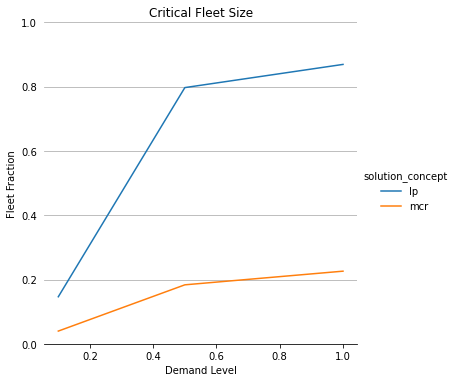

In [12]:
g = sns.relplot(
    data=cfs.xs("fleet", level="flow_class").reset_index(),
    x="demand_level",
    hue="solution_concept",
    y="flow_fraction",
    kind="line"
)
g.set(title="Critical Fleet Size", xlabel="Demand Level", ylabel="Fleet Fraction", ylim=[0, 1])
sns.despine(left=True)

## Link-level statistics

In [170]:
spc_path_flow["is_active"] = ~spc_path_flow.flow_fraction.isna()

In [172]:
_link_path_lookup = spc_trip_path_link_idx.reset_index().groupby("link_id").agg(frozenset)
_exclusive_path_uuids = (
    spc_path_flow.reset_index("path_uuid")
                 .groupby(["solution_concept", "demand_level", "flow_class", "is_exclusive"])
                 [["path_uuid"]]
                 .agg(frozenset)
)
_active_path_uuids = (
    spc_path_flow.reset_index("path_uuid")
                 .groupby(["solution_concept", "demand_level", "flow_class", "is_active"])
                 [["path_uuid"]]
                 .agg(frozenset)
)

In [174]:
_active_path_uuids.reset_index().pivot(
    index=["solution_concept", "demand_level", "flow_class"],
    columns=["is_active"],
    values=["path_uuid"]
)

path_uuid  \
is_active                                                                             False   
solution_concept demand_level flow_class                                                      
lp               0.1          fleet       (9a8d14e3-e473-ec45-40e5-8d7759a7d05a, ca1e65b...   
                              user        (9a8d14e3-e473-ec45-40e5-8d7759a7d05a, ca1e65b...   
                 0.5          fleet       (15c23d75-c9e0-d3f2-2e08-2dcad7925084, 0d27312...   
                              user        (15c23d75-c9e0-d3f2-2e08-2dcad7925084, 0d27312...   
                 1.0          fleet       (15c23d75-c9e0-d3f2-2e08-2dcad7925084, 0d27312...   
                              user        (15c23d75-c9e0-d3f2-2e08-2dcad7925084, 0d27312...   
mcr              0.1          fleet       (9a8d14e3-e473-ec45-40e5-8d7759a7d05a, ca1e65b...   
                              user        (9a8d14e3-e473-ec45-40e5-8d7759a7d05a, ca1e65b...   
                 0.5          fleet       (0d273128-88b8-c00d-5cae-c1cf48a96800, 1073925...   
                              user        (0d273128-88b8-c00d-5cae-c1cf48a96800, 1073925...   
                 1.0          fleet       (15c23d75-c9e0-d3f2-2e08-2dcad7925084, 0d27312...   
                              user        (15c23d75-c9e0-d3f2-2e08-2dcad7925084, 0d27312...   

                                                                                             
is_active                                                                             True   
solution_concept demand_level flow_class                                                     
lp               0.1          fleet       (15c23d75-c9e0-d3f2-2e08-2dcad7925084, 2dd797e...  
                              user        (15c23d75-c9e0-d3f2-2e08-2dcad7925084, 2dd797e...  
                 0.5          fleet       (488dd8f0-a6ad-df21-e86e-866c9fbe7c84, 1073925...  
                              user        (488dd8f0-a6ad-df21-e86e-866c9fbe7c84, 1073925...  
                 1.0          fleet       (7b761d38-b6f3-ac41-02f8-8b30e9f6f5d3, b1f4618...  
                              user        (7b761d38-b6f3-ac41-02f8-8b30e9f6f5d3, b1f4618...  
mcr              0.1          fleet       (15c23d75-c9e0-d3f2-2e08-2dcad7925084, 2dd797e...  
                              user        (15c23d75-c9e0-d3f2-2e08-2dcad7925084, 2dd797e...  
                 0.5          fleet       (488dd8f0-a6ad-df21-e86e-866c9fbe7c84, 15c23d7...  
                              user        (488dd8f0-a6ad-df21-e86e-866c9fbe7c84, 15c23d7...  
                 1.0          fleet       (ce9fb0c2-6042-5f57-7042-a18e5f89201c, b1f4618...  
                              user        (ce9fb0c2-6042-5f57-7042-a18e5f89201c, b1f4618...

In [178]:
path_annotated_link_flow = spc_link_flow.join(_link_path_lookup)
path_annotated_link_flow = path_annotated_link_flow.reorder_levels(["solution_concept", "demand_level", "flow_class", "link_id"]).sort_index()
_dfs = []
for loc, _df in path_annotated_link_flow.groupby(["solution_concept", "demand_level", "flow_class"]):
    exclusive_path_uuids = _exclusive_path_uuids.loc[loc].loc[True].path_uuid
    active_path_uuids = _active_path_uuids.loc[loc].loc[True].path_uuid
    _dfs.append(
        _df.path_uuid
           .apply(lambda p: len(p & exclusive_path_uuids) if isinstance(p, frozenset) else 0)
           .rename("n_exclusive_paths")
           .to_frame()
           .join(
               _df.path_uuid
                  .apply(lambda p: len(p & active_path_uuids) if isinstance(p, frozenset) else 0)
                  .rename("n_paths")
           )
        )
path_annotated_link_flow = path_annotated_link_flow.join(pd.concat(_dfs))

In [179]:
path_annotated_link_flow["fraction_exclusive_paths"] = path_annotated_link_flow.n_exclusive_paths / path_annotated_link_flow.n_paths
path_annotated_link_flow.head()

lanes  \
solution_concept demand_level flow_class link_id          
lp               0.1          fleet      0            7   
                                         1            7   
                                         2            7   
                                         3            7   
                                         4            2   

                                                                                           to_point  \
solution_concept demand_level flow_class link_id                                                      
lp               0.1          fleet      0        {'latitude': 40.4399189, 'longitude': -80.0058...   
                                         1        {'latitude': 40.4402919, 'longitude': -80.0045...   
                                         2        {'latitude': 40.4411492, 'longitude': -80.0057...   
                                         3        {'latitude': 40.4405462, 'longitude': -80.0054...   
                                         4        {'latitude': 40.4403729, 'longitude': -80.0070...   

                                                                                           geometry  \
solution_concept demand_level flow_class link_id                                                      
lp               0.1          fleet      0        LINESTRING (1340786.260 411359.844, 1340668.03...   
                                         1        LINESTRING (1340786.260 411359.844, 1341030.32...   
                                         2        LINESTRING (1340786.260 411359.844, 1340693.29...   
                                         3        LINESTRING (1340668.031 411134.271, 1340786.26...   
                                         4        LINESTRING (1340668.031 411134.271, 1340341.55...   

                                                  zone  from_node_id  \
solution_concept demand_level flow_class link_id                       
lp               0.1          fleet      0           1             0   
                                         1           1             0   
                                         2           1             0   
                                         3           1             1   
                                         4           1             1   

                                                  capacity  \
solution_concept demand_level flow_class link_id             
lp               0.1          fleet      0          9999.0   
                                         1          9999.0   
                                         2          9999.0   
                                         3          9999.0   
                                         4           700.0   

                                                                                         from_point  \
solution_concept demand_level flow_class link_id                                                      
lp               0.1          fleet      0        {'latitude': 40.4405462, 'longitude': -80.0054...   
                                         1        {'latitude': 40.4405462, 'longitude': -80.0054...   
                                         2        {'latitude': 40.4405462, 'longitude': -80.0054...   
                                         3        {'latitude': 40.4399189, 'longitude': -80.0058...   
                                         4        {'latitude': 40.4399189, 'longitude': -80.0058...   

                                                  aggregate_flow  length  \
solution_concept demand_level flow_class link_id                           
lp               0.1          fleet      0              0.000000    0.00   
                                         1            390.200000    0.01   
                                         2            309.889849    0.00   
                                         3              0.000000    0.00   
                                         4              0.000000    0.01  

/home/matt/.virtualenvs/traffic-equilibrium/lib/python3.8/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


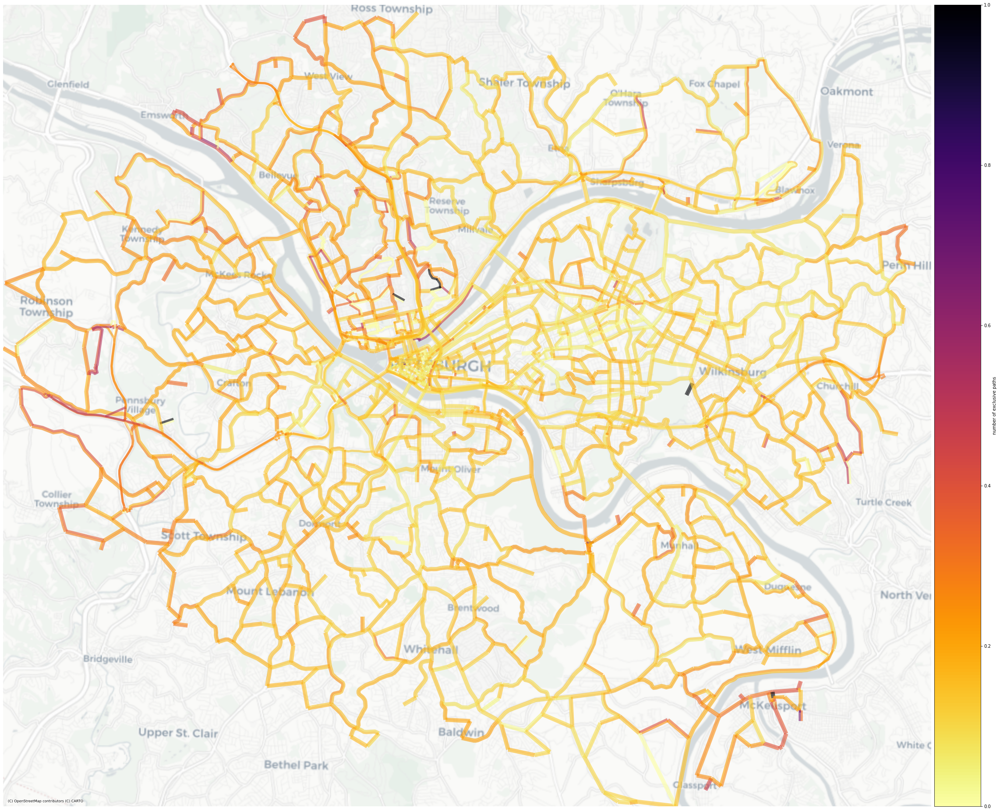

In [158]:
with map_style():
    plot_with_basemap(
        path_annotated_link_flow.xs(("lp", 1.0, "fleet")),
        "fraction_exclusive_paths",
        #extent=cmu_pgh_extent,
        linewidth=5,
        legend=True,
        shift=100,
        size=40,
        legend_kwds=dict(
            label="number of exclusive paths",
        ),
        #k=5,
        cmap="inferno_r",
        alpha=0.6,
    )

/home/matt/.virtualenvs/traffic-equilibrium/lib/python3.8/site-packages/geopandas/geodataframe.py:853: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super(GeoDataFrame, self).__setitem__(key, value)


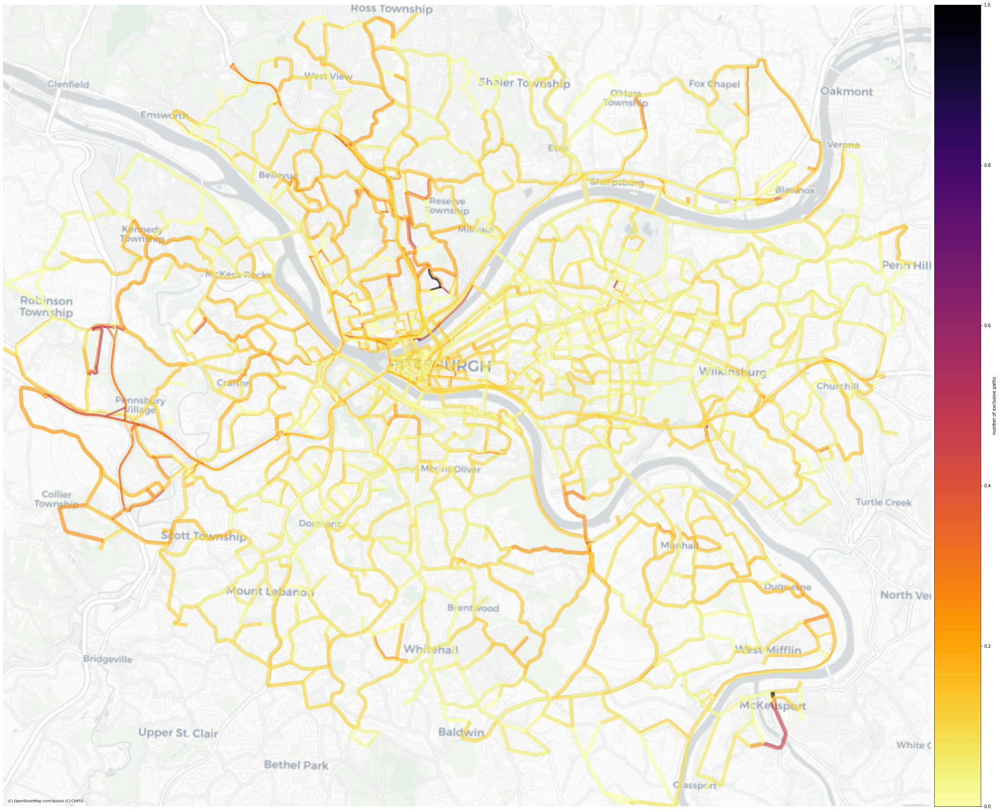

In [157]:
with map_style():
    plot_with_basemap(
        path_annotated_link_flow.xs(("mcr", 1.0, "fleet")),
        "fraction_exclusive_paths",
        #extent=cmu_pgh_extent,
        linewidth=5,
        legend=True,
        shift=100,
        size=40,
        legend_kwds=dict(
            label="number of exclusive paths",
        ),
        cmap="inferno_r",
        alpha=0.6,
    )

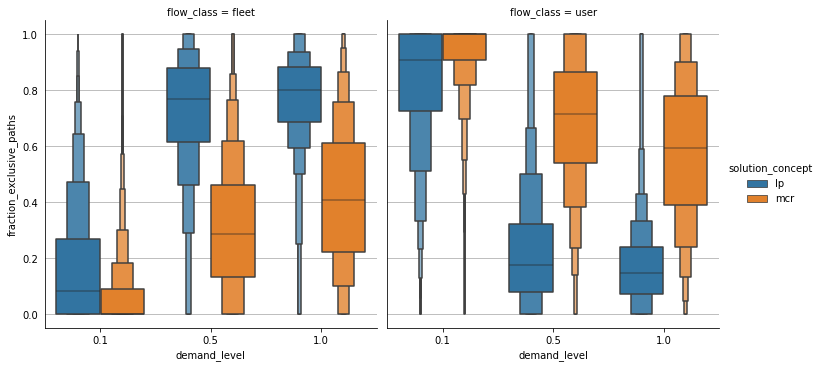

In [180]:
sns.catplot(
    data=path_annotated_link_flow.reset_index(),
    y="fraction_exclusive_paths",
    col="flow_class",
    x="demand_level",
    hue="solution_concept",
    kind="boxen",
    #stat="probability",
    #bins=25,
)

Fraction of intersecting paths that are fleet and user exclusive. In CFS, links tend to have a higher share of fleet-exlusive paths than MCR.

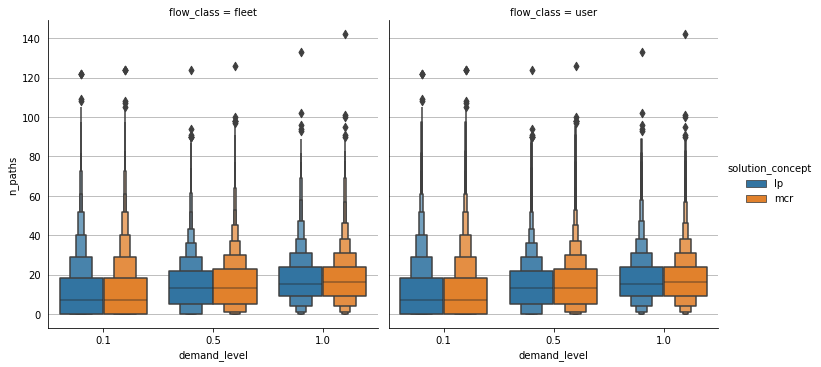

In [181]:
sns.catplot(
    data=path_annotated_link_flow.reset_index(),
    y="n_paths",
    col="flow_class",
    x="demand_level",
    hue="solution_concept",
    kind="boxen",
    #stat="probability",
    #bins=25,
)

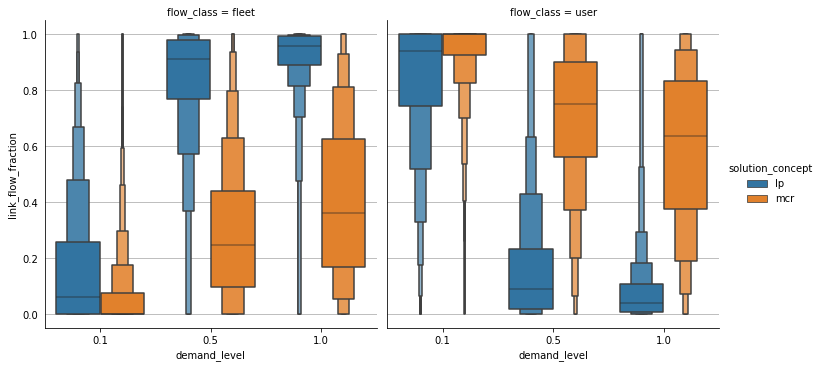

In [182]:
sns.catplot(
    data=path_annotated_link_flow.reset_index(),
    y="link_flow_fraction",
    col="flow_class",
    x="demand_level",
    hue="solution_concept",
    kind="boxen",
    #stat="probability",
    #bins=25,
)

Fraction of link flow 

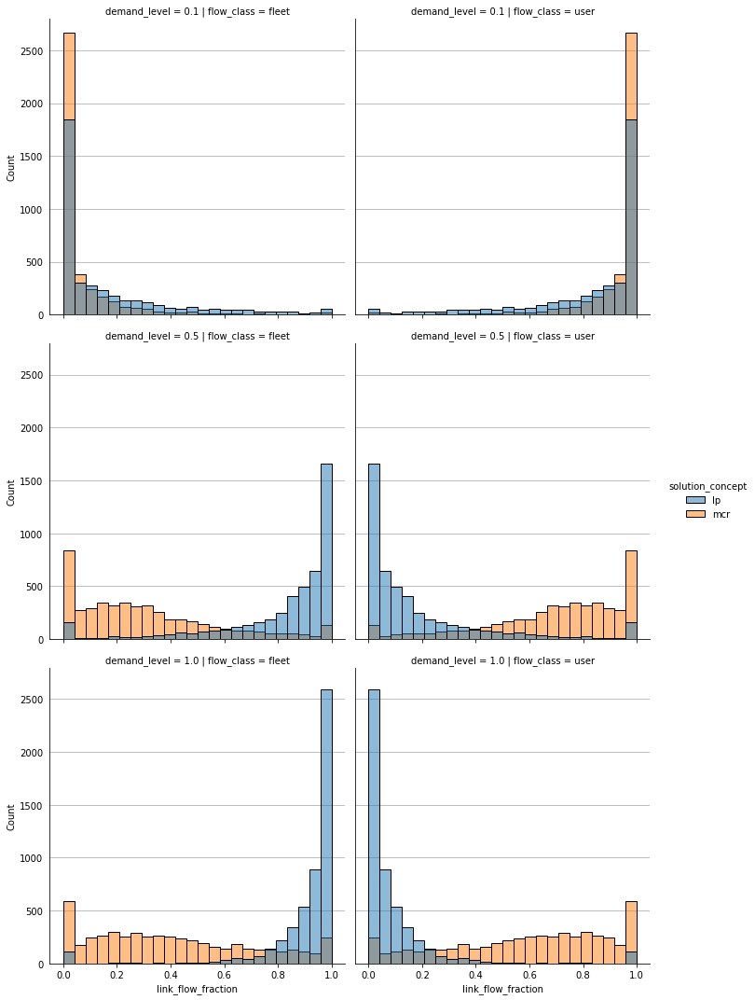

In [94]:
sns.displot(
    data=spc_link_flow.reset_index(),
    x="link_flow_fraction",
    col="flow_class",
    row="demand_level",
    hue="solution_concept",
)

## Path level statistics

In [15]:
spc_path_flow["rowid"] = np.arange(len(spc_path_flow))
spc_path_flow.set_index("rowid", append=True, inplace=True)
spc_path_flow.head()

aggregate_flow  \
path_uuid                            trip_id solution_concept flow_class demand_level rowid                   
0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp               fleet      0.1          0                11.4   
                                                              user       0.1          1                11.4   
                                             mcr              fleet      0.1          2                11.4   
                                                              user       0.1          3                11.4   
000e9dc1-e59a-79ce-5606-1d30fe6de6cd 2126    lp               fleet      0.1          4                 0.0   

                                                                                                                                      geometry  \
path_uuid                            trip_id solution_concept flow_class demand_level rowid                                                      
0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp               fleet      0.1          0      MULTILINESTRING ((1343159.770 411800.656, 1343...   
                                                              user       0.1          1      MULTILINESTRING ((1343159.770 411800.656, 1343...   
                                             mcr              fleet      0.1          2      MULTILINESTRING ((1343159.770 411800.656, 1343...   
                                                              user       0.1          3      MULTILINESTRING ((1343159.770 411800.656, 1343...   
000e9dc1-e59a-79ce-5606-1d30fe6de6cd 2126    lp               fleet      0.1          4      MULTILINESTRING ((1341859.773 411460.649, 1341...   

                                                                                             flow  \
path_uuid                            trip_id solution_concept flow_class demand_level rowid         
0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp               fleet      0.1          0       0.0   
                                                              user       0.1          1      11.4   
                                             mcr              fleet      0.1          2       0.0   
                                                              user       0.1          3      11.4   
000e9dc1-e59a-79ce-5606-1d30fe6de6cd 2126    lp               fleet      0.1          4       0.0   

                                                                                             is_used  \
path_uuid                            trip_id solution_concept flow_class demand_level rowid            
0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp               fleet      0.1          0        False   
                                                              user       0.1          1         True   
                                             mcr              fleet      0.1          2        False   
                                                              user       0.1          3         True   
000e9dc1-e59a-79ce-5606-1d30fe6de6cd 2126    lp               fleet      0.1          4        False   

                                                                                             flow_fraction  \
path_uuid                            trip_id solution_concept flow_class demand_level rowid                  
0001ca8e-ccb1-00a0-57e6-2bcdf5f22701 248     lp               fleet      0.1          0                0.0   
                                                              user       0.1          1                1.0   
                                             mcr              fleet      0.1          2                0.0   
                                                              user       0.1          3                1.0   
000e9dc1-e59a-79ce-5606-1d30fe6de6cd 2126    lp               fleet      0.1          4                NaN   

                                                                                    

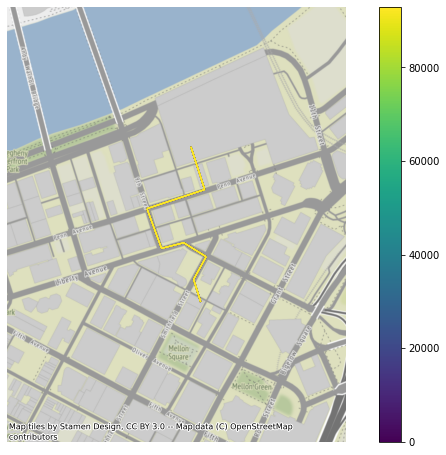

In [16]:
with matplotlib.style.context("./maps.mplstyle"):
    df = spc_path_flow.xs("0001ca8e-ccb1-00a0-57e6-2bcdf5f22701", level="path_uuid").reset_index()
    xmin, ymin, xmax, ymax = df.buffer(1000).total_bounds
    ax = df.plot("rowid", legend=True)
    ax.set(ylim=[ymin, ymax], xlim=[xmin, xmax])
    ctx.add_basemap(ax=ax, crs=spc_path_flow.crs)

In [17]:
spc_path_flow["concentration"] = (2*spc_path_flow.flow_fraction - 1.0)**2

In [ ]:
spc_path_flow.groupby(["solution_concept", "flow_class", "solution_concept", "demand_level"]).concentration.agg(lambda col: (col.dropna() >= 1.0).mean())

In [ ]:
spc_path_flow.head()

In [ ]:
g = sns.catplot(
    data=spc_path_flow.reset_index(),
    x="demand_level",
    y="concentration",
    hue="solution_concept",
    col="flow_class",
    kind="violin",
    cut=0,
)
sns.despine(left=True)

In [ ]:
g = sns.catplot(
    data=spc_path_flow.dropna().reset_index(),
    x="demand_level",
    y="is_exclusive",
    hue="solution_concept",
    col="flow_class",
    kind="point",
    ci=None,
)
sns.despine(left=True)
g.set_xlabels("Demand Level")
g.set_ylabels("Fraction of exclusive paths")
g.set_titles(col_template="{col_name}")
g.set(ylim=[0, 1])

Fraction of paths used exclusively by the fleet and users. 

In [ ]:
spc_path_flow.groupby(["solution_concept", "demand_level"]).flow.sum()

In [ ]:
path_flow_fractions = flatten_columns(
    spc_path_flow.dropna().reset_index()
                 .pivot(
                     index=["trip_id", "path_uuid", "demand_level", "flow_class"],
                     columns="solution_concept",
                     values=["flow", "flow_fraction", "is_exclusive"],
                 ).reset_index()
)
for col in ["flow_fraction_lp", "flow_fraction_mcr", "flow_lp", "flow_mcr"]:
    path_flow_fractions[col] = path_flow_fractions[col].astype(np.float)
    
def to_yes_no(value):
    if value is True:
        return "yes"
    elif value is False:
        return "no"
    else:
        return "unused"

path_flow_fractions["is_exclusive_lp"] = path_flow_fractions.is_exclusive_lp.apply(to_yes_no)
path_flow_fractions["is_exclusive_mcr"] = path_flow_fractions.is_exclusive_mcr.apply(to_yes_no)

path_flow_fractions.head()

In [ ]:
path_flow_fractions.flow_lp.fillna(0.0, inplace=True)
path_flow_fractions.flow_mcr.fillna(0.0, inplace=True)
path_flow_fractions.flow_lp.fillna(0.0, inplace=True)
path_flow_fractions.flow_mcr.fillna(0.0, inplace=True)

### Are the same paths used?

In [ ]:
path_flow_fractions["is_used_mcr"] = path_flow_fractions.flow_mcr > 0.0
path_flow_fractions["is_used_lp"] = path_flow_fractions.flow_lp > 0.0
path_flow_fractions.groupby(["flow_class", "demand_level", "is_used_mcr"]).is_used_lp.describe()

In [ ]:
sns.catplot(
    data=path_flow_fractions,
    x="demand_level",
    y="is_used_lp",
    hue="is_used_mcr",
    col="flow_class",
    kind="point",
    ci=None,
)

Fraction of paths used in the CFS LP by demand level, flow class and whether the path was used in MCR. Orange denotes paths that were used in the MCR solution. Paths that were used by the fleet in MCR tend to also be used by the fleet in CFS, although at higher demand levels, the fleet uses a nearly equal proportion of paths it didn't use under MCR.

### MCR Fleet Exclusive Paths

Are also CFS Fleet exclusive paths. These paths account for ~20% of the CFS fleet exclusive paths

In [ ]:
_df = path_flow_fractions.groupby(
    ["flow_class", "is_exclusive_mcr", "demand_level"],
).flow_lp.agg(["count", "sum"])
_df = (
    _df.join(_df.groupby("demand_level")["sum"].sum(), rsuffix="_total")
       .join(_df.groupby(["flow_class", "demand_level"])["count"].sum(), rsuffix="_total")
)
_df["fraction_paths"] = _df["count"] / _df["count_total"]
_df["fraction_flow"] = _df["sum"] / _df["sum_total"]
_df 

In [ ]:
sns.catplot(
    data=_df.reset_index(),
    x="demand_level",
    y="fraction_flow",
    hue="is_exclusive_mcr",
    hue_order=["no", "yes", "unused"],
    col="flow_class",
    kind="point",
)

Almost ~20% of fleet flow comes from fleet exclusive MCR paths, most of the increased flow comes from user exclusive MCR paths; the final 20% comes from paths that are unused by the MCR.

In [ ]:
sns.catplot(
    data=_df.reset_index(),
    x="demand_level",
    y="fraction_paths",
    hue="is_exclusive_mcr",
    hue_order=["no", "yes", "unused"],
    col="flow_class",
    kind="point",
)

Most fleet-exclusive paths in CFS come from MCR user exclusive paths.

In [ ]:
g = sns.catplot(
    data=path_flow_fractions,
    y="flow_fraction_lp",
    x="demand_level",
    hue="is_exclusive_mcr",
    hue_order=["no", "yes", "unused"],
    col="flow_class",
    kind="point",
)

Fleet exclusive paths in MCR remain fleet exclusive in CFS. ~70% of unused and user-exclusive paths from MCR are fleet exclusive in CFS/

## Trip level statistics

In [ ]:
spc_trip_flow = with_path_stats(
    spc_path_flow[['aggregate_flow', 'flow']].groupby(
        by=['trip_id', 'solution_concept', 'flow_class', 'demand_level'],
    ).sum().join(
        spc_path_flow.groupby(
            by=['trip_id', 'solution_concept', 'flow_class', 'demand_level'])[["flow_fraction"]]
        .count()
        .rename(columns={"flow_fraction": "n_paths"})
    )
)
spc_trip_flow["concentration"] = (2*spc_trip_flow.flow_fraction - 1)**2
spc_trip_flow = trips_geom.set_index("demand_level", append=True).join(spc_trip_flow).set_crs(trips_geom.crs)

In [ ]:
spc_trip_flow.head()

In [ ]:
trips_geom

In [ ]:
spc_trip_compare = flatten_columns(
    spc_trip_flow.reset_index()
                   .pivot(
                       index=["flow_class", "demand_level", "trip_id"],
                       columns=["solution_concept"],
                       values=["flow", "aggregate_flow", "flow_fraction", "n_paths"]
                   )
)
spc_trip_compare["flow_fraction_difference"] = (
    spc_trip_compare.flow_fraction_lp - spc_trip_compare.flow_fraction_mcr
)
spc_trip_compare["lost_flow_fraction"] = spc_trip_compare.flow_fraction_difference < 0.0
spc_trip_compare["n_paths_difference"] = (
    spc_trip_compare.n_paths_lp - spc_trip_compare.n_paths_mcr
)
spc_trip_compare["lost_n_paths"] = spc_trip_compare.n_paths_difference < 0.0
# spc_trip_compare = gpd.GeoDataFrame(spc_origin_compare.join(nodes.rename_axis("source_id")[["geometry"]]))
spc_trip_compare = trips_geom.set_index("demand_level", append=True).join(spc_trip_compare).set_crs(trips_geom.crs)
spc_trip_compare.head()

In [ ]:
(spc_trip_compare.groupby(["flow_class", "demand_level", "lost_n_paths", "lost_flow_fraction"])
                 [["flow_fraction_difference"]]
                 .count()
                 .rename(columns={"flow_fraction_difference": "n_trips"})
                 .reset_index()
                 .pivot(index=["flow_class", "demand_level", "lost_n_paths"], columns=["lost_flow_fraction"])
)

In [ ]:
with matplotlib.style.context({"axes.grid": False}):
    g = sns.jointplot(
        data=spc_trip_compare.xs("fleet", level="flow_class").reset_index(),
        x="flow_fraction_mcr",
        y="flow_fraction_lp",
        hue="demand_level",
        palette="tab10",
        kind="kde",
        cut=0,
        marginal_kws=dict(cut=0),
        legend=False,
    )
    g.ax_joint.plot([0, 1], [0, 1], linestyle=":", color="k")

In [ ]:
g = sns.catplot(
    data=spc_trip_flow.reset_index(),
    x="demand_level",
    y="concentration",
    col="flow_class",
    hue="solution_concept",
    palette="tab10",
    kind="boxen",
)

In [ ]:
spc_trip_compare["concentration_difference"] = (2*abs(spc_trip_compare.flow_fraction_difference) - 1)**2
g = sns.displot(
    data=spc_trip_compare.reset_index(),
    #x="demand_level",
    x="concentration_difference",
    col="flow_class",
    hue="demand_level",
    palette="tab10",
    #kind="boxen",
    kind="kde",
    cut=0,
)

In [ ]:
def classify_flow_fraction_change(value):
    eps = 1e-6
    if value < -1.0 + eps:
        return "lost_all"
    elif value < 0.0 - eps:
        return "lost_some"
    elif value < 0.0 + eps:
        return "no_change"
    elif value < 1.0 - eps:
        return "gained_some"
    elif 1.0 - eps <= value:
        return "gained_all"
    else:
        return None

spc_trip_compare["flow_change"] = spc_trip_compare.flow_fraction_difference.apply(classify_flow_fraction_change)

In [ ]:
spc_trips = spc_trip_info.xs(1.0, level="demand_level").reset_index().drop(columns=["volume"])
trip_reverse_relation = (
    spc_trips.merge(
        spc_trips,
        left_on=["source_id", "target_id"], 
        right_on=["target_id", "source_id"], 
        suffixes=("","_reverse")
    ).set_index("trip_id")
    [["trip_id_reverse"]]
)
trip_origin_relation = (
    spc_trips.set_index("source_id").sort_index().drop(columns="target_id")
)
trip_dest_relation = (
    spc_trips.set_index("target_id").sort_index().drop(columns="source_id")
)

In [ ]:
spc_trip_compare["is_exclusive_mcr"] = (spc_trip_compare.flow_fraction_mcr == 1.0).astype(np.float)
spc_trip_compare["is_exclusive_lp"] = (spc_trip_compare.flow_fraction_lp == 1.0).astype(np.float)
spc_trip_compare.head()

In [ ]:
spc_trip_compare.groupby(["demand_level", "flow_class", "flow_change"])[["is_exclusive_mcr"]].mean()

In [ ]:
spc_trip_compare.head()

In [ ]:
with matplotlib.style.context("./maps.mplstyle"):
    _df = spc_trip_compare.xs(("user", 1.0), level=("flow_class", "demand_level"))#.set_geometry("source_point")
    xmin, ymin, xmax, ymax = _df.total_bounds
    buffer = 0.01
    row = "flow_change"
    height = 100
    aspect = 1
    rows = _df[row].unique()
    nrows = len(rows)
    figure, axes = plt.subplots(nrows=nrows, figsize=(height*aspect*nrows, height*aspect))
    for i, val in enumerate(rows):
        ax = axes[i]
        _df[_df[row] == val].set_geometry("source_point").plot(color="green", marker=">", alpha=0.5, linewidth=0, ax=ax)
        _df[_df[row] == val].set_geometry("target_point").plot(color="red", marker="H", alpha=0.5, linewidth=0, ax=ax)
        _df[_df[row] == val].plot(row, ax=ax, alpha=0.4, linestyle=":")
        ax.set(title=f"{row}={val}", xlim=[xmin-buffer, xmax+buffer], ylim=[ymin-buffer, ymax+buffer])
        ctx.add_basemap(ax=ax, crs=spc_origin_flow.crs, source=ctx.providers.CartoDB.Positron)

In [ ]:
spc_trip_compare.columns

In [ ]:
cols = ['flow_lp', 'flow_mcr', 'aggregate_flow_lp',
       'aggregate_flow_mcr', 'flow_fraction_lp', 'flow_fraction_mcr',
       'n_paths_lp', 'n_paths_mcr', 'flow_fraction_difference',
       'lost_flow_fraction', 'n_paths_difference', 'lost_n_paths',
       'concentration_difference', 'flow_change', 'is_exclusive_mcr',
       'is_exclusive_lp']
_df = spc_trip_compare.join(trip_reverse_relation).reset_index().merge(
    spc_trip_compare[cols].reset_index(),
    left_on=["trip_id_reverse", "demand_level", "flow_class"],
    right_on=["trip_id", "demand_level", "flow_class"],
    suffixes=("", "_r")
).set_index(["demand_level", "flow_class", "trip_id"])

In [ ]:
pd.get_dummies(_df.set_index("flow_change", append=True).flow_change_r).groupby(["flow_class", "demand_level", "flow_change"]).mean()

In [ ]:
sns.relplot(
    data = _df.reset_index(),
    x="flow_fraction_lp",
    y="flow_fraction_lp_r",
    col="flow_class",
    row="demand_level"
)

In [ ]:
sns.displot(
    data=spc_trip_compare.xs(1.0, level="demand_level").reset_index(),
    x="flow_fraction_mcr",
    row="flow_change",
    hue="flow_change",
    col="flow_class",
    #multiple="stack",
    bins=[0, 0.05, 0.95, 1.0],
    stat="probability",
)

In [ ]:
spc_trip_compare.groupby(["flow_class", "demand_level", "flow_change"]).flow_fraction_mcr.describe()

### Origin-based statistics

In [ ]:
spc_trip_flow.head()

In [ ]:
nodes.rename_axis("source_id")

In [ ]:
spc_origin_flow = (
    spc_trip_flow.groupby(["solution_concept", "flow_class", "demand_level", "source_id"])
        [["flow", "aggregate_flow", "n_paths"]]
    .sum()
)
spc_origin_flow["flow_fraction"] = spc_origin_flow.flow / spc_origin_flow.aggregate_flow
spc_origin_flow = gpd.GeoDataFrame(spc_origin_flow.join(nodes.rename_axis("source_id")[["geometry"]]))
spc_origin_flow.head()

In [ ]:
g = sns.catplot(
    data=spc_origin_flow.reset_index(),
    x="demand_level",
    y="flow_fraction",
    hue="solution_concept",
    col="flow_class",
    kind="boxen"
)

In [ ]:
spc_origin_compare = flatten_columns(
    spc_origin_flow.reset_index()
                   .pivot(
                       index=["flow_class", "demand_level", "source_id"],
                       columns=["solution_concept"],
                       values=["flow", "aggregate_flow", "flow_fraction", "n_paths"]
                   )
)
spc_origin_compare["flow_fraction_difference"] = (
    spc_origin_compare.flow_fraction_lp - spc_origin_compare.flow_fraction_mcr
)
spc_origin_compare["lost_flow_fraction"] = spc_origin_compare.flow_fraction_difference < 0.0
spc_origin_compare["n_paths_difference"] = (
    spc_origin_compare.n_paths_lp - spc_origin_compare.n_paths_mcr
)
spc_origin_compare = gpd.GeoDataFrame(spc_origin_compare.join(nodes.rename_axis("source_id")[["geometry"]]))
spc_origin_compare.head()

In [ ]:
spc_origin_compare.groupby(["flow_class", "demand_level", "lost_flow_fraction"]).n_paths_difference.describe()

In [ ]:
spc_origin_compare.groupby(["flow_class", "demand_level"]).flow_fraction_difference.agg(lambda x: (x< 0).mean())

In [ ]:
with matplotlib.style.context({"axes.grid": False}):
    g = sns.jointplot(
        data=spc_origin_compare.xs("fleet").reset_index(),
        x="flow_fraction_mcr",
        y="flow_fraction_lp",
        hue="demand_level",
        palette="tab10",
        kind="kde",
        cut=0,
        marginal_kws=dict(cut=0),
        legend=False,
    )
    g.ax_joint.plot([0, 1], [0, 1], linestyle=":", color="k")

In [ ]:
g = sns.displot(
    data=spc_origin_compare.reset_index(),
    x="flow_fraction_difference",
    col="flow_class",
    hue="demand_level",
    palette="tab10",
)

In [ ]:
g = sns.displot(
    data=spc_origin_compare.reset_index(),
    x="n_paths_difference",
    col="flow_class",
    hue="demand_level",
    palette="tab10",
    kind="kde",
    cut=0,
)

In [ ]:
g = sns.relplot(
    data=spc_origin_compare.reset_index(),
    y="flow_fraction_difference",
    x="n_paths_difference",
    col="flow_class",
    hue="demand_level",
    palette="tab10",
    #kind="hist"
)

In [ ]:
sns.catplot(
    data=spc_origin_compare.reset_index(),
    x="demand_level",
    y="n_paths_difference",
    hue="lost_flow_fraction",
    col="flow_class",
    kind="boxen",
)

In [ ]:
with matplotlib.style.context("./maps.mplstyle"):
    ax = spc_origin_compare.xs(("fleet", 1.0)).plot("flow_fraction_difference",
                                                    legend=True,
                                                    figsize=(30,30),
                                                    #legend_kwds=dict(shrink=0.5),
                                                    scheme="EqualInterval",
                                                    k=2,
                                                    cmap="inferno",
                                                    edgecolor="gray",
                                                   )
    ctx.add_basemap(ax=ax, crs=spc_origin_flow.crs, source=ctx.providers.CartoDB.Positron)

In [ ]:
flow_fractions = (spc_trip_flow.reset_index()
                               .pivot(
                                   index=["trip_id", "demand_level", "flow_class"],
                                   columns="solution_concept",
                                   values=["flow_fraction", "n_paths"],)
                               .reset_index()
                 )
flow_fractions["close"] = abs(flow_fractions.flow_fraction.mcr - flow_fractions.flow_fraction.lp) < 0.025

flow_fractions.columns = ['_'.join(filter(None,col)) for col in flow_fractions.columns.values]

In [ ]:
flow_fractions.head()

In [ ]:
sns.displot(
    data=spc_trip_flow.xs("fleet", level="flow_class").reset_index(),
    x="flow_fraction",
    hue="demand_level",
    row="solution_concept",
    kind="kde",
    clip=[0, 1],
    cut=0,
)

In [ ]:
g = sns.lmplot(data=spc_trip_flow.xs("fleet", level="flow_class").reset_index(),
            x="aggregate_flow", y="flow_fraction", row="demand_level", col="solution_concept", markers="+")

In [ ]:
res

In [ ]:
from scipy import stats

for (row, col, hue), df in g.facet_data():
    res = stats.linregress(df["aggregate_flow"], df["flow"])
    print(f"demand level={g.row_names[row]}; sol={g.col_names[col]}: slope={res.slope:0.3f}, R^2={res.rvalue:0.4f}, p: {res.pvalue if res.pvalue > 0.001 else '<0.001'}")

In [ ]:
top_trips = spc_trip_flow.sort_values("flow", ascending=False).groupby(["flow_class", "demand_level", "solution_concept"]).head(100)

In [ ]:
g = sns.FacetGrid(
    data=top_trips.xs("fleet", level="flow_class").reset_index(),
    row="demand_level",
    col="solution_concept",
    height=6,
    aspect=1.5,
    sharex=False,
    sharey=False
)
for (row_i, col_i, hue_i), gdf in g.facet_data():
    ax = g.facet_axis(row_i, col_i)
    gdf.plot("flow_fraction", ax=ax, cmap="inferno", vmin=0, vmax=1)
    ctx.add_basemap(ax=ax, crs=gdf.crs)
    ax.set(xticks=[], yticks=[])
    ax.set_frame_on(False)

In [ ]:
orgn_based_trips = gpd.GeoDataFrame(
       spc_trip_flow.xs("fleet", level="flow_class")
                    .reset_index()
                    .groupby(["demand_level", "solution_concept", "source_id"])
                    .agg({"normalized_volume": "sum", "aggregate_flow": "sum", "flow": "sum"})
                    .reset_index()
                    .merge(trips_geom[["source_id", "source_point"]], on="source_id")
      ).set_geometry("source_point")
orgn_based_trips["flow_fraction"] = orgn_based_trips["flow"] / orgn_based_trips["aggregate_flow"]
orgn_based_trips["markersize"] = orgn_based_trips["normalized_volume"] / 10

In [ ]:
orgn_based_trips = gpd.sjoin(orgn_based_trips, pgh_neighborhoods.to_crs(dest_based_trips.crs))
orgn_hood_based = orgn_based_trips.groupby(["demand_level", "solution_concept", "hood"])[["flow", "aggregate_flow"]].sum()
orgn_hood_based["flow_fraction"] = orgn_hood_based.flow / orgn_hood_based.aggregate_flow
orgn_hood_based = gpd.GeoDataFrame(orgn_hood_based.reset_index().merge(pgh_neighborhoods, on="hood")).set_geometry("geometry").set_crs(pgh_neighborhoods.crs)

In [ ]:
cols = ["hood", "flow_fraction"]
hood_compare = pd.merge(orgn_hood_based[cols], dest_hood_based[cols], on="hood", how="outer", suffixes=("_o", "_d"))

In [ ]:
sns.jointplot(data=hood_compare, x="flow_fraction_o", y="flow_fraction_d", kind="hist")

In [ ]:
g = sns.FacetGrid(
    data=orgn_hood_based,
    row="demand_level",
    col="solution_concept",
    height=10,
    aspect=1.5,
)
for (row_i, col_i, hue_i), gdf in g.facet_data():
    ax = g.facet_axis(row_i, col_i)
    gdf.plot("flow_fraction", cmap="inferno",
             ax=ax, vmin=0, vmax=1, legend=True)
    ctx.add_basemap(ax=ax, crs=gdf.crs)
    ax.set(xticks=[], yticks=[])
    ax.set_frame_on(False)

In [ ]:
sns.lmplot(data=orgn_based_trips, x="normalized_volume", y="flow", row="demand_level", col="solution_concept", markers="x")

In [ ]:
dest_based_trips = gpd.GeoDataFrame(
       spc_trip_flow.xs("fleet", level="flow_class")
                    .reset_index()
                    .groupby(["demand_level", "solution_concept", "target_id"])
                    .agg({"normalized_volume": "sum", "aggregate_flow": "sum", "flow": "sum"})
                    .reset_index()
                    .merge(trips_geom[["target_id", "target_point"]], on="target_id")
      ).set_geometry("target_point")
dest_based_trips["flow_fraction"] = dest_based_trips["flow"] / dest_based_trips["aggregate_flow"]
dest_based_trips["markersize"] = dest_based_trips["normalized_volume"] / 20

In [ ]:
dest_based_trips = gpd.sjoin(dest_based_trips, pgh_neighborhoods.to_crs(dest_based_trips.crs))

In [ ]:
dest_hood_based = dest_based_trips.groupby(["demand_level", "solution_concept", "hood"])[["flow", "aggregate_flow"]].sum()
dest_hood_based["flow_fraction"] = dest_hood_based.flow / dest_hood_based.aggregate_flow
dest_hood_based = gpd.GeoDataFrame(dest_hood_based.reset_index().merge(pgh_neighborhoods, on="hood")).set_geometry("geometry").set_crs(pgh_neighborhoods.crs)

In [ ]:
g = sns.FacetGrid(
    data=dest_hood_based,
    row="demand_level",
    col="solution_concept",
    height=10,
    aspect=1.5,
)
for (row_i, col_i, hue_i), gdf in g.facet_data():
    ax = g.facet_axis(row_i, col_i)
    gdf.plot("flow_fraction", cmap="inferno",
             ax=ax, vmin=0, vmax=1, legend=True)
    ctx.add_basemap(ax=ax, crs=gdf.crs)
    ax.set(xticks=[], yticks=[])
    ax.set_frame_on(False)

In [ ]:
sns.lmplot(data=dest_based_trips, x="normalized_volume", y="flow", row="demand_level", col="solution_concept", markers='x')

In [ ]:
g = sns.FacetGrid(
    data=orgn_based_trips,
    row="demand_level",
    col="solution_concept",
    height=10,
    aspect=1.5,
)
for (row_i, col_i, hue_i), gdf in g.facet_data():
    ax = g.facet_axis(row_i, col_i)
    gdf.plot("flow_fraction", cmap="inferno",
             markersize=5,
             ax=ax, vmin=0, vmax=1)
    ctx.add_basemap(ax=ax, crs=gdf.crs)
    ax.set(xticks=[], yticks=[])
    ax.set_frame_on(False)

In [ ]:
g = sns.FacetGrid(
    data=dest_based_trips,
    row="demand_level",
    col="solution_concept",
    height=10,
    aspect=1.5,
)
for (row_i, col_i, hue_i), gdf in g.facet_data():
    ax = g.facet_axis(row_i, col_i)
    gdf.plot("flow_fraction", cmap="inferno",
             markersize=5,
             ax=ax, vmin=0, vmax=1)
    ctx.add_basemap(ax=ax, crs=gdf.crs)
    ax.set(xticks=[], yticks=[])
    ax.set_frame_on(False)

In [ ]:
sns.displot(
    data=spc_trip_flow.xs("fleet", level="flow_class").reset_index(),
    x="flow_fraction",
    col="solution_concept",
    row="demand_level",
    kind="hist"
)

In [ ]:
from sklearn import linear_model
model = linear_model.LinearRegression()
data = spc_trip_flow.xs(("fleet", 1.0, "lp"), level=("flow_class", "demand_level", "solution_concept")).reset_index()
X = data[["normalized_volume", "trip_distance", "distance_to_pittsburgh"]]
y = data.flow_fraction
model.fit(X, y).score(X, y)

In [ ]:
sns.relplot(
    data=spc_trip_flow.xs("fleet", level="flow_class").reset_index(),
    size="normalized_volume",
    x="trip_distance",
    hue="distance_to_pittsburgh",
    y="flow_fraction",
    col="solution_concept",
    row="demand_level"
)

In [ ]:
spc_trip_flow['exclusive'] = spc_trip_flow.flow_fraction == 1

In [ ]:
spc_trip_flow["trip_distance"] = spc_trip_flow.to_crs(epsg=26917).length

In [ ]:
sns.catplot(
    data=spc_trip_flow.reset_index(),
    y="exclusive",
    x="demand_level",
    kind="point",
    row="solution_concept",
    col="flow_class",
)

In [ ]:
POINT_STATE_PARK = (40.441726613507356, -80.00770989900444)
def distance_to_pittsburgh(row):
    o = row.source_point.y, row.source_point.x
    d = row.target_point.y, row.target_point.x
    return min(geo_distance.geodesic(o, POINT_STATE_PARK).meters, geo_distance.geodesic(d, POINT_STATE_PARK).meters)
spc_trip_flow['distance_to_pittsburgh'] = spc_trip_flow.apply(distance_to_pittsburgh, axis=1)

In [ ]:
pgh_neighborhoods = gpd.read_file("neighborhoods-shapefile/Neighborhoods_.shp")[["hood", "geometry"]]

In [ ]:
sns.displot(data=spc_trip_flow.xs("fleet", level="flow_class").reset_index(),
          x="distance_to_pittsburgh",
          y="flow_fraction",
          row="demand_level",
         col="solution_concept"
        )

In [ ]:
spc_trip_flow.groupby(['solution_concept', 'flow_class', 'demand_level']).exclusive.mean()

In [ ]:
spc_trip_flow["normalized_volume"] = spc_trip_flow.volume / spc_trip_flow.index.get_level_values("demand_level")

In [ ]:
sns.displot(
    data=spc_trip_flow.xs("fleet", level="flow_class").reset_index(),
    x="normalized_volume",
    y="flow_fraction",
    col="solution_concept",
    hue="demand_level",
    kind="kde"
)

In [ ]:
sns.displot(
    data=spc_trip_flow.reset_index(),
    x="flow_fraction",
    hue="demand_level",
    row="solution_concept",
    col="flow_class",
    kind="kde",
)

In [ ]:
g = sns.catplot(
    data=spc_trip_flow.reset_index(),
    y="distance_to_pittsburgh",
    hue="exclusive",
    x="flow_class",
    col="solution_concept",
    row="demand_level",
    kind="box",
    legend_out=True,
)
g.set(yscale="log")

In [ ]:
g = sns.catplot(
    data=spc_trip_flow.reset_index(),
    y="trip_distance",
    hue="exclusive",
    x="flow_class",
    col="solution_concept",
    row="demand_level",
    kind="box",
    legend_out=True,
)
g.set(yscale="log")
#plt.tight_layout()

In [ ]:
g = sns.catplot(
    data=spc_trip_flow.reset_index(),
    y="volume",
    hue="exclusive",
    x="flow_class",
    col="solution_concept",
    row="demand_level",
    kind="box",
    legend_out=True,
)
g.set(yscale="log")
#plt.tight_layout()

In [ ]:
sns.relplot(
    data=spc_trip_flow.reset_index(),
    x="demand_level",
    y="flow_fraction",
    col="flow_class",
    kind="line",
    hue="solution_concept",
    err_style="bars",
    ci=90,
)

In [ ]:
def quantile_bins(series, n):
    return [series.quantile((i+1)/n) for i in range(n)] 

In [ ]:
# TODO: by mcr vs lp
factor_map_plot(
    spc_trip_flow.set_index("exclusive", append=True).xs(("mcr", 0.1), level=("solution_concept", "demand_level")),
    "volume",
    row="exclusive",
    col="flow_class",
    scheme="user_defined",
    classification_kwds={'bins': quantile_bins(spc_trip_flow.volume, 6)  }
)

In [ ]:
spc_path_flow['exclusive'] = spc_path_flow.flow_fraction == 1

In [ ]:
spc_path_flow.groupby(['solution_concept', 'flow_class', 'demand_level']).exclusive.mean()

In [ ]:
spc_link_flow['exclusive'] = spc_link_flow.link_flow_fraction == 1

In [ ]:
spc_link_flow.groupby(['solution_concept', 'flow_class', 'demand_level']).exclusive.mean()

In [ ]:
spc_path_flow = spc_path_flow.join(spc_trip_flow.exclusive, rsuffix='_trip', how='left')

In [ ]:
spc_path_flow.groupby(['flow_class', 'exclusive_trip']).flow_fraction.describe()

In [ ]:
spc_path_flow.head()

In [ ]:
def factor_map_plot(gdf, column, row, col,
                    size=10, cmap='RdYlGn_r', linewidth=1.0,
                    extent=None,
                    vmin=None, vmax=None,
                    legend=True,
                    log_scale=False,
                    shrink=None,
                    shift=0,
                    **kwargs
                   ):
    row_labels = gdf.index.get_level_values(row).unique()
    col_labels = gdf.index.get_level_values(col).unique()
    n_rows = len(row_labels)
    n_cols = len(col_labels)
    print(f"Creating a figure with {n_rows}x{n_cols} subplots")
    fig, axs = plt.subplots(n_rows, n_cols,
                            sharex=True, sharey=True, squeeze=False,
                            figsize=(size*n_cols, size*n_rows),
                            subplot_kw=dict(
                                aspect="equal"
                            )
                           )
    if extent is not None:
        gdf = gdf[gdf.intersects(extent)]
    plot_kwargs = dict(
        legend=legend,
        cmap=cmap,
        linewidth=linewidth,
    )
    plot_kwargs.update(**kwargs)
    if log_scale:
        if vmin is None:
            vmin = gdf[column].min()
        if vmax is None:
            vmax = gdf[column].max()
        plot_kwargs.update(norm=matplotlib.colors.LogNorm(vmin=vmin, vmax=vmax))
    else:
        if "scheme" not in plot_kwargs:
            plot_kwargs.update(vmin=vmin, vmax=vmax)
    for (i, row_label), (j, col_label) in it.product(enumerate(row_labels), enumerate(col_labels)):
        print(i, j, row_label, col_label)
        _gdf = gdf.xs(
            (row_label, col_label),
            level=(row, col),
            drop_level=False
        )
        ax = axs[i, j]
        ax.title.set_text(f"{row}={row_label} | {col}={col_label}")
        shift_geometry(_gdf, shift).plot(
            column,
            ax=ax,
            **plot_kwargs
        )
        ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron, crs=_gdf.crs.to_string())
        ax.axis('off')
    plt.tight_layout()
    return fig, axs

In [ ]:
spc_path_flow[spc_path_flow.exclusive_trip].groupby(['flow_class', 'demand_level']).flow.describe()

In [ ]:
used_exclusively = spc_path_flow[spc_path_flow.exclusive_trip & (used_exclusively.flow > 0)].copy()
factor_map_plot(
    used_exclusively,
    'flow',
    col='flow_class',
    row='demand_level',
    extent=pittsburgh_extent,
    legend=True,
    size=40,
    shrink=0.25,
    shift=100,
    scheme="quantiles",
    missing_kwds=dict()
)

In [ ]:
g = sns.displot(
    data=spc_trip_flow.reset_index(),
    x="flow_fraction",
    col="demand_level",
    row="flow_class"
)

In [ ]:
_df = spc_trip_flow.reset_index().pivot(
        index=['trip_id', 'flow_class', 'demand_level'],
        columns='solution_concept',
        values=['is_used', 'flow_fraction']
    ).reset_index()
_df.columns = _df.columns.to_flat_index().map(lambda name: "_".join(filter(None, name)))

In [ ]:
_df['flow_fraction_diff_lp_mcr'] = _df.flow_fraction_lp - _df.flow_fraction_mcr

In [ ]:
g = sns.displot(
    data=_df,
    x='flow_fraction_diff_lp_mcr',
    row="flow_class",
    col="demand_level",
)

In [ ]:
sns.relplot(data=spc_link_flow,
                x="Aggregate V/C",
                y="link_flow_fraction",
                col="flow_class",
                row="demand_level",
                hue="solution_concept"
               )

In [ ]:
g = sns.jointplot(
        data=spc_link_flow.xs(
            ('fleet'),
            level=('flow_class'),
            drop_level=False
        ).reset_index(),
            x="Aggregate V/C",
            y="link_flow_fraction",
            hue="solution_concept",
            height=12,
            kind='kde'
           )
#g.plot_joint(sns.kdeplot, zorder=0, levels=4)

In [ ]:
_df = spc_path_flow.reset_index().pivot(
        index=['trip_id', 'path_id', 'flow_class', 'demand_level'],
        columns='solution_concept',
        values=['is_used', 'flow_fraction']
    ).reset_index()
_df.columns = _df.columns.to_flat_index().map(lambda name: "_".join(filter(None, name)))

In [ ]:
sns.catplot(
    data=_df,
    x="is_used_mcr",
    y="is_used_lp",
    col="flow_class",
    row="demand_level",
    kind="bar"
)

In [ ]:

g = sns.displot(
    data=_df,
    x='flow_fraction_mcr',
    y='flow_fraction_lp',
    row="flow_class",
    col="demand_level"
)

In [ ]:


g = sns.jointplot(
    select(spc_path_flow, demand_level=0.1, flow_class='fleet').reset_index(),
    x="flow",
    y="flow",
    

In [ ]:
factor_map_plot(spc_link_flow.xs('user', level='flow_class', drop_level=False),
                'flow',
                'demand_level', 'solution_concept', 
                size=20, extent=pittsburgh_extent,
                cmap="plasma")